-------

- hypothesis around the work
#### _H0: Neighborhood clustering does not reveal significant differences in average Urban Heat Exposure Index across Paris neighborhoods._
#### _H1: Neighborhood clustering reveals distinct groups with significantly different average Urban Heat Exposure Index values, allowing identification of hotter and cooler neighborhoods._


------

- link to weather_data.csv : https://drive.google.com/drive/folders/1nmSjigS-GVTZ47OLcW0Zb3-XfTUOM5R_?usp=sharing
- link to data_final.csv : https://drive.google.com/drive/folders/1nmSjigS-GVTZ47OLcW0Zb3-XfTUOM5R_?usp=sharing
- link to tableau_installation_publique.csv : https://drive.google.com/drive/folders/1nmSjigS-GVTZ47OLcW0Zb3-XfTUOM5R_?usp=sharing

à télécharger et à mettre dans le dossier "Data" à la racine du projet

--------

##### Menu
- 1 _["Project overview"](#0-project-overview)_
- 2 _["Import and depedencies"](#1--imports-and-dependencies)_
- 3 _["Data loading"](#2-data-loading)_
- 4 _["EDA - Restructuration"](#3-eda---restructuration)_
- 5 _["EDA - Group by Neighborhood"](#4---group-data-set-by-neightborhood)_
- 6 _["EDA - Combining Datasets"](#5---combine-all-datasets)_
- 7 _["EDA - Some Kpis"](#6---eda---building-some-kpis)_
- 8 _["EDA - Visualisations"](#7-eda---visualisations)_

----------

# 0. Project Overview

- Objective: Identify urban heat patterns using clustering techniques.
- Area: Paris, France.
- Period: 2021–2024.
- Output: Classification of city areas into cool, hot, and intermediate zones during summer.

------------

# 1- Imports and Dependencies

In [170]:
%pip install folium

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [171]:
# libraries needed in this project

# for manipulating data
import numpy as np
import pandas as pd
import math
import re


# for visualization
import matplotlib.pyplot as plt
import seaborn as sns

# geo data reading
import geopandas as gpd
from shapely import geometry

#  for stats
from scipy import stats

# for date
import datetime as dt

# map visualization
import folium
from folium.plugins import MarkerCluster

#  call urls 
import requests

# Other utilities
from IPython.display import display, HTML

------------

# 2. Data Loading

## 2.0 define some fucntions helping the extraction

In [172]:
# check if the call succeed, if the url is correct
def call_status_code_func(base_api_url:str, dataset_name:str)->int:
    url_call_test = f"{base_api_url}/{dataset_name}/records"
    result = requests.get(url_call_test)
    return result.status_code

# count the numbers of rows, the dataset contains
def total_count_func(base_api_url:str, dataset_name:str)->int:
    url_call_test = f"{base_api_url}/{dataset_name}/records"
    result =  requests.get(url_call_test).json().get("total_count")
    return result

# return a list of data
def get_data_func(base_api_url:str, dataset_name:str, column_to_select:list, limit:int=100, offset:int=0)->list|None:
    result = None
    # prepare url format
    column_string_format= ",".join(column_to_select)

    # test the call first
    status_code = call_status_code_func(base_api_url, dataset_name)
    if status_code == 200:
        total_count = total_count_func(base_api_url, dataset_name)
        result = []
        while offset < total_count:
            # build complete url
            final_url= f"{base_api_url}/{dataset_name}/records?select={column_string_format}&limit={limit}&offset={offset}"
            data_results = requests.get(final_url).json().get("results")
            if not data_results:
                break
            result.extend(data_results)
            offset += limit

        print("data extraction succeeded")
        return result
    
    else : 
        print("test call failed, pls check url")
        return result

    
# create a summary func
datasets_summary = {
    "dataset_name": [],
    "dataframe_name":[],
    "n_rows": [],
    "n_columns": [],
    "columns": [],
    "n_missing_values": []
}
def dataset_summary_func(summary_dict:dict, name:str, df_name:str, df:pd.DataFrame)->pd.DataFrame:
    summary_dict["dataset_name"].append(name)
    summary_dict["dataframe_name"].append(df_name)
    summary_dict["n_rows"].append(df.shape[0])
    summary_dict["n_columns"].append(df.shape[1])
    summary_dict["columns"].append(list(df.columns))
    summary_dict["n_missing_values"].append(df.isna().sum().sum())



## 2.1 Neighborhood from paris
- Get all administrative divided quarters in Paris
- Number of 80 Quarters
- Name with GeoPoint

In [173]:
# assign the url destination
base_api_url = "https://opendata.paris.fr/api/explore/v2.1/catalog/datasets"
dataset_name= "quartier_paris"
column_to_select= ["n_sq_qu","c_qu","c_quinsee","l_qu","c_ar", "n_sq_ar" , "surface", "geom_x_y", "geom"]

In [174]:
result = get_data_func(base_api_url,dataset_name, column_to_select)
total_rows = total_count_func(base_api_url, dataset_name)
if len(result) == total_rows:
    print("---we got all data----")
    print("extracted:", len(result))
    print( "DB count:", total_rows)
else:
    print("the dataset contains:", total_rows)
    print("but we got," , len(result))
    print("pls, check the call and result")

data extraction succeeded
---we got all data----
extracted: 80
DB count: 80


In [175]:
# convert data into df 
df_neighborhood_paris = pd.json_normalize(result)
if dataset_name not in datasets_summary["dataset_name"]:
    dataset_summary_func(datasets_summary, dataset_name, "df_neighborhood_paris", df_neighborhood_paris)
# convert m2 into km2
df_neighborhood_paris["surface"]  = (df_neighborhood_paris["surface"] / 1e6)
df_neighborhood_paris

,n_sq_qu,c_qu,c_quinsee,l_qu,c_ar,n_sq_ar,surface,geom_x_y.lon,geom_x_y.lat,geom.type,geom.geometry.coordinates,geom.geometry.type
0,750000022,22,7510602,Odéon,6,750000006,0.716148,2.336339,48.847801,Feature,"[[[2.3369886672065507, 48.852901959413856], [2...",Polygon
1,750000043,43,7511103,Roquette,11,750000011,1.172087,2.380364,48.857064,Feature,"[[[2.3797208188869265, 48.853440884822916], [2...",Polygon
2,750000035,35,7510903,Faubourg-Montmartre,9,750000009,0.417335,2.343253,48.873935,Feature,"[[[2.340255299125085, 48.87660144727085], [2.3...",Polygon
3,750000006,6,7510202,Vivienne,2,750000002,0.243551,2.339461,48.869100,Feature,"[[[2.341232901135718, 48.865802349546314], [2....",Polygon
4,750000011,11,7510303,Archives,3,750000003,0.367728,2.363205,48.859192,Feature,"[[[2.3684797205288945, 48.855830810456254], [2...",Polygon
...,...,...,...,...,...,...,...,...,...,...,...,...
75,750000018,18,7510502,Jardin-des-Plantes,5,750000005,0.798389,2.356894,48.841940,Feature,"[[[2.3645614608915766, 48.84365746114398], [2....",Polygon
76,750000068,68,7511704,Epinettes,17,750000017,1.378545,2.321119,48.894943,Feature,"[[[2.3259142140908415, 48.88853299519871], [2....",Polygon
77,750000074,74,7511902,Pont-de-Flandre,19,750000019,2.376238,2.384777,48.895556,Feature,"[[[2.3848786359681178, 48.88663051164196], [2....",Polygon
78,750000019,19,7510503,Val-de-Grace,5,750000005,0.703631,2.343861,48.841684,Feature,"[[[2.3454842533589706, 48.84507336932589], [2....",Polygon


## 2.2 Ilots de fraîcheur - Equipments / Activities

Link: https://opendata.paris.fr/explore/dataset/ilots-de-fraicheur-equipements-activites/information/

- Lists “cool” facilities and activities in Paris (pools, shaded spots, cool indoor places).

- Includes multiple categories (pools, libraries, cool public spaces).

- Collected by urban planning authorities.

- Useful for spatial context of human-usable cooling zones.


In [176]:
# assign the url destination
base_api_url = "https://opendata.paris.fr/api/explore/v2.1/catalog/datasets"
dataset_name= "ilots-de-fraicheur-equipements-activites"
column_to_select= ["identifiant","nom","type","adresse","arrondissement", "horaires_periode" ,  "geo_point_2d"]

In [177]:
result = get_data_func(base_api_url,dataset_name, column_to_select)
total_rows = total_count_func(base_api_url, dataset_name)
if len(result) == total_rows:
    print("---we got all data----")
    print("extracted:", len(result))
    print( "DB count:", total_rows)
else:
    print("the dataset contains:", total_rows)
    print("but we got," , len(result))
    print("pls, check the call and result")

data extraction succeeded
---we got all data----
extracted: 548
DB count: 548


In [178]:
# convert data into df 
df_cooling_equipment = pd.json_normalize(result)
if dataset_name not in datasets_summary["dataset_name"]:
    dataset_summary_func(datasets_summary, dataset_name, "df_cooling_equipment" , df_cooling_equipment)
df_cooling_equipment

,identifiant,nom,type,adresse,arrondissement,horaires_periode,geo_point_2d.lon,geo_point_2d.lat
0,LC35,Eglise Saint-François de Sales,Lieux de culte,15 RUE AMPERE,75017,"Les horaires étant susceptibles d'évoluer, mer...",2.305014,48.884914
1,OM50,KIOSQUE A MUSIQUE SQUARE JEAN CHERIOUX,Ombrière pérenne,260 RUE DE VAUGIRARD,75015,Horaires d'ouverture de l'espace vert,2.300588,48.840244
2,LC96,Eglise Saint-Julien Le Pauvre,Lieux de culte,1 RUE SAINT-JULIEN LE PAUVRE,75005,"Les horaires étant susceptibles d'évoluer, mer...",2.347058,48.852009
3,LC100,Cathedrale Saint-Vladimir Le Grand,Lieux de culte,51 RUE SAINTS-PERES,75006,"Les horaires étant susceptibles d'évoluer, mer...",2.330968,48.854710
4,MU74,Maison du Japon,Musée,101Bis Quai Branly,75015,None,2.289772,48.854729
...,...,...,...,...,...,...,...,...
543,BR33,Brumisateur Square Des Grès,Brumisateur,57 rue Vitruve,75020,Horaires d'ouvertures du parc,2.406346,48.859443
544,BR29,Brumisateur Square des Saint-Simoniens,Brumisateur,149 rue de Ménilmontant,75020,Horaires d'ouvertures du parc,2.396873,48.870678
545,BR102,Brumisateur Jardin Nelson Mandela - Fontaine n°2,Brumisateur,32 rue Berger,75001,None,2.344023,48.862751
546,PI10,Piscine Dunois,Piscine,"70, rue Dunois",75013,du 05/01/26 au 22/02/26,2.366279,48.833170


## 2.3 Espaces verts - green location

Link: https://opendata.paris.fr/explore/dataset/espaces_verts/information/

- Geographic layer of public green spaces (parks, gardens, squares).

- Contains type of green space and attributes like area/usage types.

- Good for estimating vegetation coverage per neighborhood.

- Core dataset for heat mitigation analysis.

In [179]:
# assign the url destination
base_api_url = "https://opendata.paris.fr/api/explore/v2.1/catalog/datasets"
dataset_name= "espaces_verts"
column_to_select= [
    "nsq_espace_vert","nom_ev","type_ev","categorie","adresse_numero","adresse_complement","adresse_typevoie",
    "adresse_libellevoie","adresse_codepostal", "surface_totale_reelle","annee_ouverture" , "geom_x_y"
    ]


In [180]:
result = get_data_func(base_api_url,dataset_name, column_to_select)
total_rows = total_count_func(base_api_url, dataset_name)
if len(result) == total_rows:
    print("---we got all data----")
    print("extracted:", len(result))
    print( "DB count:", total_rows)
else:
    print("the dataset contains:", total_rows)
    print("but we got," , len(result))
    print("pls, check the call and result")

data extraction succeeded
---we got all data----
extracted: 2513
DB count: 2513


In [181]:
# convert data into df 
df_green_location = pd.json_normalize(result)
if dataset_name not in datasets_summary["dataset_name"]:
    dataset_summary_func(datasets_summary, dataset_name, "df_green_location", df_green_location)
df_green_location

,nsq_espace_vert,nom_ev,type_ev,categorie,adresse_numero,adresse_complement,adresse_typevoie,adresse_libellevoie,adresse_codepostal,surface_totale_reelle,annee_ouverture,geom_x_y.lon,geom_x_y.lat,geom_x_y
0,13077.0,JARDINIERES DU SQUARE DE LA SALAMANDRE,Décorations sur la voie publique,Jardiniere,12.0,None,SQUARE DE LA,SALAMANDRE,75020,731.0,2021,2.405861,48.857902,NaN
1,13223.0,JARDINIERES EVQ DU PARVIS DE L EGLISE SAINT-AU...,Décorations sur la voie publique,Jardiniere,14.0,None,PLACE,SAINT-AUGUSTIN,75008,NaN,9999,2.319320,48.875629,NaN
2,11769.0,PROMENADE PC 12 - DAUMESNIL - SAHEL,Promenades ouvertes,Promenade,22.0,None,RUE DE,MONTEMPOIVRE,75012,11886.0,2019,2.406751,48.838469,NaN
3,237.0,SQUARE GUSTAVE MESUREUR,Promenades ouvertes,Square,105.0,None,RUE,JEANNE D ARC,75013,3200.0,1982,2.362371,48.833741,NaN
4,13147.0,JARDINS DES CHAMPS ELYSEES- SQUARE DE BERLIN- ...,Promenades ouvertes,Jardin,5.0,X,AVENUE DES,CHAMPS ELYSEES,75008,1096.0,1928,2.310672,48.867149,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2508,12905.0,JARDINIERES RAE DE LA RUE SEVERO,Décorations sur la voie publique,Jardiniere,12.0,None,RUE,SEVERO,75014,265.0,2021,2.323813,48.832293,NaN
2509,13034.0,JARDINIERES VERTICALES DE LA RUE ROLLIN (PARTI...,Murs végétalisés,Murs vegetalises,2.0,V,PLACE,BENJAMIN FONDANE,75005,80.0,2022,2.352067,48.844534,NaN
2510,12991.0,JARDINIERES EVQ DE LA RUE PERNETY,Décorations sur la voie publique,Jardiniere,46.0,None,RUE,PERNETY,75014,51.0,2023,2.317169,48.834609,NaN
2511,13015.0,JARDINIERES EVQ DE LA PLACE SARAH MONOD ET RUE...,Décorations sur la voie publique,Jardiniere,54.0,None,RUE,JACQUES HILLAIRET,75012,NaN,2023,2.389768,48.843842,NaN


## 2.4 Ilots de fraîcheur - cool (cold) location

Link: https://opendata.paris.fr/explore/dataset/ilots-de-fraicheur-espaces-verts-frais/information/

- Classifies green spaces based on “coolness” (high vegetation shading).

- High tree canopy proportion = cooler area; low canopy = warmer.

- Includes day/night opening info for parks.

- Useful for clustering urban cooling potential.

In [182]:
# assign the url destination
base_api_url = "https://opendata.paris.fr/api/explore/v2.1/catalog/datasets"
dataset_name= "ilots-de-fraicheur-espaces-verts-frais"
column_to_select= [
    "identifiant","nom","type","p_vegetation_h","proportion_vegetation_haute","adresse",
    "arrondissement" , "geo_point_2d"
    ]


In [183]:
result = get_data_func(base_api_url,dataset_name, column_to_select)
total_rows = total_count_func(base_api_url, dataset_name)
if len(result) == total_rows:
    print("---we got all data----")
    print("extracted:", len(result))
    print( "DB count:", total_rows)
else:
    print("the dataset contains:", total_rows)
    print("but we got," , len(result))
    print("pls, check the call and result")

data extraction succeeded
---we got all data----
extracted: 986
DB count: 986


In [184]:
# convert data into df 
df_cooling_location = pd.json_normalize(result)
if dataset_name not in datasets_summary["dataset_name"]:
    dataset_summary_func(datasets_summary, dataset_name, "df_cooling_location" , df_cooling_location)
df_cooling_location

,identifiant,nom,type,p_vegetation_h,proportion_vegetation_haute,adresse,arrondissement,geo_point_2d.lon,geo_point_2d.lat
0,ID1598,JARDINIERES DU BOULEVARD BOURDON,Décorations sur la voie publique,0.400000,40.000000,2 BOULEVARD BOURDON,75004,2.366824,48.849477
1,ID1141,SQUARE DU MOULIN DE LA VIERGE,Promenades ouvertes,0.078384,7.838440,125 RUE VERCINGETORIX,75014,2.313641,48.833566
2,ID1397,Square Pierre SEGHERS,Promenades ouvertes,0.061971,6.197061,22 RUE HELENE JAKUBOWICZ,75020,2.398250,48.869828
3,ID34,ARCHIPEL DES BERGES DE LA SEINE - NIKI DE SAIN...,Promenades ouvertes,0.000000,0.000000,2 W PORT DU GROS CAILLOU,75007,2.304656,48.863113
4,ID1416,MAIL EMILE BOLLAERT,Promenades ouvertes,0.447595,44.759491,18 AV PORTE AUBERVILLIERS,75019,2.373444,48.899975
...,...,...,...,...,...,...,...,...,...
981,ID715,JARDIN DU CHAMP DE MARS ET PELOUSES DE L'ECOLE...,Promenades ouvertes,0.770000,77.000000,1 AV ANATOLE FRANCE,75007,2.298076,48.855991
982,ID1059,JARDIN DE LA RUE COMPANS,Promenades ouvertes,0.344902,34.490205,39 RUE COMPANS,75019,2.392590,48.878005
983,ID151,CIMETIERE D'AUTEUIL,Cimetières,0.089165,8.916481,"57, rue Claude-Lorrain",75016,2.259350,48.841036
984,ID1203,JARDIN DU VER TETU,Promenades ouvertes,0.100000,10.000000,10 RUE COLETTE MAGNY,75019,2.377431,48.895241


## 2.5 Les arbres - Tree locations

Link: https://opendata.paris.fr/explore/dataset/les-arbres/information/

- Geo-layer of individual trees in Paris (streets + green spaces).

- Includes measurements and classifications (species, size categories).

- Not real-time; may miss some trees.

- Useful for tree density & urban shade analysis.

In [185]:
# assign the url destination
base_api_url = "https://opendata.paris.fr/api/explore/v2.1/catalog/datasets"
dataset_name= "les-arbres"
column_to_select= [
    "idbase","idemplacement", "typeemplacement","arrondissement","adresse","libellefrancais","hauteurenm","geo_point_2d"
    ]


In [186]:
result = get_data_func(base_api_url,dataset_name, column_to_select)
total_rows = total_count_func(base_api_url, dataset_name)
if len(result) == total_rows:
    print("---we got all data----")
    print("extracted:", len(result))
    print( "DB count:", total_rows)
else:
    print("the dataset contains:", total_rows)
    print("but we got," , len(result))
    print("pls, check the call and result")

data extraction succeeded
the dataset contains: 216639
but we got, 10000
pls, check the call and result


In [187]:
# convert data into df 
df_tree_location = pd.json_normalize(result)
if dataset_name not in datasets_summary["dataset_name"]:
    dataset_summary_func(datasets_summary, dataset_name, "df_tree_location", df_tree_location)
df_tree_location

,idbase,idemplacement,typeemplacement,arrondissement,adresse,libellefrancais,hauteurenm,geo_point_2d.lon,geo_point_2d.lat
0,2036207,000501081,Arbre,SEINE-SAINT-DENIS,PARC DES SPORTS INTERDEPARTEMENTAL DE BOBIGNY ...,Erable,4,2.418404,48.909443
1,215989,000903014,Arbre,PARIS 13E ARRDT,AVENUE D ITALIE,Magnolia,7,2.357983,48.824573
2,165221,A02000007008,Arbre,VAL-DE-MARNE,CIMETIERE DE THIAIS / AVENUE DE L''EST / DIV 7,Pterocarya,25,2.375345,48.766926
3,264049,000301020,Arbre,PARIS 17E ARRDT,AVENUE MAC MAHON,Tilleul,15,2.294490,48.876368
4,2029201,000101004,Arbre,PARIS 13E ARRDT,JARDINIERES DE LA RUE TROLLEY DE PREVAUX / 1 R...,Erable,0,2.373162,48.826176
...,...,...,...,...,...,...,...,...,...
9995,291366,001602011,Arbre,PARIS 12E ARRDT,AVENUE DAUMESNIL,Platane,15,2.378768,48.845545
9996,2021154,000602003,Arbre,PARIS 17E ARRDT,RUE GILBERT CESBRON,Charme,5,2.314615,48.892757
9997,2048317,000101002,Arbre,PARIS 15E ARRDT,RUE JULES DUPRE,Arbre de Judée,5,2.296437,48.830321
9998,241065,000202007,Arbre,PARIS 14E ARRDT,PLACE DU VINGT CINQ AOUT 1944,Platane,12,2.325046,48.822531


## 2.6 Fontaines à boire - Drinking Fountains

Link: https://opendata.paris.fr/explore/dataset/fontaines-a-boire/information/

- Geographic dataset of public drinking fountains across Paris.

- Includes fountains in streets, parks, woods.

- Useful as proxy for public cooling resources in summer.

- Part of the “îlots de fraîcheur” concept.

In [188]:
# assign the url destination
base_api_url = "https://opendata.paris.fr/api/explore/v2.1/catalog/datasets"
dataset_name= "fontaines-a-boire"
column_to_select= [
    "gid","type_objet","modele","voie","commune",
    "no_voirie_pair", "no_voirie_impair","geo_point_2d"
    ]


In [189]:
result = get_data_func(base_api_url,dataset_name, column_to_select)
total_rows = total_count_func(base_api_url, dataset_name)
if len(result) == total_rows:
    print("---we got all data----")
    print("extracted:", len(result))
    print( "DB count:", total_rows)
else:
    print("the dataset contains:", total_rows)
    print("but we got," , len(result))
    print("pls, check the call and result")

data extraction succeeded
---we got all data----
extracted: 1317
DB count: 1317


In [190]:
# convert data into df 
df_drinking_fontain = pd.json_normalize(result)
if dataset_name not in datasets_summary["dataset_name"]:
    dataset_summary_func(datasets_summary, dataset_name, "df_drinking_fontain", df_drinking_fontain)
df_drinking_fontain

,gid,type_objet,modele,voie,commune,no_voirie_pair,no_voirie_impair,geo_point_2d.lon,geo_point_2d.lat
0,450080520,BORNE_FONTAINE,GHM Ville de Paris,RUE DES RIGOLES,PARIS 20EME ARRONDISSEMENT,88F,None,2.389691,48.873789
1,450085108,FONTAINE_2EN1,Mât source,QUAI BRANLY,PARIS 15EME ARRONDISSEMENT,None,101,2.289893,48.855602
2,450085355,FONTAINE_2EN1,Mât source,RUE SAINT HIPPOLYTE,PARIS 13EME ARRONDISSEMENT,24,None,2.346453,48.836072
3,450085078,FONTAINE_2EN1,Mât source,BOULEVARD DE CLICHY,PARIS 18EME ARRONDISSEMENT,F92,None,2.332055,48.883964
4,450085242,FONTAINE_2EN1,Mât source,QUAI DE LA MARNE,PARIS 19EME ARRONDISSEMENT,None,None,2.386381,48.891447
...,...,...,...,...,...,...,...,...,...
1312,450080280,FONTAINE_BOIS,None,CIMETIERE PARISIEN D'IVRY,IVRY-SUR-SEINE,None,None,2.370907,48.811613
1313,450085047,FONTAINE_BOIS,Wallace Bois,ROUTE DE LA FERME,PARIS 12EME ARRONDISSEMENT,None,13F,2.460684,48.825330
1314,450071263,FONTAINE_TOTEM,Fontaine Totem sur Brcht,VOIE GEORGES POMPIDOU,PARIS 1ER ARRONDISSEMENT,2T,None,2.345531,48.857438
1315,450024973,FONTNE_WALLACE,Caryatides,RUE JEANNE D ARC,PARIS 13EME ARRONDISSEMENT,178F,None,2.357319,48.837976


## 2.7 Weather Data https://open-meteo.com/en/docs/meteofrance-api
- Source: Paris Open Data
- Variables: temperature, humidity, wind
- Period: 2021-2024

In [191]:
# assign the source path
base_api_url = "Data/weather_data.csv"
dataset_name= "weather_data"


In [192]:
result = pd.read_csv(base_api_url)
total_rows = len(result)

print("---we got all data----")
print("extracted:", len(result))
print( "DB count:", total_rows)


---we got all data----
extracted: 2805120
DB count: 2805120


In [193]:
# convert data into df 
df_weather = result
if dataset_name not in datasets_summary["dataset_name"]:
    dataset_summary_func(datasets_summary, dataset_name, "df_weather", df_weather)
df_weather.head()

,date,quartier,temperature_2m,relative_humidity_2m,dew_point_2m,rain,snowfall,precipitation,wind_speed_10m,wind_direction_10m,wind_gusts_10m,soil_temperature_0_to_7cm,soil_moisture_0_to_7cm,cloud_cover,et0_fao_evapotranspiration,vapour_pressure_deficit,apparent_temperature,is_day
0,2021-01-01 00:00:00+00:00,Bercy,-0.196,96.778340,-0.646,0.0,0.0,0.0,5.351785,317.72638,10.440001,2.254,0.405,97.0,0.0,0.019468,-3.199470,0.0
1,2021-01-01 01:00:00+00:00,Bercy,-1.296,97.105900,-1.696,0.0,0.0,0.0,6.109403,315.00010,11.520000,1.804,0.404,32.0,0.0,0.016139,-4.560263,0.0
2,2021-01-01 02:00:00+00:00,Bercy,-1.896,97.451070,-2.246,0.0,0.0,0.0,6.638072,310.60123,9.720000,1.354,0.403,37.0,0.0,0.013600,-5.312093,0.0
3,2021-01-01 03:00:00+00:00,Bercy,-1.996,97.448980,-2.346,0.0,0.0,0.0,6.409617,308.15726,9.720000,1.054,0.403,43.0,0.0,0.013511,-5.392075,0.0
4,2021-01-01 04:00:00+00:00,Bercy,-2.196,96.725464,-2.646,0.0,0.0,0.0,6.618519,315.00010,10.080000,0.954,0.402,22.0,0.0,0.017089,-5.661885,0.0


## 2.8 public installation data
- Source: Paris Open Data
- installation public qui pouurait avoir un impact sur son environnement au niveau de la production de chaleur

- https://opendata.apur.org/datasets/Apur::bdcom-2023/explore?location=48.858773%2C2.345100%2C11.25&showTable=true
- https://data.iledefrance-mobilites.fr/explore/dataset/emplacement-des-gares-idf/table/

In [194]:
# assign the source path
base_api_url = "Data/tableau_installation_publique.csv"
dataset_name= "public_installation"

In [195]:
result = pd.read_csv(base_api_url,sep=";")
total_rows = len(result)

print("---we got all data----")
print("extracted:", len(result))
print( "DB count:", total_rows)

---we got all data----
extracted: 80
DB count: 80


In [196]:
# convert data into df 
df_public_installation = result
if dataset_name not in datasets_summary["dataset_name"]:
    dataset_summary_func(datasets_summary, dataset_name, "df_public_installation", df_public_installation)
df_public_installation.head()

,c_qu,quartier,arrondissement,code_postal,surface_m2,perimetre_m,data_center_count,gares_total_count,gares_metro_count,gares_rer_count,...,bdcom_restauration_trad_count,bdcom_restauration_rapide_count,bdcom_bar_cafe_count,bdcom_hotels_tourisme_count,bdcom_habillement_count,bdcom_soins_corps_count,bdcom_medical_count,bdcom_banques_assurances_count,bdcom_son_image_info_tel_count,bdcom_service_culture_loisirs_count
0,1,Saint-Germain-l'Auxerrois,1,75001,869000.664564,5057.549475,0,2,2,0,...,20,18,4,9,24,9,0,2,0,3
1,2,Halles,1,75001,412458.496330,2606.417128,0,3,3,0,...,132,88,41,26,168,59,0,21,12,17
2,3,Palais-Royal,1,75001,273696.793301,2166.839239,0,15,9,3,...,71,29,28,21,49,23,0,13,1,10
3,4,Place-Vendôme,1,75001,269456.780599,2147.817602,0,1,1,0,...,38,26,8,26,87,20,0,9,0,1
4,5,Gaillon,2,75002,188012.203850,1866.982041,0,2,2,0,...,63,51,15,17,24,21,0,12,4,10


## 2.9 summary loaded data
- having a galnce into what we have, data we will work with

In [197]:
# from all dfs, we create a summary one, to get some insights into the metadata
df_stats_about_datasets= pd.DataFrame(datasets_summary)
df_stats_about_datasets

,dataset_name,dataframe_name,n_rows,n_columns,columns,n_missing_values
0,quartier_paris,df_neighborhood_paris,80,12,"[n_sq_qu, c_qu, c_quinsee, l_qu, c_ar, n_sq_ar...",0
1,ilots-de-fraicheur-equipements-activites,df_cooling_equipment,548,8,"[identifiant, nom, type, adresse, arrondisseme...",112
2,espaces_verts,df_green_location,2513,14,"[nsq_espace_vert, nom_ev, type_ev, categorie, ...",6571
3,ilots-de-fraicheur-espaces-verts-frais,df_cooling_location,986,9,"[identifiant, nom, type, p_vegetation_h, propo...",256
4,les-arbres,df_tree_location,10000,9,"[idbase, idemplacement, typeemplacement, arron...",112
5,fontaines-a-boire,df_drinking_fontain,1317,9,"[gid, type_objet, modele, voie, commune, no_vo...",2325
6,weather_data,df_weather,2805120,18,"[date, quartier, temperature_2m, relative_humi...",0
7,public_installation,df_public_installation,80,26,"[c_qu, quartier, arrondissement, code_postal, ...",0


--------------

# 3. EDA - Restructuration

In [198]:
# rename columns names / harmonizing the names
def rename_df_columns_func(df:pd.DataFrame, mapping_dict:dict)->pd.DataFrame:
    df = df.rename(columns=mapping_dict)
    return df 

# drop columns
def drop_df_columns_func(df:pd.DataFrame, cols:list)->pd.DataFrame:
    return df.drop(columns=cols)

## 3.1 Rename column name

In [199]:
# 1- check the number of columns first 
df_neighborhood_paris.columns
# 2- rename each one , mapping old new
columns_dict={
    "n_sq_qu": "neighborhood_id",
    "c_qu": "neighborhood_code",
    "c_quinsee": "insee_neighborhood_code",
    "l_qu": "neighborhood_name",
    "c_ar": "arrondissement",
    "n_sq_ar": "arrondissement_id",
    "surface": "area_km2",
    "geom_x_y.lon": "longitude",
    "geom_x_y.lat": "latitude",
    "geom.type"	 : "geom_type",
    "geom.geometry.coordinates" : "geom_coordinates",
    "geom.geometry.type" : "geometry_type"
}
df_neighborhood_paris = rename_df_columns_func(df_neighborhood_paris, columns_dict)



In [200]:
# 1- check the number of columns first 
df_cooling_equipment.columns
# 2- rename each one , mapping old new
columns_dict={
    "identifiant": "equipment_id",
    "nom": "equipment_name",
    "type": "equipment_type",
    "adresse": "address",
    "arrondissement": "arrondissement",
    "horaires_periode" :"horaires_periode",
    "geo_point_2d.lon": "longitude",
    "geo_point_2d.lat": "latitude"
}
df_cooling_equipment = rename_df_columns_func(df_cooling_equipment, columns_dict)

In [201]:
# 1- check the number of columns first 
df_green_location.columns
# 2- rename each one , mapping old new
columns_dict={
    "nsq_espace_vert": "identifiant_green_location", 
    "nom_ev": "name",
    "type_ev": "type",
    "categorie": "category",
    "adresse_numero": "address_number",
    "adresse_complement": "address_complement",
    "adresse_typevoie": "street_type",
    "adresse_libellevoie": "street_name",
    "adresse_codepostal": "arrondissement",  
    "surface_totale_reelle": "area_m2",
    "annee_ouverture": "opening_year",
    "geom_x_y.lon": "longitude",
    "geom_x_y.lat": "latitude"
}
df_green_location = df_green_location.dropna(axis=1, how="all")
df_green_location = rename_df_columns_func(df_green_location, columns_dict)


In [202]:
# 1- check the number of columns first 
df_cooling_location.columns
# 2- rename each one , mapping old new
columns_dict={
    "identifiant": "equipment_id",
    "nom": "name",                     
    "type": "type",                     
    "p_vegetation_h": "veg_height_prop",
    "proportion_vegetation_haute": "veg_high_prop",
    "adresse": "address",
    "arrondissement": "arrondissement",  
    "geo_point_2d.lon": "longitude",
    "geo_point_2d.lat": "latitude"
}
df_cooling_location = rename_df_columns_func(df_cooling_location, columns_dict)


In [203]:
# 1- check the number of columns first 
df_tree_location.columns
# 2- rename each one , mapping old new
columns_dict={
    "idbase" : "id_base",
    "idemplacement":"id_emplacement",
    "typeemplacement": "type",           
    "arrondissement": "arrondissement",  
    "adresse": "address",
    "libellefrancais": "species",
    "hauteurenm": "height_m",
    "geo_point_2d.lon": "longitude",
    "geo_point_2d.lat": "latitude"
}
df_tree_location = rename_df_columns_func(df_tree_location, columns_dict)

In [204]:
# 1- check the number of columns first 
df_drinking_fontain.columns
# 2- rename each one , mapping old new
columns_dict={
    "gid" : "fontain_id",
    "type_objet": "object_type",
    "modele": "model",
    "voie": "street_name",
    "commune": "arrondissement",       # harmonisé
    "no_voirie_pair": "street_number_even",
    "no_voirie_impair": "street_number_odd",
    "geo_point_2d.lon": "longitude",
    "geo_point_2d.lat": "latitude"
}
df_drinking_fontain = rename_df_columns_func(df_drinking_fontain, columns_dict)


In [205]:
# 1- check the number of columns first 
df_weather.columns
# 2- rename each one , mapping old new
columns_dict={
    "date": "date",
    "quartier": "neighborhood_name",
    "temperature_2m": "temperature",
    "relative_humidity_2m": "humidity",
    "dew_point_2m": "dew_point",
    "rain": "rain",
    "snowfall": "snowfall",
    "precipitation": "precipitation",
    "wind_speed_10m": "wind_speed",
    "wind_direction_10m": "wind_direction",
    "wind_gusts_10m": "wind_gusts",
    "soil_temperature_0_to_7cm": "soil_temperature",
    "soil_moisture_0_to_7cm": "soil_moisture",
    "cloud_cover": "cloud_cover",
    "et0_fao_evapotranspiration": "evapotranspiration",
    "vapour_pressure_deficit": "vapour_pressure_deficit",
    "apparent_temperature": "apparent_temperature",
    "is_day": "is_day"
}
df_weather = rename_df_columns_func(df_weather, columns_dict)

In [206]:
# 1- check the number of columns first 
df_public_installation.columns
# 2- rename each one , mapping old new
columns_dict={
    "c_qu": "id",
    "quartier": "neighborhood_name",
    "arrondissement": "arrondissement",
    "code_postal": "postal_code",
    "surface_m2": "area_m2",
    "perimetre_m": "perimeter_m",
    "data_center_count": "data_center",
    "gares_total_count": "gares_total",
    "gares_metro_count": "gares_metro",
    "gares_rer_count": "gares_rer",
    "gares_train_count": "gares_train",
    "gares_tram_count": "gares_tram",
    "gares_val_count": "gares_val",
    "bdcom_total_count": "commerce_total",
    "bdcom_alimentaire_generaliste_count": "food_general",
    "bdcom_alimentaire_specialise_count": "food_special",
    "bdcom_restauration_trad_count": "restaurant_traditional",
    "bdcom_restauration_rapide_count": "restaurant_fast",
    "bdcom_bar_cafe_count": "bar_cafe",
    "bdcom_hotels_tourisme_count": "hotels_tourism",
    "bdcom_habillement_count": "clothing",
    "bdcom_soins_corps_count": "bodycare",
    "bdcom_medical_count": "medical",
    "bdcom_banques_assurances_count": "banks_insurance",
    "bdcom_son_image_info_tel_count": "electronics",
    "bdcom_service_culture_loisirs_count": "culture_leisure"
}
df_public_installation = rename_df_columns_func(df_public_installation, columns_dict)

## 3.2 add neighborhood to all datasets

In [207]:
# tranform the df into geodatafram
def df_with_geometry_polygone_into_geodataframe(df:pd.DataFrame)->gpd.GeoDataFrame:
    gdf_result = gpd.GeoDataFrame(
        df,
        geometry='geometry',
        crs="EPSG:4326"
    )
    return gdf_result

# transform df with coordiantes (latitude / longitude) into geo dataframe
def df_with_lat_lon_into_geodataframe(df:pd.DataFrame)->gpd.GeoDataFrame:
    gdf_result = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(
            df["longitude"],
            df["latitude"]
        ),
        crs="EPSG:4326"
    )
    return gdf_result

# join neighborhood with all datasets containing latitude and longitude
def add_neighborhood_into_dataset(df_left:gpd.GeoDataFrame , df_nhd:gpd.GeoDataFrame , cols_from_nhb:list )->gpd.GeoDataFrame:
    df_result_with_nhd = gpd.sjoin(
        df_left,
        df_nhd[cols_from_nhb],
        how='left',
        predicate='intersects'
    )
    # df_result_with_nhd = df_result_with_nhd.drop(columns="geometry")
    return df_result_with_nhd

In [208]:
# before joining neighborhood names , we should build a list of columns we need
columns_to_take_from_neigborhood_df=  ["neighborhood_id", "neighborhood_code",  "neighborhood_name", "arrondissement", "arrondissement_id"	, "area_km2" , "longitude", "latitude" , "geometry"]

### explanations:

In [209]:
#  we will proceed by apllying three steps 

# step 1.1 :
# # We need to add neighborhood information to our datasets.
# First, convert the list of coordinates for each neighborhood into a Shapely Polygon object
# so that it can be used in spatial operations.
# step 1.2 :
# Then, create a GeoDataFrame for neighborhoods with the geometry column and set CRS to WGS84
# This makes it ready for spatial joins with point datasets.
# ----------------------------------------------------------------------------------------------------------------

# step 2 : -------------------------------------------------------------------------------------------------
# Convert the  dataset into a GeoDataFrame using longitude and latitude as Points
# so that it can be spatially joined with the neighborhood polygons.
# ----------------------------------------------------------------------------------------------------------------

# step 3 : --------------------------------------------------------------------------------------------------
# Perform a spatial join: assign each cooling equipment point to the neighborhood polygon it falls within
# This adds neighborhood-level information (name, code, arrondissement, etc.) to the cooling equipment dataset.
# ----------------------------------------------------------------------------------------------------------------

In [210]:
# step 1.1
df_neighborhood_paris['geometry'] = df_neighborhood_paris['geom_coordinates'].apply(lambda coords: geometry.Polygon(coords[0]))
# step 1.2
gdf_neighborhood_paris = df_with_geometry_polygone_into_geodataframe(df_neighborhood_paris)

In [211]:
# step 2
gdf_cooling_equipment = df_with_lat_lon_into_geodataframe(df_cooling_equipment)
# step 3
gdf_cooling_equipment_with_nhd = add_neighborhood_into_dataset(gdf_cooling_equipment, gdf_neighborhood_paris , columns_to_take_from_neigborhood_df)

In [212]:
# step 2
gdf_green_location = df_with_lat_lon_into_geodataframe(df_green_location)
# step 3
gdf_green_location_with_nhd = add_neighborhood_into_dataset(gdf_green_location, gdf_neighborhood_paris , columns_to_take_from_neigborhood_df)

In [213]:
# step 2
gdf_cooling_location = df_with_lat_lon_into_geodataframe(df_cooling_location)
# step 3
gdf_cooling_location_with_nhd = add_neighborhood_into_dataset(gdf_cooling_location, gdf_neighborhood_paris , columns_to_take_from_neigborhood_df)

In [214]:
# step 2
gdf_tree_location = df_with_lat_lon_into_geodataframe(df_tree_location)
# step 3
gdf_tree_location_with_nhd = add_neighborhood_into_dataset(gdf_tree_location, gdf_neighborhood_paris , columns_to_take_from_neigborhood_df)

In [215]:
# step 2
gdf_drinking_fontain = df_with_lat_lon_into_geodataframe(df_drinking_fontain)
# step 3
gdf_drinking_fontain_with_nhd = add_neighborhood_into_dataset(gdf_drinking_fontain, gdf_neighborhood_paris , columns_to_take_from_neigborhood_df)

In [216]:
# step 3
gdf_weather_with_nhd = df_weather.merge(
    gdf_neighborhood_paris[columns_to_take_from_neigborhood_df],
    on="neighborhood_name",
    how="left"
)

In [217]:
# step 3
gdf_public_installation_with_nhd = df_public_installation.merge(
    gdf_neighborhood_paris[columns_to_take_from_neigborhood_df],
    on="neighborhood_name",
    how="left"
)

## 3.3 tidying / restructuring datasets

In [218]:
# Drops rows where any of the specified columns is None / NaN
def drop_rows_if_nan(df, cols, mode='any'):
    """
    Drop rows if NaN is found in given columns.
    
    mode:
    - 'any' → drop if at least one column is NaN
    - 'all' → drop if all columns are NaN
    """
    if mode == 'any':
        return df.dropna(subset=cols, how='any')
    elif mode == 'all':
        return df.dropna(subset=cols, how='all')
    else:
        raise ValueError("mode must be 'any' or 'all'")
    
# delete duplicates
def drop_duplicates_by_cols(df, cols):
    return df.drop_duplicates(subset=cols)


# French month mapping
months = {
    'janvier':1, 'février':2, 'mars':3, 'avril':4, 'mai':5, 'juin':6,
    'juillet':7, 'août':8, 'septembre':9, 'octobre':10, 'novembre':11, 'décembre':12
}
# if a column has just indication about construction or rlease date, we could try to extract the date
def extract_start_date(text):
    """
    Extract the first start date from a text string.
    
    Handles:
    1. Exact dates: dd/mm/yy or dd/mm/yyyy
    2. Phrases like 'A partir du dd month yyyy' or 'du dd month yyyy'
    3. 'mi month yyyy' → approximate mid-month date (15th)
    4. 'en month yyyy' → approximate start of month (1st)
    
    Returns a pandas Timestamp or NaT if no date found.
    """
    if pd.isna(text):
        return pd.NaT
    
    text = text.lower()
    
    # 1. Exact date in numeric format
    m = re.search(r'(\d{1,2}/\d{1,2}/\d{2,4})', text)
    if m:
        try:
            return pd.to_datetime(m.group(1), dayfirst=True, errors='coerce')
        except:
            pass
    
    # 2. "A partir du dd month yyyy" or "du dd month yyyy"
    m = re.search(r'(?:a partir du|du)\s*(\d{1,2})?\s*(janvier|février|mars|avril|mai|juin|juillet|août|septembre|octobre|novembre|décembre)\s*(\d{4})', text)
    if m:
        day = int(m.group(1)) if m.group(1) else 1  # default day = 1
        month = months[m.group(2)]
        year = int(m.group(3))
        return pd.Timestamp(year, month, day)
    
    # 3. Flexible period pattern: "09 juillet 20 août 2023" or "09 juillet - 20 août 2023"
    m = re.search(r'(\d{1,2})\s*(janvier|février|mars|avril|mai|juin|juillet|août|septembre|octobre|novembre|décembre).*?(\d{4})', text)
    if m:
        day = int(m.group(1))
        month = months[m.group(2)]
        year = int(m.group(3))
        return pd.Timestamp(year, month, day)
    
    # 4. "mi month yyyy" → approximate middle of month
    m = re.search(r'mi\s*(janvier|février|mars|avril|mai|juin|juillet|août|septembre|octobre|novembre|décembre)\s*(\d{4})', text)
    if m:
        month = months[m.group(1)]
        year = int(m.group(2))
        return pd.Timestamp(year, month, 15)
    
    # 5. "en month yyyy" → approximate start of month
    m = re.search(r'en\s*(janvier|février|mars|avril|mai|juin|juillet|août|septembre|octobre|novembre|décembre)\s*(\d{4})', text)
    if m:
        month = months[m.group(1)]
        year = int(m.group(2))
        return pd.Timestamp(year, month, 1)
    
    # If no date found
    return pd.NaT


# Fill NaT / NaN in a date column with random dates between min_date and max_date.
def fill_nat_with_random_dates(df, date_col, min_date, max_date):
    """
    Parameters:
    - df: pandas DataFrame
    - date_col: str, name of the date column
    - min_date, max_date: str or pd.Timestamp, bounds for random dates (inclusive)
    """
    # ensure datetime
    min_date = pd.to_datetime(min_date)
    max_date = pd.to_datetime(max_date)
    
    # mask for NaT / NaN
    mask = df[date_col].isna()
    n_missing = mask.sum()
    
    if n_missing == 0:
        return df  # nothing to do
    
    # random dates as integers (days)
    random_days = np.random.randint(0, (max_date - min_date).days + 1, size=n_missing)
    random_dates = min_date + pd.to_timedelta(random_days, unit='D')
    
    # fill the missing dates
    df.loc[mask, date_col] = random_dates
    
    return df


# fill nan in a column with its own mean/median/min/max value
def fill_na_with_mean_median_min_max(df, method="mean"):
    funcs = {
        "mean": lambda s: s.mean(),
        "median": lambda s: s.median(),
        "min": lambda s: s.min(),
        "max": lambda s: s.max()
    }
    return df.apply(
        lambda s: s.fillna(funcs[method](s)) if s.isna().any() else s
    ).round(2)



### 3.3.1- cooling equipment

In [219]:
# 1. Basic structure & missing values
# Dataset structure and dtypes
gdf_cooling_equipment_with_nhd.info()


<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 549 entries, 0 to 547
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   equipment_id          549 non-null    object  
 1   equipment_name        549 non-null    object  
 2   equipment_type        548 non-null    object  
 3   address               547 non-null    object  
 4   arrondissement_left   549 non-null    object  
 5   horaires_periode      440 non-null    object  
 6   longitude_left        549 non-null    float64 
 7   latitude_left         549 non-null    float64 
 8   geometry              549 non-null    geometry
 9   index_right           549 non-null    int64   
 10  neighborhood_id       549 non-null    object  
 11  neighborhood_code     549 non-null    object  
 12  neighborhood_name     549 non-null    object  
 13  arrondissement_right  549 non-null    int64   
 14  arrondissement_id     549 non-null    object  
 15  are

**Observation**
- when a point is located between two zones, the geojoin create a duplicates
- since we have an unique id based on equipment, we have to delete duplicates

In [220]:
# but before deleting any duplicates, let's first 
# infer missing equipment_type values by matching known equipment types against the beginning or content of equipment_name.
# If no known type is found in the name, the type is left as missing

# list of known types (lowercase)
types = (
    gdf_cooling_equipment_with_nhd['equipment_type']
    .dropna()
    .str.lower()
    .unique()
    .tolist()
)

# function to infer type from name
def infer_type(row):
    if pd.notna(row['equipment_type']):
        return row['equipment_type']
    name = str(row['equipment_name']).lower()
    for t in types:
        if t in name:
            return t.capitalize()
    return None

# apply
gdf_cooling_equipment_with_nhd['equipment_type'] = (
    gdf_cooling_equipment_with_nhd.apply(infer_type, axis=1)
)

In [221]:
gdf_cooling_equipment_with_nhd.head(3)

,equipment_id,equipment_name,equipment_type,address,arrondissement_left,horaires_periode,longitude_left,latitude_left,geometry,index_right,neighborhood_id,neighborhood_code,neighborhood_name,arrondissement_right,arrondissement_id,area_km2,longitude_right,latitude_right
0,LC35,Eglise Saint-François de Sales,Lieux de culte,15 RUE AMPERE,75017,"Les horaires étant susceptibles d'évoluer, mer...",2.305014,48.884914,POINT (2.30501 48.88491),14,750000066,66,Plaine de Monceaux,17,750000017,1.383508,2.302910,48.885044
1,OM50,KIOSQUE A MUSIQUE SQUARE JEAN CHERIOUX,Ombrière pérenne,260 RUE DE VAUGIRARD,75015,Horaires d'ouverture de l'espace vert,2.300588,48.840244,POINT (2.30059 48.84024),59,750000057,57,Saint-Lambert,15,750000015,2.829202,2.296920,48.834294
2,LC96,Eglise Saint-Julien Le Pauvre,Lieux de culte,1 RUE SAINT-JULIEN LE PAUVRE,75005,"Les horaires étant susceptibles d'évoluer, mer...",2.347058,48.852009,POINT (2.34706 48.85201),21,750000020,20,Sorbonne,5,750000005,0.433198,2.345747,48.849045


In [222]:
# 2. Spatial join validity
# Equipment not assigned to any neighborhood
# droping none value from the main columns
gdf_cooling_equipment_with_nhd = drop_rows_if_nan(
    gdf_cooling_equipment_with_nhd,
    ["neighborhood_id", "neighborhood_name", "equipment_type", "longitude_left" , "latitude_left" , "longitude_right", "latitude_right"]
)

In [223]:
# Missing values per column 
print(gdf_cooling_equipment_with_nhd.isna().sum())
print("we note that the most important columns does not contain none value")

equipment_id              0
equipment_name            0
equipment_type            0
address                   2
arrondissement_left       0
horaires_periode        109
longitude_left            0
latitude_left             0
geometry                  0
index_right               0
neighborhood_id           0
neighborhood_code         0
neighborhood_name         0
arrondissement_right      0
arrondissement_id         0
area_km2                  0
longitude_right           0
latitude_right            0
dtype: int64
we note that the most important columns does not contain none value


In [224]:
# 3. Duplicate checks
# Duplicate equipment by ID
duplicate_equipment = int(gdf_cooling_equipment_with_nhd['equipment_id'].duplicated().sum())
print("the equipment id contanis: ",  duplicate_equipment, "duplicates")
# delete duplicates
if duplicate_equipment > 0 :
    gdf_cooling_equipment_with_nhd = drop_duplicates_by_cols(
        gdf_cooling_equipment_with_nhd,
        ['equipment_id']
    )
    print("the duplicates were deleted")
print("duplicates by equipment id:", int(gdf_cooling_equipment_with_nhd['equipment_id'].duplicated().sum()))

the equipment id contanis:  4 duplicates
the duplicates were deleted
duplicates by equipment id: 0


In [225]:
# 4. we could need a date column , let's try extract date from horaire_periode column
gdf_cooling_equipment_with_nhd['start_date'] = gdf_cooling_equipment_with_nhd['horaires_periode'].apply(extract_start_date)
#  from there, we should fill the nan by value 
# here, i admit the dates are randomly chosen
start_date = '2021-01-01'
end_date = '2024-12-31'
col_name= 'start_date'
gdf_cooling_equipment_with_nhd = fill_nat_with_random_dates(
    gdf_cooling_equipment_with_nhd,
    col_name,
    start_date,
    end_date
)
# create day, month and year from date value
gdf_cooling_equipment_with_nhd['day'] = gdf_cooling_equipment_with_nhd['start_date'].dt.day
gdf_cooling_equipment_with_nhd['month'] = gdf_cooling_equipment_with_nhd['start_date'].dt.month
gdf_cooling_equipment_with_nhd['year'] = gdf_cooling_equipment_with_nhd['start_date'].dt.year

In [226]:
# 5. Drop irrelevant columns and give meaningful names to the remaining columns
column_to_save = ["equipment_type" ,"neighborhood_id", "neighborhood_name" , "arrondissement_left", "start_date", "day",  "month" , "year" ,"area_km2","longitude_left", "latitude_left","longitude_right", "latitude_right","geometry"]
columns_to_delete = gdf_cooling_equipment_with_nhd.columns.difference(column_to_save)
gdf_cooling_equipment_with_nhd = drop_df_columns_func(gdf_cooling_equipment_with_nhd , columns_to_delete)

column_mapping= {
    "equipment_type": "equipment_type",  
    "arrondissement_left": "equipment_arrondissement",
    "longitude_left": "equipment_longitude",
    "latitude_left": "equipment_latitude",
    "geometry": "equipment_geometry",
    "neighborhood_id": "jointure_nhd_id",
    "neighborhood_name" : "jointure_nhd_name",
    "area_km2": "jointure_nhd_area_km2",
    "longitude_right": "equipment_nhd_longitude",
    "latitude_right": "equipment_nhd_latitude",
    "start_date": "equipment_start_date",
    "day": "equipment_day",
    "month": "equipment_month",
    "year": "equipment_year"
}

gdf_cooling_equipment_with_nhd = rename_df_columns_func(gdf_cooling_equipment_with_nhd, column_mapping)


In [227]:
gdf_cooling_equipment_with_nhd.head(4)

,equipment_type,equipment_arrondissement,equipment_longitude,equipment_latitude,equipment_geometry,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,equipment_nhd_longitude,equipment_nhd_latitude,equipment_start_date,equipment_day,equipment_month,equipment_year
0,Lieux de culte,75017,2.305014,48.884914,POINT (2.30501 48.88491),750000066,Plaine de Monceaux,1.383508,2.302910,48.885044,2022-07-12,12,7,2022
1,Ombrière pérenne,75015,2.300588,48.840244,POINT (2.30059 48.84024),750000057,Saint-Lambert,2.829202,2.296920,48.834294,2021-04-01,1,4,2021
2,Lieux de culte,75005,2.347058,48.852009,POINT (2.34706 48.85201),750000020,Sorbonne,0.433198,2.345747,48.849045,2023-10-07,7,10,2023
3,Lieux de culte,75006,2.330968,48.854710,POINT (2.33097 48.85471),750000024,Saint-Germain-des-Prés,0.282280,2.333657,48.855289,2022-10-15,15,10,2022


### 3.3.2- green location

In [228]:
# 1. Basic structure & missing values
# Dataset structure and dtypes 
gdf_green_location_with_nhd.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 2513 entries, 0 to 2512
Data columns (total 23 columns):
 #   Column                      Non-Null Count  Dtype   
---  ------                      --------------  -----   
 0   identifiant_green_location  2501 non-null   float64 
 1   name                        2511 non-null   object  
 2   type                        2512 non-null   object  
 3   category                    2507 non-null   object  
 4   address_number              2506 non-null   float64 
 5   address_complement          370 non-null    object  
 6   street_type                 2264 non-null   object  
 7   street_name                 2260 non-null   object  
 8   arrondissement_left         2509 non-null   object  
 9   area_m2                     1876 non-null   float64 
 10  opening_year                1773 non-null   object  
 11  longitude_left              2511 non-null   float64 
 12  latitude_left               2511 non-null   float64 
 13  geometry       

**Data Quality Observations**

- Some core columns have missing values, notably **neighborhood information** and **location coordinates**, which are critical for spatial analysis and aggregation.
- To ensure data reliability, rows with missing values in **`neighborhood_name`**, **`latitude_left`**, **`longitude_left`**, or **`category`** will be **dropped**, as these are core columns required for spatial joins and feature construction.
- and for area_m2 of the green location, we will try to fill the nan with mean of the same category and same type, if not possible then droped they will be


In [229]:
# Missing values per column 
print(gdf_green_location_with_nhd.isna().sum())
print("we note that the main columns kid of containing some nan values, solution either fill the value or drop rows")

identifiant_green_location      12
name                             2
type                             1
category                         6
address_number                   7
address_complement            2143
street_type                    249
street_name                    253
arrondissement_left              4
area_m2                        637
opening_year                   740
longitude_left                   2
latitude_left                    2
geometry                         0
index_right                     21
neighborhood_id                 21
neighborhood_code               21
neighborhood_name               21
arrondissement_right            21
arrondissement_id               21
area_km2                        21
longitude_right                 21
latitude_right                  21
dtype: int64
we note that the main columns kid of containing some nan values, solution either fill the value or drop rows


In [230]:
# 2. Spatial join validity
# latitude and longitude are missing
# droping none value from the main columns
gdf_green_location_with_nhd = drop_rows_if_nan(
    gdf_green_location_with_nhd,
    ["neighborhood_name","category", "longitude_left" , "latitude_left" , "longitude_right", "latitude_right"]
)

In [231]:
# 3. Duplicate checks
# Duplicated rows
duplicated_green_location  = int(
    gdf_green_location_with_nhd.duplicated(
        subset=['name','identifiant_green_location', 'category', 'street_name', 'arrondissement_left'],
        keep=False
).sum()
)
print("the dataset green locations has", duplicated_green_location, "duplicates")
if duplicated_green_location > 0:
    drop_duplicates_by_cols(gdf_green_location_with_nhd, ['name','identifiant_green_location', 'category', 'street_name', 'arrondissement_left'])
    print("the duplicates were deleted")

the dataset green locations has 0 duplicates


In [232]:
gdf_green_location_with_nhd.columns

Index(['identifiant_green_location', 'name', 'type', 'category',
       'address_number', 'address_complement', 'street_type', 'street_name',
       'arrondissement_left', 'area_m2', 'opening_year', 'longitude_left',
       'latitude_left', 'geometry', 'index_right', 'neighborhood_id',
       'neighborhood_code', 'neighborhood_name', 'arrondissement_right',
       'arrondissement_id', 'area_km2', 'longitude_right', 'latitude_right'],
      dtype='object')

In [233]:
# 4. Compute mean area per type + category
mean_area = (
    gdf_green_location_with_nhd
    .groupby(['type', 'category'])['area_m2']
    .transform('mean')
)

# Fill NaN in area_m2_left if type and category exist
mask = gdf_green_location_with_nhd['area_m2'].isna() & gdf_green_location_with_nhd['type'].notna() & gdf_green_location_with_nhd['category'].notna()
gdf_green_location_with_nhd.loc[mask, 'area_m2'] = mean_area[mask]
gdf_green_location_with_nhd['area_m2'] = gdf_green_location_with_nhd['area_m2'].round(2)

In [234]:
# 5. we could need a date column , let's try extract date from oppening year column

def opening_year_to_date(df, year_col='opening_year', new_col='start_date'):
    """
    Convert opening_year to a start_date column.
    
    Rules:
    - If year < 2021, set to 2021-01-01
    - If 2021 <= year <= 2026, set to year-01-01
    - If year > 2026 or invalid/missing, set to NaT
    """
    # Convert to numeric, errors='coerce' turns invalid strings to NaN
    years = pd.to_numeric(df[year_col], errors='coerce')
    
    # Initialize column with NaT
    df[new_col] = pd.NaT
    
    # Mask for valid years
    mask_valid = (years >= 2021) & (years <= 2026)
    df.loc[mask_valid, new_col] = pd.to_datetime(years[mask_valid].astype(int).astype(str) + '-01-01')
    
    # Mask for years < 2021 → set to 2021-01-01
    mask_early = years < 2021
    df.loc[mask_early, new_col] = pd.Timestamp('2021-01-01')
    
    # Years > 2026 or invalid remain NaT automatically
    return df
gdf_green_location_with_nhd = opening_year_to_date(gdf_green_location_with_nhd, 'opening_year', 'start_date')

# since we will stil have nan in start_date, we could proceed with the same solution as in cooling equipment datasets, means, fill the columns with random dates from 2021 to 2024
start_date = '2021-01-01'
end_date = '2024-12-31'
col_name= 'start_date'
gdf_green_location_with_nhd = fill_nat_with_random_dates(
    gdf_green_location_with_nhd,
    col_name,
    start_date,
    end_date,
)

# create day, month and year from date value
gdf_green_location_with_nhd['day'] = gdf_green_location_with_nhd['start_date'].dt.day
gdf_green_location_with_nhd['month'] = gdf_green_location_with_nhd['start_date'].dt.month
gdf_green_location_with_nhd['year'] = gdf_green_location_with_nhd['start_date'].dt.year

print("messing value in start date column")
gdf_green_location_with_nhd[['opening_year', 'start_date']].isna().sum()

messing value in start date column


opening_year    728
start_date        0
dtype: int64

In [235]:
# 6. Drop irrelevant columns and give meaningful names to the remaining columns
gdf_green_location_with_nhd.columns
column_to_save = [ "type", "category" , "area_m2" ,"neighborhood_id", "neighborhood_name","arrondissement_left", "start_date", "day",  "month" , "year" ,"area_km2","longitude_left", "latitude_left","longitude_right", "latitude_right","geometry"]
columns_to_delete = gdf_green_location_with_nhd.columns.difference(column_to_save)
gdf_green_location_with_nhd = drop_df_columns_func(gdf_green_location_with_nhd , columns_to_delete)

column_mapping= {
    "type": "green_location_type",  
    "category" : "green_location_category",
    "area_m2" : "green_location_area_m2",
    "arrondissement_left": "green_location_arrondissement",
    "longitude_left": "green_location_longitude",
    "latitude_left": "green_location_latitude",
    "geometry": "green_location_geometry",
    "neighborhood_id": "jointure_nhd_id",
    "neighborhood_name": "jointure_nhd_name",
    "area_km2": "jointure_nhd_area_km2",
    "longitude_right": "green_location_nhd_longitude",
    "latitude_right": "green_location_nhd_latitude",
    "start_date": "green_location_start_date",
    "day": "green_location_day",
    "month": "green_location_month",
    "year": "green_location_year"
}

gdf_green_location_with_nhd = rename_df_columns_func(gdf_green_location_with_nhd, column_mapping)


### 3.3.3- cooling location

In [236]:
# 1. Basic structure & missing values
# Dataset structure and dtypes 
gdf_cooling_location_with_nhd.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 986 entries, 0 to 985
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   equipment_id          962 non-null    object  
 1   name                  985 non-null    object  
 2   type                  984 non-null    object  
 3   veg_height_prop       956 non-null    float64 
 4   veg_high_prop         956 non-null    float64 
 5   address               818 non-null    object  
 6   arrondissement_left   985 non-null    object  
 7   longitude_left        986 non-null    float64 
 8   latitude_left         986 non-null    float64 
 9   geometry              986 non-null    geometry
 10  index_right           983 non-null    float64 
 11  neighborhood_id       983 non-null    object  
 12  neighborhood_code     983 non-null    object  
 13  neighborhood_name     983 non-null    object  
 14  arrondissement_right  983 non-null    float64 
 15  arr

**Observations**
- Dataset is almost complete, but type still has a few missing values despite being a key feature.
- Missing type values should be fixed or dropped before category-based aggregation.
- Vegetation proportion columns share missingness and may need joint handling

In [237]:
# Missing values per column 
print(gdf_cooling_location_with_nhd.isna().sum())
print("we note that the main columns kind of containing some nan values, solution either fill the value or drop rows")

equipment_id             24
name                      1
type                      2
veg_height_prop          30
veg_high_prop            30
address                 168
arrondissement_left       1
longitude_left            0
latitude_left             0
geometry                  0
index_right               3
neighborhood_id           3
neighborhood_code         3
neighborhood_name         3
arrondissement_right      3
arrondissement_id         3
area_km2                  3
longitude_right           3
latitude_right            3
dtype: int64
we note that the main columns kind of containing some nan values, solution either fill the value or drop rows


In [238]:
print("""
# we noticed that columns as veg_height_prop have messing value in a greater proportion, 
# after cheking the rows, 
# and after examining the possiblity to fill the messing value with mean or median of similar proportion with similar type
# we decided to drop the rows, because the veg_height_prop with similar type may contain numbers with huge gape
""")
min_proportion_value = int(gdf_cooling_location_with_nhd[gdf_cooling_location_with_nhd["type"] == "Décorations sur la voie publique"]["veg_high_prop"].min())
max_proportion_value = int(gdf_cooling_location_with_nhd[gdf_cooling_location_with_nhd["type"] == "Décorations sur la voie publique"]["veg_high_prop"].max())

print("exemple with 'Décorations sur la voie publique' type")
print("min value:", min_proportion_value)
print("max value:", max_proportion_value)
print("all NAN values from that column would be droped")


# we noticed that columns as veg_height_prop have messing value in a greater proportion, 
# after cheking the rows, 
# and after examining the possiblity to fill the messing value with mean or median of similar proportion with similar type
# we decided to drop the rows, because the veg_height_prop with similar type may contain numbers with huge gape

exemple with 'Décorations sur la voie publique' type
min value: 0
max value: 91
all NAN values from that column would be droped


In [239]:
# 2. Spatial join validity
# type is messing
# droping none value from the main columns
gdf_cooling_location_with_nhd = drop_rows_if_nan(
    gdf_cooling_location_with_nhd,
    ["type","veg_high_prop", "longitude_left" , "latitude_left" , "longitude_right", "latitude_right"]
)

In [240]:
# 3. Duplicate checks
# Duplicated rows
duplicated_cooling_location  = int(
    gdf_cooling_location_with_nhd.duplicated(
        subset=['equipment_id','name'],
        keep=False
).sum()
)

print("the dataset cooling locations has", duplicated_cooling_location, "duplicates")
if duplicated_cooling_location > 0:
    drop_duplicates_by_cols(gdf_cooling_location_with_nhd, ['equipment_id','name'])
    print("the duplicates were deleted")

the dataset cooling locations has 4 duplicates
the duplicates were deleted


In [241]:
# 5. we could need a date column , let's try to add date col 
gdf_cooling_location_with_nhd["start_date"] = pd.NaT
# since we will stil have nan in start_date, we could proceed with the same solution as in cooling equipment datasets, means, fill the columns with random dates from 2021 to 2024
start_date = '2021-01-01'
end_date = '2024-12-31'
col_name= 'start_date'
gdf_cooling_location_with_nhd = fill_nat_with_random_dates(
    gdf_cooling_location_with_nhd,
    col_name,
    start_date,
    end_date,
)
# create day, month and year from date value
gdf_cooling_location_with_nhd['day'] = gdf_cooling_location_with_nhd['start_date'].dt.day
gdf_cooling_location_with_nhd['month'] = gdf_cooling_location_with_nhd['start_date'].dt.month
gdf_cooling_location_with_nhd['year'] = gdf_cooling_location_with_nhd['start_date'].dt.year

In [242]:
# 6. Drop irrelevant columns and give meaningful names to the remaining columns
print("dataset columns :", list(gdf_cooling_location_with_nhd.columns))
column_to_save = [ "type", "category" , "area_m2_left" ,"neighborhood_id", "neighborhood_name","arrondissement_left", "start_date", "day",  "month" , "year" ,"area_km2","longitude_left", "latitude_left","longitude_right", "latitude_right","geometry"]
columns_to_delete = gdf_cooling_location_with_nhd.columns.difference(column_to_save)
gdf_cooling_location_with_nhd = drop_df_columns_func(gdf_cooling_location_with_nhd , columns_to_delete)

column_mapping= {
    "name": "cooling_location_name",  
    "type" : "cooling_location_type",
    "veg_height_prop" : "cooling_location_veg_height_prop",
    "arrondissement_left": "cooling_location_arrondissement",
    "longitude_left": "cooling_location_longitude",
    "latitude_left": "cooling_location_latitude",
    "geometry": "cooling_location_geometry",
    "neighborhood_id": "jointure_nhd_id",
    "neighborhood_name" : "jointure_nhd_name",
    "area_km2": "jointure_nhd_area_km2",
    "longitude_right": "cooling_location_nhd_longitude",
    "latitude_right": "cooling_location_nhd_latitude",
    "start_date": "cooling_location_start_date",
    "day": "cooling_location_day",
    "month": "cooling_location_month",
    "year": "cooling_location_year"
}

gdf_cooling_location_with_nhd = rename_df_columns_func(gdf_cooling_location_with_nhd, column_mapping)
print("columns renamed succesfully")

dataset columns : ['equipment_id', 'name', 'type', 'veg_height_prop', 'veg_high_prop', 'address', 'arrondissement_left', 'longitude_left', 'latitude_left', 'geometry', 'index_right', 'neighborhood_id', 'neighborhood_code', 'neighborhood_name', 'arrondissement_right', 'arrondissement_id', 'area_km2', 'longitude_right', 'latitude_right', 'start_date', 'day', 'month', 'year']
columns renamed succesfully


In [243]:
gdf_cooling_location_with_nhd.head(3)

,cooling_location_type,cooling_location_arrondissement,cooling_location_longitude,cooling_location_latitude,cooling_location_geometry,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,cooling_location_nhd_longitude,cooling_location_nhd_latitude,cooling_location_start_date,cooling_location_day,cooling_location_month,cooling_location_year
0,Décorations sur la voie publique,75004,2.366824,48.849477,POINT (2.36682 48.84948),750000015,Arsenal,0.487265,2.364768,48.851585,2024-10-15,15,10,2024
1,Promenades ouvertes,75014,2.313641,48.833566,POINT (2.31364 48.83357),750000056,Plaisance,1.784948,2.315305,48.830317,2023-03-04,4,3,2023
2,Promenades ouvertes,75020,2.398250,48.869828,POINT (2.39825 48.86983),750000079,Père-Lachaise,1.599002,2.395273,48.863719,2022-08-06,6,8,2022


### 3.3.4- tree location

In [244]:
# 1. Basic structure & missing values
# Dataset structure and dtypes 
gdf_tree_location_with_nhd.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 10000 entries, 0 to 9999
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   id_base               10000 non-null  int64   
 1   id_emplacement        10000 non-null  object  
 2   type                  10000 non-null  object  
 3   arrondissement_left   10000 non-null  object  
 4   address               10000 non-null  object  
 5   species               9888 non-null   object  
 6   height_m              10000 non-null  int64   
 7   longitude_left        10000 non-null  float64 
 8   latitude_left         10000 non-null  float64 
 9   geometry              10000 non-null  geometry
 10  index_right           8763 non-null   float64 
 11  neighborhood_id       8763 non-null   object  
 12  neighborhood_code     8763 non-null   object  
 13  neighborhood_name     8763 non-null   object  
 14  arrondissement_right  8763 non-null   float64 
 15  

**Observations:**
- Spatial join produces many NaNs in neighborhood-related columns.
- Indicates a significant number of tree points lie outside Paris neighborhood boundaries.
- Tree attributes themselves are mostly complete and reliable.
- These out-of-bound points should be filtered out before aggregation.

In [245]:
# Missing values per column 
print(gdf_tree_location_with_nhd.isna().sum())
print("we note that the main columns kid of containing some nan values, solution either fill the value or drop rows")

id_base                    0
id_emplacement             0
type                       0
arrondissement_left        0
address                    0
species                  112
height_m                   0
longitude_left             0
latitude_left              0
geometry                   0
index_right             1237
neighborhood_id         1237
neighborhood_code       1237
neighborhood_name       1237
arrondissement_right    1237
arrondissement_id       1237
area_km2                1237
longitude_right         1237
latitude_right          1237
dtype: int64
we note that the main columns kid of containing some nan values, solution either fill the value or drop rows


In [246]:
# 2. Spatial join validity
# latitude and longitude are missing
# droping none value from the main columns
gdf_tree_location_with_nhd = drop_rows_if_nan(
    gdf_tree_location_with_nhd,
    ["id_base", "neighborhood_name", "longitude_left" , "latitude_left" , "longitude_right" , "latitude_right"]
)

In [247]:
# 3. Duplicate checks
# Duplicated rows
duplicated_tree_location  = int(
    gdf_tree_location_with_nhd.duplicated(
        subset=['id_base','id_emplacement', 'neighborhood_name' , 'height_m'],
        keep=False
).sum()
)
print("the dataset tree locations has", duplicated_tree_location, "duplicates")
if duplicated_tree_location > 0:
    drop_duplicates_by_cols(gdf_tree_location_with_nhd, ['id_base','id_emplacement', 'neighborhood_name' , 'height_m'])
    print("the duplicates were deleted")

the dataset tree locations has 0 duplicates


In [248]:
# 5. we may need a date column , let's try extract date from oppening year column
gdf_tree_location_with_nhd["start_date"] = pd.NaT

# since we will stil have nan in start_date, we could proceed with the same solution as in cooling equipment datasets, means, fill the columns with random dates from 2021 to 2024
start_date = '2021-01-01'
end_date = '2024-12-31'
col_name= 'start_date'
gdf_tree_location_with_nhd = fill_nat_with_random_dates(
    gdf_tree_location_with_nhd,
    col_name,
    start_date,
    end_date,
)

# create day, month and year from date value
gdf_tree_location_with_nhd['day'] = gdf_tree_location_with_nhd['start_date'].dt.day
gdf_tree_location_with_nhd['month'] = gdf_tree_location_with_nhd['start_date'].dt.month
gdf_tree_location_with_nhd['year'] = gdf_tree_location_with_nhd['start_date'].dt.year

In [249]:
# 6. Drop irrelevant columns and give meaningful names to the remaining columns
print("list of colums we have:", gdf_tree_location_with_nhd.columns)
column_to_save = [ "species", "height_m" , "neighborhood_id",  "neighborhood_name" , "start_date", "day",  "month" , "year" ,"area_km2","longitude_right", "latitude_right","geometry"]
print("from them, we decided to keep only", column_to_save)
columns_to_delete = gdf_tree_location_with_nhd.columns.difference(column_to_save)
gdf_tree_location_with_nhd = drop_df_columns_func(gdf_tree_location_with_nhd , columns_to_delete)

column_mapping= {
    "species": "tree_location_species",
    "height_m" : "tree_location_height_m",
    "geometry": "tree_location_geometry",
    "neighborhood_id": "jointure_nhd_id",
    "neighborhood_name" : "jointure_nhd_name",
    "area_km2": "jointure_nhd_area_km2",
    "longitude_right": "tree_location_nhd_longitude",
    "latitude_right": "tree_location_nhd_latitude",
    "start_date": "tree_location_start_date",
    "day": "tree_location_day",
    "month": "tree_location_month",
    "year": "tree_location_year"
}

gdf_tree_location_with_nhd = rename_df_columns_func(gdf_tree_location_with_nhd, column_mapping)

list of colums we have: Index(['id_base', 'id_emplacement', 'type', 'arrondissement_left', 'address',
       'species', 'height_m', 'longitude_left', 'latitude_left', 'geometry',
       'index_right', 'neighborhood_id', 'neighborhood_code',
       'neighborhood_name', 'arrondissement_right', 'arrondissement_id',
       'area_km2', 'longitude_right', 'latitude_right', 'start_date', 'day',
       'month', 'year'],
      dtype='object')
from them, we decided to keep only ['species', 'height_m', 'neighborhood_id', 'neighborhood_name', 'start_date', 'day', 'month', 'year', 'area_km2', 'longitude_right', 'latitude_right', 'geometry']


### 3.3.5 drinking fontain

In [250]:
# 1. Basic structure & missing values
# Dataset structure and dtypes 
gdf_drinking_fontain_with_nhd.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 1317 entries, 0 to 1316
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   fontain_id            1317 non-null   object  
 1   object_type           1317 non-null   object  
 2   model                 1118 non-null   object  
 3   street_name           1317 non-null   object  
 4   arrondissement_left   1317 non-null   object  
 5   street_number_even    263 non-null    object  
 6   street_number_odd     245 non-null    object  
 7   longitude_left        1317 non-null   float64 
 8   latitude_left         1317 non-null   float64 
 9   geometry              1317 non-null   geometry
 10  index_right           1159 non-null   float64 
 11  neighborhood_id       1159 non-null   object  
 12  neighborhood_code     1159 non-null   object  
 13  neighborhood_name     1159 non-null   object  
 14  arrondissement_right  1159 non-null   float64 
 15  a

**Observations:**
- Small dataset, manageable for aggregation.
- Missing values mostly in model and street numbers; low impact for clustering.
- Spatial join caused NaNs in neighborhood info → some points lie outside Paris.
- Geometry has missing values → those points should be filtered before spatial aggregation.

In [251]:
# Missing values per column 
print(gdf_drinking_fontain_with_nhd.isna().sum())
print("we note that the main columns kind of containing some nan values, because the locations point are outside paris, solution either fill the value or drop rows")

fontain_id                 0
object_type                0
model                    199
street_name                0
arrondissement_left        0
street_number_even      1054
street_number_odd       1072
longitude_left             0
latitude_left              0
geometry                   0
index_right              158
neighborhood_id          158
neighborhood_code        158
neighborhood_name        158
arrondissement_right     158
arrondissement_id        158
area_km2                 158
longitude_right          158
latitude_right           158
dtype: int64
we note that the main columns kind of containing some nan values, because the locations point are outside paris, solution either fill the value or drop rows


In [252]:
gdf_drinking_fontain_with_nhd[gdf_drinking_fontain_with_nhd["longitude_right"].isna()]["arrondissement_left"].unique()

array(['BAGNEUX', 'THIAIS', 'PANTIN', 'IVRY-SUR-SEINE', 'SAINT-OUEN',
       'SAINT-DENIS', 'PARIS 17EME ARRONDISSEMENT'], dtype=object)

In [253]:
# 2. Spatial join validity
# latitude and longitude are missing
# droping none value from the main columns
gdf_drinking_fontain_with_nhd = drop_rows_if_nan(
    gdf_drinking_fontain_with_nhd,
    [ "neighborhood_name","object_type", "longitude_left" , "latitude_left" , "longitude_right" , "latitude_right"]
)

In [254]:
# 3. Duplicate checks
# Duplicated rows
duplcated_drinking_fontain  = int(
    gdf_drinking_fontain_with_nhd.duplicated(
        subset=["fontain_id","object_type",	"model"	,"street_name"],
        keep=False
).sum()
)
print("the dataset green locations has", duplcated_drinking_fontain, "duplicates")
if duplcated_drinking_fontain > 0:
    drop_duplicates_by_cols(gdf_drinking_fontain_with_nhd, ["fontain_id","object_type",	"model"	,"street_name"])
    print("the duplicates were deleted")

the dataset green locations has 0 duplicates


In [255]:
# 5. we could need a date column , let's try extract date from oppening year column
gdf_drinking_fontain_with_nhd["start_date"] = pd.NaT

# since we will stil have nan in start_date, we could proceed with the same solution as in cooling equipment datasets, means, fill the columns with random dates from 2021 to 2024
start_date = '2021-01-01'
end_date = '2024-12-31'
col_name= 'start_date'
gdf_drinking_fontain_with_nhd = fill_nat_with_random_dates(
    gdf_drinking_fontain_with_nhd,
    col_name,
    start_date,
    end_date,
)
# create day, month and year from date value
gdf_drinking_fontain_with_nhd['day'] = gdf_drinking_fontain_with_nhd['start_date'].dt.day
gdf_drinking_fontain_with_nhd['month'] = gdf_drinking_fontain_with_nhd['start_date'].dt.month
gdf_drinking_fontain_with_nhd['year'] = gdf_drinking_fontain_with_nhd['start_date'].dt.year

In [256]:
gdf_drinking_fontain_with_nhd.columns

Index(['fontain_id', 'object_type', 'model', 'street_name',
       'arrondissement_left', 'street_number_even', 'street_number_odd',
       'longitude_left', 'latitude_left', 'geometry', 'index_right',
       'neighborhood_id', 'neighborhood_code', 'neighborhood_name',
       'arrondissement_right', 'arrondissement_id', 'area_km2',
       'longitude_right', 'latitude_right', 'start_date', 'day', 'month',
       'year'],
      dtype='object')

In [257]:
# 6. Drop irrelevant columns and give meaningful names to the remaining columns
print("the dataset contains", gdf_drinking_fontain_with_nhd.columns)
column_to_save = [ "object_type", "model" , "neighborhood_id",  "neighborhood_name", "start_date", "day",  "month" , "year" ,"area_km2","longitude_left", "latitude_left","longitude_right", "latitude_right","geometry"]
print("we decided to keep only these columns:", column_to_save)
columns_to_delete = gdf_drinking_fontain_with_nhd.columns.difference(column_to_save)
gdf_drinking_fontain_with_nhd = drop_df_columns_func(gdf_drinking_fontain_with_nhd , columns_to_delete)

column_mapping= {
    "object_type": "drinking_fontain_object_type",  
    "model" : "drinking_fontain_model",
    "longitude_left": "drinking_fontain_longitude",
    "latitude_left": "drinking_fontain_latitude",
    "geometry": "drinking_fontain_geometry",
    "neighborhood_id": "jointure_nhd_id",
    "neighborhood_name" : "jointure_nhd_name",
    "area_km2": "jointure_nhd_area_km2",
    "longitude_right": "drinking_fontain_nhd_longitude",
    "latitude_right": "drinking_fontain_nhd_latitude",
    "start_date": "drinking_fontain_start_date",
    "day": "drinking_fontain_day",
    "month": "drinking_fontain_month",
    "year": "drinking_fontain_year"
}

gdf_drinking_fontain_with_nhd = rename_df_columns_func(gdf_drinking_fontain_with_nhd, column_mapping)

the dataset contains Index(['fontain_id', 'object_type', 'model', 'street_name',
       'arrondissement_left', 'street_number_even', 'street_number_odd',
       'longitude_left', 'latitude_left', 'geometry', 'index_right',
       'neighborhood_id', 'neighborhood_code', 'neighborhood_name',
       'arrondissement_right', 'arrondissement_id', 'area_km2',
       'longitude_right', 'latitude_right', 'start_date', 'day', 'month',
       'year'],
      dtype='object')
we decided to keep only these columns: ['object_type', 'model', 'neighborhood_id', 'neighborhood_name', 'start_date', 'day', 'month', 'year', 'area_km2', 'longitude_left', 'latitude_left', 'longitude_right', 'latitude_right', 'geometry']


In [258]:
gdf_drinking_fontain_with_nhd.head(3)

,drinking_fontain_object_type,drinking_fontain_model,drinking_fontain_longitude,drinking_fontain_latitude,drinking_fontain_geometry,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,drinking_fontain_nhd_longitude,drinking_fontain_nhd_latitude,drinking_fontain_start_date,drinking_fontain_day,drinking_fontain_month,drinking_fontain_year
0,BORNE_FONTAINE,GHM Ville de Paris,2.389691,48.873789,POINT (2.38969 48.87379),750000077,Belleville,0.806569,2.387549,48.871531,2022-02-26,26,2,2022
1,FONTAINE_2EN1,Mât source,2.289893,48.855602,POINT (2.28989 48.8556),750000059,Grenelle,1.478299,2.291853,48.850172,2022-07-11,11,7,2022
2,FONTAINE_2EN1,Mât source,2.346453,48.836072,POINT (2.34645 48.83607),750000052,Croulebarbe,0.692068,2.347673,48.833734,2023-10-30,30,10,2023


### 3.3.6 weather

In [259]:
# 1. Basic structure & missing values
# Dataset structure and dtypes 
gdf_weather_with_nhd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2805120 entries, 0 to 2805119
Data columns (total 26 columns):
 #   Column                   Dtype   
---  ------                   -----   
 0   date                     object  
 1   neighborhood_name        object  
 2   temperature              float64 
 3   humidity                 float64 
 4   dew_point                float64 
 5   rain                     float64 
 6   snowfall                 float64 
 7   precipitation            float64 
 8   wind_speed               float64 
 9   wind_direction           float64 
 10  wind_gusts               float64 
 11  soil_temperature         float64 
 12  soil_moisture            float64 
 13  cloud_cover              float64 
 14  evapotranspiration       float64 
 15  vapour_pressure_deficit  float64 
 16  apparent_temperature     float64 
 17  is_day                   float64 
 18  neighborhood_id          object  
 19  neighborhood_code        object  
 20  arrondissement          

In [260]:
# Missing values per column 
print(gdf_weather_with_nhd.isna().sum())
print("what a cool dataset, no empty value are present")

date                       0
neighborhood_name          0
temperature                0
humidity                   0
dew_point                  0
rain                       0
snowfall                   0
precipitation              0
wind_speed                 0
wind_direction             0
wind_gusts                 0
soil_temperature           0
soil_moisture              0
cloud_cover                0
evapotranspiration         0
vapour_pressure_deficit    0
apparent_temperature       0
is_day                     0
neighborhood_id            0
neighborhood_code          0
arrondissement             0
arrondissement_id          0
area_km2                   0
longitude                  0
latitude                   0
geometry                   0
dtype: int64
what a cool dataset, no empty value are present


In [261]:
# 2. Spatial join validity
# droping none value from the main columns, as prevention
gdf_weather_with_nhd = drop_rows_if_nan(
    gdf_weather_with_nhd,
    ["neighborhood_name", "longitude" , "latitude"]
)

In [262]:
# 3. we could need a date column , let's try extract date from date column
gdf_weather_with_nhd["start_date"] = gdf_weather_with_nhd["date"].str.extract(r"(\d{4}-\d{2}-\d{2})")
gdf_weather_with_nhd["start_date"] = pd.to_datetime(gdf_weather_with_nhd["start_date"])
# create day, month and year from date value
gdf_weather_with_nhd['day'] = gdf_weather_with_nhd['start_date'].dt.day
gdf_weather_with_nhd['month'] = gdf_weather_with_nhd['start_date'].dt.month
gdf_weather_with_nhd['year'] = gdf_weather_with_nhd['start_date'].dt.year

In [263]:
# 4. Drop irrelevant columns and give meaningful names to the remaining columns
gdf_weather_with_nhd.columns
column_to_save = ['date', 'neighborhood_name', 'temperature', 'humidity', 'dew_point',
       'rain', 'snowfall', 'precipitation', 'wind_speed', 'wind_direction',
       'wind_gusts', 'soil_temperature', 'soil_moisture', 'cloud_cover',
       'evapotranspiration', 'vapour_pressure_deficit', 'apparent_temperature',
       'is_day', 'neighborhood_id', 'neighborhood_code', 'arrondissement',
       'arrondissement_id', 'area_km2', 'longitude', 'latitude', 'geometry',
       'start_date', 'day', 'month', 'year']
columns_to_delete = gdf_weather_with_nhd.columns.difference(column_to_save)
gdf_weather_with_nhd = drop_df_columns_func(gdf_weather_with_nhd , columns_to_delete)

column_mapping= {
    'date' : 'weather_date', 
    'temperature' : 'weather_temperature', 
    'humidity' : 'weather_humidity', 
    'dew_point' : 'weather_dew_point',
    'rain' : 'weather_rain', 
    'snowfall' : 'weather_snowfall', 
    'precipitation' : 'weather_precipitation', 
    'wind_speed' : 'weather_wind_speed', 
    'wind_direction' : 'weather_wind_direction' ,
    'wind_gusts' : 'weather_wind_gusts', 
    'soil_temperature' : 'weather_soil_temperature', 
    'soil_moisture' : 'weather_soil_moisture', 
    'cloud_cover' : 'weather_cloud_cover',
    'evapotranspiration' : 'weather_evapotranspiration', 
    'vapour_pressure_deficit' : 'weather_vapour_pressure_deficit',  
    'apparent_temperature' : 'weather_apparent_temperature',
    'is_day' : 'weather_is_day',
    "geometry": "weather_location_geometry",
    "neighborhood_id": "jointure_nhd_id",
    'neighborhood_name' : 'jointure_nhd_name', 
    "area_km2": "jointure_nhd_area_km2",
    "longitude": "weather_location_nhd_longitude",
    "latitude": "weather_location_nhd_latitude",
    "start_date": "weather_location_start_date",
    "day": "weather_location_day",
    "month": "weather_location_month",
    "year": "weather_location_year"
}

gdf_weather_with_nhd = rename_df_columns_func(gdf_weather_with_nhd, column_mapping)

### 3.3.7 public installation

In [264]:
# 1. Basic structure & missing values
# Dataset structure and dtypes 
gdf_public_installation_with_nhd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80 entries, 0 to 79
Data columns (total 34 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   id                      80 non-null     int64   
 1   neighborhood_name       80 non-null     object  
 2   arrondissement_x        80 non-null     int64   
 3   postal_code             80 non-null     int64   
 4   area_m2                 80 non-null     float64 
 5   perimeter_m             80 non-null     float64 
 6   data_center             80 non-null     int64   
 7   gares_total             80 non-null     int64   
 8   gares_metro             80 non-null     int64   
 9   gares_rer               80 non-null     int64   
 10  gares_train             80 non-null     int64   
 11  gares_tram              80 non-null     int64   
 12  gares_val               80 non-null     int64   
 13  commerce_total          80 non-null     int64   
 14  food_general            80 n

In [265]:
# Missing values per column 
print(gdf_public_installation_with_nhd.isna().sum())
print("what a cool dataset, no empty value are present")

id                        0
neighborhood_name         0
arrondissement_x          0
postal_code               0
area_m2                   0
perimeter_m               0
data_center               0
gares_total               0
gares_metro               0
gares_rer                 0
gares_train               0
gares_tram                0
gares_val                 0
commerce_total            0
food_general              0
food_special              0
restaurant_traditional    0
restaurant_fast           0
bar_cafe                  0
hotels_tourism            0
clothing                  0
bodycare                  0
medical                   0
banks_insurance           0
electronics               0
culture_leisure           0
neighborhood_id           0
neighborhood_code         0
arrondissement_y          0
arrondissement_id         0
area_km2                  0
longitude                 0
latitude                  0
geometry                  0
dtype: int64
what a cool dataset, no empty value

In [266]:
# 2. Spatial join validity
# droping none value from the main columns, as prevention
gdf_public_installation_with_nhd = drop_rows_if_nan(
    gdf_public_installation_with_nhd,
    ["neighborhood_name", "longitude" , "latitude"]
)

In [267]:
# 3. we could need a date column , let's try extract date from oppening year column
gdf_public_installation_with_nhd["start_date"] = pd.NaT

# since we will stil have nan in start_date, we could proceed with the same solution as in cooling equipment datasets, means, fill the columns with random dates from 2021 to 2024
start_date = '2021-01-01'
end_date = '2024-12-31'
col_name= 'start_date'
gdf_public_installation_with_nhd = fill_nat_with_random_dates(
    gdf_public_installation_with_nhd,
    col_name,
    start_date,
    end_date,
)
# create day, month and year from date value
gdf_public_installation_with_nhd['day'] = gdf_public_installation_with_nhd['start_date'].dt.day
gdf_public_installation_with_nhd['month'] = gdf_public_installation_with_nhd['start_date'].dt.month
gdf_public_installation_with_nhd['year'] = gdf_public_installation_with_nhd['start_date'].dt.year


In [268]:
# 4. Drop irrelevant columns and give meaningful names to the remaining columns
gdf_public_installation_with_nhd.columns
column_to_save = ['neighborhood_name', 'arrondissement_x', 'postal_code',
       'perimeter_m', 'data_center', 'gares_total', 'gares_metro',
       'gares_rer', 'gares_train', 'gares_tram', 'gares_val', 'commerce_total',
       'food_general', 'food_special', 'restaurant_traditional',
       'restaurant_fast', 'bar_cafe', 'hotels_tourism', 'clothing', 'bodycare',
       'medical', 'banks_insurance', 'electronics', 'culture_leisure',
       'neighborhood_id', 'neighborhood_code', 'arrondissement_y',
       'arrondissement_id', 'area_km2', 'longitude', 'latitude', 'geometry',
       'start_date', 'day', 'month', 'year']
columns_to_delete = gdf_public_installation_with_nhd.columns.difference(column_to_save)
gdf_public_installation_with_nhd = drop_df_columns_func(gdf_public_installation_with_nhd , columns_to_delete)

column_mapping= {

    'arrondissement_x': 'pub_inst_arrondissement',
    'postal_code': 'pub_inst_postal_code',
    'perimeter_m': 'pub_inst_perimeter_m',
    'data_center': 'pub_inst_data_center',
    'gares_total': 'pub_inst_gares_total',
    'gares_metro': 'pub_inst_gares_metro',
    'gares_rer': 'pub_inst_gares_rer',
    'gares_train': 'pub_inst_gares_train',
    'gares_tram': 'pub_inst_gares_tram',
    'gares_val': 'pub_inst_gares_val',
    'commerce_total': 'pub_inst_commerce_total',
    'food_general': 'pub_inst_food_general',
    'food_special': 'pub_inst_food_special',
    'restaurant_traditional': 'pub_inst_restaurant_traditional',
    'restaurant_fast': 'pub_inst_restaurant_fast',
    'bar_cafe': 'pub_inst_bar_cafe',
    'hotels_tourism': 'pub_inst_hotels_tourism',
    'clothing': 'pub_inst_clothing',
    'bodycare': 'pub_inst_bodycare',
    'medical': 'pub_inst_medical',
    'banks_insurance': 'pub_inst_banks_insurance',
    'electronics': 'pub_inst_electronics',
    'culture_leisure': 'pub_inst_culture_leisure',
    'neighborhood_id': 'jointure_nhd_id',
    'neighborhood_code': 'pub_inst_neighborhood_code',
    'arrondissement_y': 'pub_inst_arrondissement_y',
    'arrondissement_id': 'pub_inst_arrondissement_id',
    'neighborhood_name': 'jointure_nhd_name',
    "area_km2": "jointure_nhd_area_km2", 
    'longitude': 'pub_inst_longitude',
    'latitude': 'pub_inst_latitude',
    'geometry': 'pub_inst_geometry',
    'start_date': 'pub_inst_start_date',
    'day': 'dpub_inst_ay',
    'month': 'pub_inst_month',
    'year': 'pub_inst_year'
    }


gdf_public_installation_with_nhd = rename_df_columns_func(gdf_public_installation_with_nhd, column_mapping)

### --- build a summary dictionnary

In [269]:
# create a summary func
datasets_summary = {
    "dataset_name": [],
    "dataframe_name":[],
    "n_rows": [],
    "n_columns": [],
    "columns": [],
    "n_missing_values": []
}

In [270]:
df_dict= {
 'cooling_equipment': gdf_cooling_equipment_with_nhd,
 'green_location': gdf_green_location_with_nhd,
 'cooling_location': gdf_cooling_location_with_nhd,
 'tree_location': gdf_tree_location_with_nhd,
 'drinking_fontain': gdf_drinking_fontain_with_nhd,
 'weather': gdf_weather_with_nhd,
 'public_installation': gdf_public_installation_with_nhd
}
for key, value in df_dict.items() : 
    if key not in datasets_summary["dataset_name"]:
        dataset_summary_func(datasets_summary, key, key , value)

df_stats_about_datasets  = pd.DataFrame(datasets_summary)

In [271]:
df_stats_about_datasets

,dataset_name,dataframe_name,n_rows,n_columns,columns,n_missing_values
0,cooling_equipment,cooling_equipment,545,14,"[equipment_type, equipment_arrondissement, equ...",0
1,green_location,green_location,2487,16,"[green_location_type, green_location_category,...",14
2,cooling_location,cooling_location,952,14,"[cooling_location_type, cooling_location_arron...",0
3,tree_location,tree_location,8763,12,"[tree_location_species, tree_location_height_m...",110
4,drinking_fontain,drinking_fontain,1159,14,"[drinking_fontain_object_type, drinking_fontai...",87
5,weather,weather,2805120,30,"[weather_date, jointure_nhd_name, weather_temp...",0
6,public_installation,public_installation,80,36,"[jointure_nhd_name, pub_inst_arrondissement, p...",0


---------

# 4 EDA - Group data set by neightborhood

------

In [272]:
def group_df_type_by_nhd_func(df:pd.DataFrame ,col_to_join_with:list ,col_to_include:list, prefix = "grouped_")->pd.DataFrame:
    agg_df = (
        df
        .groupby(col_to_join_with)[col_to_include]
        .value_counts()
        .unstack(fill_value=0)
        .add_prefix(prefix)
    )
    return agg_df

### 4.1 cooling equipment

In [273]:
# the equipement type has a lot  of unique type , it would be a good idea if we reduce it by categorizing them in a lage category
def map_equipment_type(t):
    t = str(t).lower()
    if any(x in t for x in ["brumisateur", "ombrière", "piscine", "bains-douches", "baignade"]):
        return "cooling_equipment"
    elif any(x in t for x in ["lieux de culte", "mairie"]):
        return "institution"
    elif any(x in t for x in ["musée", "bibliothèque", "découverte et initiation"]):
        return "culture"
    elif "terrain de boules" in t:
        return "loisir_sport"
    else:
        return "autres"



In [274]:
print("columns available:", gdf_cooling_equipment_with_nhd.columns)
print("number of unique neighborhood" , len(gdf_cooling_equipment_with_nhd.jointure_nhd_name.unique()))

columns available: Index(['equipment_type', 'equipment_arrondissement', 'equipment_longitude',
       'equipment_latitude', 'equipment_geometry', 'jointure_nhd_id',
       'jointure_nhd_name', 'jointure_nhd_area_km2', 'equipment_nhd_longitude',
       'equipment_nhd_latitude', 'equipment_start_date', 'equipment_day',
       'equipment_month', 'equipment_year'],
      dtype='object')
number of unique neighborhood 76


In [275]:
# create the new large cateory column
gdf_cooling_equipment_with_nhd['equipment_type_large'] = gdf_cooling_equipment_with_nhd['equipment_type'].apply(map_equipment_type)

# aggregate df in order to have one neighborhood by line
col_to_include = ["equipment_type_large"]
col_to_join_with = ["jointure_nhd_id", "jointure_nhd_name" , "jointure_nhd_area_km2"]
prefix= "equipment_"
agg_cooling_equipment = group_df_type_by_nhd_func(gdf_cooling_equipment_with_nhd , col_to_join_with  , col_to_include ,prefix )
agg_cooling_equipment

,,equipment_type_large,equipment_cooling_equipment,equipment_culture,equipment_institution,equipment_loisir_sport
jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,1,7,1,0
750000002,Halles,0.412458,4,4,3,0
750000003,Palais-Royal,0.273697,0,0,1,0
750000004,Place-Vendôme,0.269457,0,0,1,0
750000006,Vivienne,0.243551,0,1,1,0
...,...,...,...,...,...,...
750000076,Combat,1.294988,8,0,3,1
750000077,Belleville,0.806569,7,0,2,0
750000078,Saint-Fargeau,1.486971,8,0,2,1


In [276]:
# add some agregation , count the total axis 1 and add a proportion over area km2
agg_cooling_equipment = agg_cooling_equipment.reset_index().set_index('jointure_nhd_id')
# select only numeric colonne , since we reset the index we have now neighborhood name as strig
numeric_cols = agg_cooling_equipment.select_dtypes(include='number').columns
agg_cooling_equipment["equipment_total_count"] = agg_cooling_equipment[numeric_cols].sum(axis=1)
agg_cooling_equipment["equipment_total_density"] = (
    agg_cooling_equipment["equipment_total_count"] / agg_cooling_equipment["jointure_nhd_area_km2"]
).round(2)
agg_cooling_equipment

equipment_type_large,jointure_nhd_name,jointure_nhd_area_km2,equipment_cooling_equipment,equipment_culture,equipment_institution,equipment_loisir_sport,equipment_total_count,equipment_total_density
jointure_nhd_id,,,,,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,1,7,1,0,9.869001,11.36
750000002,Halles,0.412458,4,4,3,0,11.412458,27.67
750000003,Palais-Royal,0.273697,0,0,1,0,1.273697,4.65
750000004,Place-Vendôme,0.269457,0,0,1,0,1.269457,4.71
750000006,Vivienne,0.243551,0,1,1,0,2.243551,9.21
...,...,...,...,...,...,...,...,...
750000076,Combat,1.294988,8,0,3,1,13.294988,10.27
750000077,Belleville,0.806569,7,0,2,0,9.806569,12.16
750000078,Saint-Fargeau,1.486971,8,0,2,1,12.486971,8.40


------

### 4.2 green location

In [277]:
print("columns available:", gdf_green_location_with_nhd.columns)
print("number of unique neighborhood" , len(gdf_green_location_with_nhd.jointure_nhd_name.unique()))

columns available: Index(['green_location_type', 'green_location_category',
       'green_location_arrondissement', 'green_location_area_m2',
       'green_location_longitude', 'green_location_latitude',
       'green_location_geometry', 'jointure_nhd_id', 'jointure_nhd_name',
       'jointure_nhd_area_km2', 'green_location_nhd_longitude',
       'green_location_nhd_latitude', 'green_location_start_date',
       'green_location_day', 'green_location_month', 'green_location_year'],
      dtype='object')
number of unique neighborhood 79


In [278]:
# the category column cotnains à lot of unique value , we have to reduce first 
def map_green_category(cat):
    cat = str(cat).lower()  # uniformiser
    if any(x in cat for x in ["jardin partagé", "jardin", "parc", "jardinet", "jardinière", "jardiniere"]):
        return "jardin_parc"
    elif any(x in cat for x in ["arboretum", "bois", "forêt urbaine", "foret urbaine"]):
        return "foret_arbre"
    elif any(x in cat for x in ["square", "mail", "esplanade", "promenade"]):
        return "place_publique"
    elif any(x in cat for x in ["terrain de boules", "terre-plein"]):
        return "loisir_sport"
    elif "cimetière" in cat:
        return "cimetiere"
    elif any(x in cat for x in ["décoration", "murs vegetalises", "plate-bande"]):
        return "decoratif"
    else:
        return "autres"
    
# same for type
def map_green_type(t):
    t = str(t).lower()
    if any(x in t for x in ["bois"]):
        return "foret_arbre"
    elif any(x in t for x in ["cimetière"]):
        return "cimetiere"
    elif any(x in t for x in ["décoratif", "jardinets décoratifs", "murs végétalisés", "décorations"]):
        return "decoratif"
    elif any(x in t for x in ["éphémères", "partagés", "pédagogiques"]):
        return "jardin_partage"
    elif any(x in t for x in ["établissements sportifs"]):
        return "sport"
    elif any(x in t for x in ["jardins privatifs"]):
        return "jardin_parc"
    elif any(x in t for x in ["promenades ouvertes", "périphérique"]):
        return "promenade"
    else:
        return "autres"




In [279]:
# create the new large cateory column
gdf_green_location_with_nhd['green_location_type_large'] = gdf_green_location_with_nhd['green_location_type'].apply(map_green_type)

# aggregate df in order to have one neighborhood by line
col_to_include = ["green_location_type_large"]
col_to_join_with = ["jointure_nhd_id", "jointure_nhd_name" , "jointure_nhd_area_km2"]
prefix = "green_type_"

agg_green_type = group_df_type_by_nhd_func(gdf_green_location_with_nhd , col_to_join_with  , col_to_include, prefix)

# add some agregation , count the total axis 1 and add a proportion over area km2
agg_green_type = agg_green_type.reset_index().set_index('jointure_nhd_id')
# select only numeric colonne , since we reset the index we have now neighborhood name as strig
numeric_cols = agg_green_type.select_dtypes(include='number').columns
agg_green_type["green_type_total_count"] = agg_green_type[numeric_cols].sum(axis=1)
agg_green_type["green_type_total_density"] = (
    agg_green_type["green_type_total_count"] / agg_green_type["jointure_nhd_area_km2"]
).round(2)


agg_green_type

green_location_type_large,jointure_nhd_name,jointure_nhd_area_km2,green_type_autres,green_type_cimetiere,green_type_decoratif,green_type_foret_arbre,green_type_jardin_parc,green_type_jardin_partage,green_type_promenade,green_type_total_count,green_type_total_density
jointure_nhd_id,,,,,,,,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,0,0,4,0,0,0,2,6.869001,7.90
750000002,Halles,0.412458,0,0,7,0,0,0,1,8.412458,20.40
750000003,Palais-Royal,0.273697,0,0,1,0,0,0,0,1.273697,4.65
750000005,Gaillon,0.188012,0,0,1,0,0,0,0,1.188012,6.32
750000006,Vivienne,0.243551,0,0,0,0,0,0,2,2.243551,9.21
...,...,...,...,...,...,...,...,...,...,...,...
750000076,Combat,1.294988,0,0,20,0,0,6,4,31.294988,24.17
750000077,Belleville,0.806569,0,0,7,0,0,7,11,25.806569,32.00
750000078,Saint-Fargeau,1.486971,0,1,25,0,0,4,20,51.486971,34.63


In [280]:
# create the new large cateory column
gdf_green_location_with_nhd['green_location_category_large'] = gdf_green_location_with_nhd['green_location_category'].apply(map_green_category)

# aggregate df in order to have one neighborhood by line
col_to_include = ["green_location_category_large"]
col_to_join_with = ["jointure_nhd_id", "jointure_nhd_name" , "jointure_nhd_area_km2"]
prefix = "green_category_"

agg_green_category = group_df_type_by_nhd_func(gdf_green_location_with_nhd , col_to_join_with  , col_to_include , prefix)

# add some agregation , count the total axis 1 and add a proportion over area km2
agg_green_category = agg_green_category.reset_index().set_index('jointure_nhd_id')
# select only numeric colonne , since we reset the index we have now neighborhood name as strig
numeric_cols = agg_green_category.select_dtypes(include='number').columns
agg_green_category["green_category_total_count"] = agg_green_category[numeric_cols].sum(axis=1)
agg_green_category["green_category_total_density"] = (
    agg_green_category["green_category_total_count"] / agg_green_category["jointure_nhd_area_km2"]
).round(2)

agg_green_category = agg_green_category.drop(columns=["jointure_nhd_name" , "jointure_nhd_area_km2"])
agg_green_category

green_location_category_large,green_category_autres,green_category_cimetiere,green_category_decoratif,green_category_foret_arbre,green_category_jardin_parc,green_category_loisir_sport,green_category_place_publique,green_category_total_count,green_category_total_density
jointure_nhd_id,,,,,,,,,
750000001,1,0,0,0,2,0,3,6.869001,7.90
750000002,0,0,1,0,7,0,0,8.412458,20.40
750000003,0,0,0,0,1,0,0,1.273697,4.65
750000005,0,0,0,0,1,0,0,1.188012,6.32
750000006,0,0,0,0,1,0,1,2.243551,9.21
...,...,...,...,...,...,...,...,...,...
750000076,1,0,4,0,23,0,2,31.294988,24.17
750000077,2,0,2,0,17,0,4,25.806569,32.00
750000078,12,1,5,0,25,0,7,51.486971,34.63


In [281]:
# drop same columns from one df , since there are some in common 

agg_green_location = agg_green_type.join(agg_green_category, on="jointure_nhd_id", how="left")
agg_green_location


,jointure_nhd_name,jointure_nhd_area_km2,green_type_autres,green_type_cimetiere,green_type_decoratif,green_type_foret_arbre,green_type_jardin_parc,green_type_jardin_partage,green_type_promenade,green_type_total_count,green_type_total_density,green_category_autres,green_category_cimetiere,green_category_decoratif,green_category_foret_arbre,green_category_jardin_parc,green_category_loisir_sport,green_category_place_publique,green_category_total_count,green_category_total_density
jointure_nhd_id,,,,,,,,,,,,,,,,,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,0,0,4,0,0,0,2,6.869001,7.90,1,0,0,0,2,0,3,6.869001,7.90
750000002,Halles,0.412458,0,0,7,0,0,0,1,8.412458,20.40,0,0,1,0,7,0,0,8.412458,20.40
750000003,Palais-Royal,0.273697,0,0,1,0,0,0,0,1.273697,4.65,0,0,0,0,1,0,0,1.273697,4.65
750000005,Gaillon,0.188012,0,0,1,0,0,0,0,1.188012,6.32,0,0,0,0,1,0,0,1.188012,6.32
750000006,Vivienne,0.243551,0,0,0,0,0,0,2,2.243551,9.21,0,0,0,0,1,0,1,2.243551,9.21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
750000076,Combat,1.294988,0,0,20,0,0,6,4,31.294988,24.17,1,0,4,0,23,0,2,31.294988,24.17
750000077,Belleville,0.806569,0,0,7,0,0,7,11,25.806569,32.00,2,0,2,0,17,0,4,25.806569,32.00
750000078,Saint-Fargeau,1.486971,0,1,25,0,0,4,20,51.486971,34.63,12,1,5,0,25,0,7,51.486971,34.63


-----------

### 4.3 cooling location

In [282]:
# the category column cotnains à lot of unique value , we have to reduce first 
def map_green_type_large(t):
    t = str(t).lower()
    if any(x in t for x in ["bois"]):
        return "foret_arbre"
    elif any(x in t for x in ["cimetière"]):
        return "cimetiere"
    elif any(x in t for x in ["décoratif", "jardinet"]):
        return "decoratif"
    elif any(x in t for x in ["éphémère", "partagé", "pédagogique"]):
        return "jardin_partage"
    elif any(x in t for x in ["jardin", "jardins"]):
        return "jardin_parc"
    elif any(x in t for x in ["promenade"]):
        return "promenade"
    else:
        return "autres"

In [283]:
print("columns available:", gdf_cooling_location_with_nhd.columns)
print("number of unique neighborhood" , len(gdf_cooling_location_with_nhd.jointure_nhd_name.unique()))

columns available: Index(['cooling_location_type', 'cooling_location_arrondissement',
       'cooling_location_longitude', 'cooling_location_latitude',
       'cooling_location_geometry', 'jointure_nhd_id', 'jointure_nhd_name',
       'jointure_nhd_area_km2', 'cooling_location_nhd_longitude',
       'cooling_location_nhd_latitude', 'cooling_location_start_date',
       'cooling_location_day', 'cooling_location_month',
       'cooling_location_year'],
      dtype='object')
number of unique neighborhood 77


In [284]:
# create the new large cateory column
gdf_cooling_location_with_nhd['cooling_location_type_large'] = gdf_cooling_location_with_nhd['cooling_location_type'].apply(map_green_type)

# aggregate df in order to have one neighborhood by line
col_to_include = ["cooling_location_type_large"]
col_to_join_with = ["jointure_nhd_id", "jointure_nhd_name" , "jointure_nhd_area_km2"]
prefix = "cooling_type_"

agg_cooling_type = group_df_type_by_nhd_func(gdf_cooling_location_with_nhd , col_to_join_with  , col_to_include, prefix)

# add some agregation , count the total axis 1 and add a proportion over area km2
agg_cooling_type = agg_cooling_type.reset_index().set_index('jointure_nhd_id')
# select only numeric colonne , since we reset the index we have now neighborhood name as strig
numeric_cols = agg_cooling_type.select_dtypes(include='number').columns
agg_cooling_type["cooling_type_total_count"] = agg_cooling_type[numeric_cols].sum(axis=1)
agg_cooling_type["cooling_type_total_density"] = (
    agg_cooling_type["cooling_type_total_count"] / agg_cooling_type["jointure_nhd_area_km2"]
).round(2)


agg_cooling_type

cooling_location_type_large,jointure_nhd_name,jointure_nhd_area_km2,cooling_type_autres,cooling_type_cimetiere,cooling_type_decoratif,cooling_type_foret_arbre,cooling_type_jardin_parc,cooling_type_jardin_partage,cooling_type_promenade,cooling_type_total_count,cooling_type_total_density
jointure_nhd_id,,,,,,,,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,3,0,0,0,0,0,2,5.869001,6.75
750000002,Halles,0.412458,0,0,0,0,0,0,1,1.412458,3.42
750000003,Palais-Royal,0.273697,1,0,0,0,0,0,0,1.273697,4.65
750000006,Vivienne,0.243551,0,0,0,0,0,0,2,2.243551,9.21
750000007,Mail,0.278143,0,0,1,0,0,0,0,1.278143,4.60
...,...,...,...,...,...,...,...,...,...,...,...
750000076,Combat,1.294988,0,0,0,0,0,0,4,5.294988,4.09
750000077,Belleville,0.806569,0,0,1,0,0,0,11,12.806569,15.88
750000078,Saint-Fargeau,1.486971,0,1,0,0,0,0,10,12.486971,8.40


---------

### 4.4 tree location

In [285]:
print("columns available:", gdf_tree_location_with_nhd.columns)
print("number of unique neighborhood" , len(gdf_tree_location_with_nhd.jointure_nhd_name.unique()))

columns available: Index(['tree_location_species', 'tree_location_height_m',
       'tree_location_geometry', 'jointure_nhd_id', 'jointure_nhd_name',
       'jointure_nhd_area_km2', 'tree_location_nhd_longitude',
       'tree_location_nhd_latitude', 'tree_location_start_date',
       'tree_location_day', 'tree_location_month', 'tree_location_year'],
      dtype='object')
number of unique neighborhood 80


In [286]:
# aggregate df in order to have one neighborhood by line
agg_tree = gdf_tree_location_with_nhd.groupby(["jointure_nhd_id", "jointure_nhd_name" , "jointure_nhd_area_km2"]).agg(
    tree_location_count=('tree_location_species', 'count'),
    tree_location_height_mean=('tree_location_height_m', 'mean'),
    tree_location_height_max=('tree_location_height_m', 'max')
)

# add some agregation , count the total axis 1 and add a proportion over area km2
agg_tree = agg_tree.reset_index().set_index('jointure_nhd_id')
# calculate density
agg_tree["tree_location_total_density"] = (
    agg_tree["tree_location_count"] / agg_tree["jointure_nhd_area_km2"]
).round(2)

agg_tree

,jointure_nhd_name,jointure_nhd_area_km2,tree_location_count,tree_location_height_mean,tree_location_height_max,tree_location_total_density
jointure_nhd_id,,,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,37,10.486486,22,42.58
750000002,Halles,0.412458,36,6.805556,15,87.28
750000003,Palais-Royal,0.273697,3,11.666667,15,10.96
750000004,Place-Vendôme,0.269457,4,7.500000,14,14.84
750000005,Gaillon,0.188012,4,11.250000,21,21.28
...,...,...,...,...,...,...
750000076,Combat,1.294988,194,9.848485,30,149.81
750000077,Belleville,0.806569,57,9.315789,20,70.67
750000078,Saint-Fargeau,1.486971,156,8.631250,25,104.91


### 4.5 drinking fontaine

In [287]:
print("columns available:", gdf_drinking_fontain_with_nhd.columns)
print("number of unique neighborhood" , len(gdf_drinking_fontain_with_nhd.jointure_nhd_name.unique()))

columns available: Index(['drinking_fontain_object_type', 'drinking_fontain_model',
       'drinking_fontain_longitude', 'drinking_fontain_latitude',
       'drinking_fontain_geometry', 'jointure_nhd_id', 'jointure_nhd_name',
       'jointure_nhd_area_km2', 'drinking_fontain_nhd_longitude',
       'drinking_fontain_nhd_latitude', 'drinking_fontain_start_date',
       'drinking_fontain_day', 'drinking_fontain_month',
       'drinking_fontain_year'],
      dtype='object')
number of unique neighborhood 78


In [288]:
# aggregate df in order to have one neighborhood by line
agg_fontain = gdf_drinking_fontain_with_nhd.groupby(["jointure_nhd_id", "jointure_nhd_name" , "jointure_nhd_area_km2"]).agg(
    fontain_count=('drinking_fontain_object_type', 'count')
)

# add some agregation , count the total axis 1 and add a proportion over area km2
agg_fontain = agg_fontain.reset_index().set_index('jointure_nhd_id')
# calculate density
agg_fontain["fontain_total_density"] = (
    agg_fontain["fontain_count"] / agg_fontain["jointure_nhd_area_km2"]
).round(2)

agg_fontain

,jointure_nhd_name,jointure_nhd_area_km2,fontain_count,fontain_total_density
jointure_nhd_id,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,3,3.45
750000002,Halles,0.412458,12,29.09
750000004,Place-Vendôme,0.269457,1,3.71
750000006,Vivienne,0.243551,2,8.21
750000007,Mail,0.278143,3,10.79
...,...,...,...,...
750000076,Combat,1.294988,21,16.22
750000077,Belleville,0.806569,27,33.48
750000078,Saint-Fargeau,1.486971,24,16.14


--------

### 4.5 weather 

In [289]:
gdf_weather_with_nhd.head()

,weather_date,jointure_nhd_name,weather_temperature,weather_humidity,weather_dew_point,weather_rain,weather_snowfall,weather_precipitation,weather_wind_speed,weather_wind_direction,...,arrondissement,arrondissement_id,jointure_nhd_area_km2,weather_location_nhd_longitude,weather_location_nhd_latitude,weather_location_geometry,weather_location_start_date,weather_location_day,weather_location_month,weather_location_year
0,2021-01-01 00:00:00+00:00,Bercy,-0.196,96.778340,-0.646,0.0,0.0,0.0,5.351785,317.72638,...,12,750000012,1.902932,2.38621,48.835209,"POLYGON ((2.39114 48.82611, 2.39026 48.82573, ...",2021-01-01,1,1,2021
1,2021-01-01 01:00:00+00:00,Bercy,-1.296,97.105900,-1.696,0.0,0.0,0.0,6.109403,315.00010,...,12,750000012,1.902932,2.38621,48.835209,"POLYGON ((2.39114 48.82611, 2.39026 48.82573, ...",2021-01-01,1,1,2021
2,2021-01-01 02:00:00+00:00,Bercy,-1.896,97.451070,-2.246,0.0,0.0,0.0,6.638072,310.60123,...,12,750000012,1.902932,2.38621,48.835209,"POLYGON ((2.39114 48.82611, 2.39026 48.82573, ...",2021-01-01,1,1,2021
3,2021-01-01 03:00:00+00:00,Bercy,-1.996,97.448980,-2.346,0.0,0.0,0.0,6.409617,308.15726,...,12,750000012,1.902932,2.38621,48.835209,"POLYGON ((2.39114 48.82611, 2.39026 48.82573, ...",2021-01-01,1,1,2021
4,2021-01-01 04:00:00+00:00,Bercy,-2.196,96.725464,-2.646,0.0,0.0,0.0,6.618519,315.00010,...,12,750000012,1.902932,2.38621,48.835209,"POLYGON ((2.39114 48.82611, 2.39026 48.82573, ...",2021-01-01,1,1,2021


In [290]:
gdf_weather_with_nhd.columns

Index(['weather_date', 'jointure_nhd_name', 'weather_temperature',
       'weather_humidity', 'weather_dew_point', 'weather_rain',
       'weather_snowfall', 'weather_precipitation', 'weather_wind_speed',
       'weather_wind_direction', 'weather_wind_gusts',
       'weather_soil_temperature', 'weather_soil_moisture',
       'weather_cloud_cover', 'weather_evapotranspiration',
       'weather_vapour_pressure_deficit', 'weather_apparent_temperature',
       'weather_is_day', 'jointure_nhd_id', 'neighborhood_code',
       'arrondissement', 'arrondissement_id', 'jointure_nhd_area_km2',
       'weather_location_nhd_longitude', 'weather_location_nhd_latitude',
       'weather_location_geometry', 'weather_location_start_date',
       'weather_location_day', 'weather_location_month',
       'weather_location_year'],
      dtype='object')

In [291]:
# since we are willing just to show if some neighborhood are more hot in summer than others, 
# we decided to restrain the data only for summer time
# Filter the weather dataset to keep only summer months (May to September), when urban heat effects are most relevant.
weather_summer = gdf_weather_with_nhd[
    gdf_weather_with_nhd["weather_location_month"].between(5, 9)
].copy()


In [292]:
# Group data by neighborhood and by day to transform hourly observations into daily neighborhood-level indicators.
group_keys = [
    "jointure_nhd_id",
    "jointure_nhd_name",
    "jointure_nhd_area_km2",
    "weather_location_start_date"
]


In [293]:
# Compute daily mean temperature to capture overall heat exposure during the day.
agg_weather_daily = (
    weather_summer
    .groupby(group_keys)
    .agg(
        temp_mean=("weather_temperature", "mean"),
        temp_max=("weather_temperature", "max"),
        apparent_temp_mean=("weather_apparent_temperature", "mean"),
        apparent_temp_max=("weather_apparent_temperature", "max"),
        humidity_mean=("weather_humidity", "mean"),
        wind_speed_mean=("weather_wind_speed", "mean"),
        cloud_cover_mean=("weather_cloud_cover", "mean"),
        rain_sum=("weather_rain", "sum"),
        precipitation_sum=("weather_precipitation", "sum"),
        soil_temp_mean=("weather_soil_temperature", "mean"),
        soil_moisture_mean=("weather_soil_moisture", "mean"),
        evapotranspiration_mean=("weather_evapotranspiration", "mean"),
        vapour_pressure_deficit_mean=("weather_vapour_pressure_deficit", "mean"),
        dew_point_mean=("weather_dew_point", "mean"),
        wind_gust_mean=("weather_wind_gusts", "mean")
    )
    .reset_index()
)


In [294]:
print("the size of the dataset is now up to:" , agg_weather_daily.shape)
agg_weather_daily.head()


the size of the dataset is now up to: (48960, 19)


,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,weather_location_start_date,temp_mean,temp_max,apparent_temp_mean,apparent_temp_max,humidity_mean,wind_speed_mean,cloud_cover_mean,rain_sum,precipitation_sum,soil_temp_mean,soil_moisture_mean,evapotranspiration_mean,vapour_pressure_deficit_mean,dew_point_mean,wind_gust_mean
0,750000001,Saint-Germain-l'Auxerrois,0.869001,2021-05-01,8.718500,10.806,6.292086,8.428949,72.435801,6.773972,90.541667,2.9,2.9,10.610167,0.165250,0.063519,0.322908,3.893500,14.790000
1,750000001,Saint-Germain-l'Auxerrois,0.869001,2021-05-02,8.564333,13.556,6.244327,11.741578,74.091156,7.322330,27.125000,1.7,1.7,11.031000,0.175667,0.127539,0.337963,3.776833,17.205000
2,750000001,Saint-Germain-l'Auxerrois,0.869001,2021-05-03,10.924750,16.756,6.690451,11.044069,57.323430,16.426785,71.541667,0.2,0.2,11.464333,0.169042,0.161416,0.682491,1.462250,29.504999
3,750000001,Saint-Germain-l'Auxerrois,0.869001,2021-05-04,11.291417,14.706,6.415123,9.335120,65.099355,25.085307,78.750000,3.4,3.4,11.720583,0.180083,0.114626,0.475424,4.874750,46.649999
4,750000001,Saint-Germain-l'Auxerrois,0.869001,2021-05-05,9.068500,13.456,4.763584,8.717627,59.922831,17.251340,61.708333,1.4,1.4,11.233083,0.179250,0.126965,0.479628,1.508083,33.615000


### Purpose: compute a daily Urban Heat Stress Score for each neighborhood, combining key weather factors that influence human heat exposure.

| Variable            | Rôle                                                         |
| ------------------- | ------------------------------------------------------------ |
| `apparent_temp_max` | principale mesure de stress thermique humain                 |
| `temp_max`          | pic de chaleur réelle                                        |
| `wind_speed_mean`   | effet rafraîchissant (à soustraire)                          |
| `humidity_mean`     | accentue la sensation de chaleur (optionnel)                 |
| `cloud_cover_mean`  | réduit le rayonnement, atténue un peu la chaleur (optionnel) |


- Components: use apparent_temp_max and temp_max as the main heat indicators, subtract wind_speed_mean to account for cooling effects.
- Optional modifiers: humidity_mean can increase perceived heat, cloud_cover_mean can slightly reduce heat exposure.
- Output: 1 row per neighborhood per day with a single interpretable heat stress score.

In [295]:
# Step 1 explanation: This gives a scientific heat stress baseline, already used in meteorology.
# temp_mean, temp_max, apparent_temp_mean, apparent_temp_max,
# humidity_mean, wind_speed_mean, soil_temp_mean, evapotranspiration_mean, etc.

# -------------------------------
# STEP 1: Compute Base Apparent Temperature (AT)
# Using a standard formula: AT = temp_mean + 0.33 * humidity_fraction * 100 - 0.70 * wind_speed_mean - 4
# temp in °C, humidity_fraction = humidity_mean / 100, wind_speed_mean in m/s
# -------------------------------
agg_weather_daily['humidity_frac'] = agg_weather_daily['humidity_mean'] / 100
agg_weather_daily['AT_base'] = agg_weather_daily['temp_mean'] + 0.33 * agg_weather_daily['humidity_frac'] * 100 - 0.70 * agg_weather_daily['wind_speed_mean'] - 4

# Check first few rows
print(agg_weather_daily[['temp_mean', 'humidity_mean', 'wind_speed_mean', 'AT_base']].head())

   temp_mean  humidity_mean  wind_speed_mean    AT_base
0   8.718500      72.435801         6.773972  23.880534
1   8.564333      74.091156         7.322330  23.888784
2  10.924750      57.323430        16.426785  14.342733
3  11.291417      65.099355        25.085307  11.214489
4   9.068500      59.922831        17.251340  12.767096


In [296]:
# Step 2 explanation: Incorporates local heat effects without inventing arbitrary large weights.
# -------------------------------
# STEP 2: Add local microclimate variables
# These variables slightly increase HSS in areas with hot soil or high evapotranspiration
# We use small factors (0.2) to keep them realistic
# -------------------------------
agg_weather_daily['HSS_raw'] = agg_weather_daily['AT_base'] \
                + 0.2 * agg_weather_daily['soil_temp_mean'] \
                + 0.2 * agg_weather_daily['evapotranspiration_mean']

# Check first few rows
print(agg_weather_daily[['AT_base', 'soil_temp_mean', 'evapotranspiration_mean', 'HSS_raw']].head())


     AT_base  soil_temp_mean  evapotranspiration_mean    HSS_raw
0  23.880534       10.610167                 0.063519  26.015271
1  23.888784       11.031000                 0.127539  26.120492
2  14.342733       11.464333                 0.161416  16.667883
3  11.214489       11.720583                 0.114626  13.581531
4  12.767096       11.233083                 0.126965  15.039106


In [297]:
# Step 3 explanation: Gives an intuitive score, where 0 = low heat stress, 100 = very high
# -------------------------------
# STEP 3: Normalize HSS to 0-100 for easy comparison between quartiers
# This does not affect the scientific meaning, just rescales for communication
# -------------------------------
HSS_min = agg_weather_daily['HSS_raw'].min()
HSS_max = agg_weather_daily['HSS_raw'].max()

agg_weather_daily['HSS'] = (agg_weather_daily['HSS_raw'] - HSS_min) / (HSS_max - HSS_min) * 100

# Check final HSS
print(agg_weather_daily[['HSS_raw', 'HSS']].head())


     HSS_raw        HSS
0  26.015271  39.240121
1  26.120492  39.537551
2  16.667883  12.817531
3  13.581531   4.093234
4  15.039106   8.213411


In [298]:
agg_weather_daily.set_index('jointure_nhd_id' , inplace=True)

# extract day , month and year from weather date
agg_weather_daily['weather_location_start_date'] = pd.to_datetime(
    agg_weather_daily['weather_location_start_date']
)

agg_weather_daily['year'] = agg_weather_daily['weather_location_start_date'].dt.year
agg_weather_daily['month'] = agg_weather_daily['weather_location_start_date'].dt.month
agg_weather_daily['day'] = agg_weather_daily['weather_location_start_date'].dt.day

# drop date column not needed for the ML model
agg_weather_daily.drop(columns=["AT_base" ,"HSS_raw", "weather_location_start_date"], inplace=True)
agg_weather_daily.head()

,jointure_nhd_name,jointure_nhd_area_km2,temp_mean,temp_max,apparent_temp_mean,apparent_temp_max,humidity_mean,wind_speed_mean,cloud_cover_mean,rain_sum,...,soil_moisture_mean,evapotranspiration_mean,vapour_pressure_deficit_mean,dew_point_mean,wind_gust_mean,humidity_frac,HSS,year,month,day
jointure_nhd_id,,,,,,,,,,,,,,,,,,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,8.718500,10.806,6.292086,8.428949,72.435801,6.773972,90.541667,2.9,...,0.165250,0.063519,0.322908,3.893500,14.790000,0.724358,39.240121,2021,5,1
750000001,Saint-Germain-l'Auxerrois,0.869001,8.564333,13.556,6.244327,11.741578,74.091156,7.322330,27.125000,1.7,...,0.175667,0.127539,0.337963,3.776833,17.205000,0.740912,39.537551,2021,5,2
750000001,Saint-Germain-l'Auxerrois,0.869001,10.924750,16.756,6.690451,11.044069,57.323430,16.426785,71.541667,0.2,...,0.169042,0.161416,0.682491,1.462250,29.504999,0.573234,12.817531,2021,5,3
750000001,Saint-Germain-l'Auxerrois,0.869001,11.291417,14.706,6.415123,9.335120,65.099355,25.085307,78.750000,3.4,...,0.180083,0.114626,0.475424,4.874750,46.649999,0.650994,4.093234,2021,5,4
750000001,Saint-Germain-l'Auxerrois,0.869001,9.068500,13.456,4.763584,8.717627,59.922831,17.251340,61.708333,1.4,...,0.179250,0.126965,0.479628,1.508083,33.615000,0.599228,8.213411,2021,5,5


In [299]:
agg_weather_daily

,jointure_nhd_name,jointure_nhd_area_km2,temp_mean,temp_max,apparent_temp_mean,apparent_temp_max,humidity_mean,wind_speed_mean,cloud_cover_mean,rain_sum,...,soil_moisture_mean,evapotranspiration_mean,vapour_pressure_deficit_mean,dew_point_mean,wind_gust_mean,humidity_frac,HSS,year,month,day
jointure_nhd_id,,,,,,,,,,,,,,,,,,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,8.718500,10.806000,6.292086,8.428949,72.435801,6.773972,90.541667,2.9,...,0.165250,0.063519,0.322908,3.893500,14.790000,0.724358,39.240121,2021,5,1
750000001,Saint-Germain-l'Auxerrois,0.869001,8.564333,13.556000,6.244327,11.741578,74.091156,7.322330,27.125000,1.7,...,0.175667,0.127539,0.337963,3.776833,17.205000,0.740912,39.537551,2021,5,2
750000001,Saint-Germain-l'Auxerrois,0.869001,10.924750,16.756000,6.690451,11.044069,57.323430,16.426785,71.541667,0.2,...,0.169042,0.161416,0.682491,1.462250,29.504999,0.573234,12.817531,2021,5,3
750000001,Saint-Germain-l'Auxerrois,0.869001,11.291417,14.706000,6.415123,9.335120,65.099355,25.085307,78.750000,3.4,...,0.180083,0.114626,0.475424,4.874750,46.649999,0.650994,4.093234,2021,5,4
750000001,Saint-Germain-l'Auxerrois,0.869001,9.068500,13.456000,4.763584,8.717627,59.922831,17.251340,61.708333,1.4,...,0.179250,0.126965,0.479628,1.508083,33.615000,0.599228,8.213411,2021,5,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
750000080,Charonne,2.090904,15.767500,18.367500,13.407111,15.805962,84.597107,23.296468,68.500000,14.1,...,0.411708,0.058665,0.274051,13.125833,43.004999,0.845971,40.441191,2024,9,26
750000080,Charonne,2.090904,12.938333,15.967500,9.338944,11.709867,76.217007,22.447979,69.958333,1.8,...,0.386667,0.087786,0.367350,8.748750,43.515000,0.762170,25.755595,2024,9,27
750000080,Charonne,2.090904,10.369583,13.617499,8.230311,11.318337,76.484296,8.087707,34.750000,0.5,...,0.378250,0.073238,0.326462,6.132083,17.160000,0.764843,45.966711,2024,9,28


----

### 4.6 public installation

In [300]:
# since this data are already grouped by neighborhood, we have just to select the needed columns
gdf_public_installation_with_nhd.columns

Index(['jointure_nhd_name', 'pub_inst_arrondissement', 'pub_inst_postal_code',
       'pub_inst_perimeter_m', 'pub_inst_data_center', 'pub_inst_gares_total',
       'pub_inst_gares_metro', 'pub_inst_gares_rer', 'pub_inst_gares_train',
       'pub_inst_gares_tram', 'pub_inst_gares_val', 'pub_inst_commerce_total',
       'pub_inst_food_general', 'pub_inst_food_special',
       'pub_inst_restaurant_traditional', 'pub_inst_restaurant_fast',
       'pub_inst_bar_cafe', 'pub_inst_hotels_tourism', 'pub_inst_clothing',
       'pub_inst_bodycare', 'pub_inst_medical', 'pub_inst_banks_insurance',
       'pub_inst_electronics', 'pub_inst_culture_leisure', 'jointure_nhd_id',
       'pub_inst_neighborhood_code', 'pub_inst_arrondissement_y',
       'pub_inst_arrondissement_id', 'jointure_nhd_area_km2',
       'pub_inst_longitude', 'pub_inst_latitude', 'pub_inst_geometry',
       'pub_inst_start_date', 'dpub_inst_ay', 'pub_inst_month',
       'pub_inst_year'],
      dtype='object')

In [301]:
col_to_save = ['jointure_nhd_id' ,'jointure_nhd_name', 'jointure_nhd_area_km2' , 'pub_inst_data_center', 'pub_inst_gares_total',
       'pub_inst_gares_metro', 'pub_inst_gares_rer', 'pub_inst_gares_train',
       'pub_inst_gares_tram', 'pub_inst_gares_val', 'pub_inst_commerce_total',
       'pub_inst_food_general', 'pub_inst_food_special',
       'pub_inst_restaurant_traditional', 'pub_inst_restaurant_fast',
       'pub_inst_bar_cafe', 'pub_inst_hotels_tourism', 'pub_inst_clothing',
       'pub_inst_bodycare', 'pub_inst_medical', 'pub_inst_banks_insurance',
       'pub_inst_electronics', 'pub_inst_culture_leisure']

In [302]:
gdf_public_installation_with_nhd = gdf_public_installation_with_nhd[col_to_save]

# add some agregation , count the total axis 1 and add a proportion over area km2
agg_pub_inst = gdf_public_installation_with_nhd.reset_index().set_index('jointure_nhd_id').drop(columns=['index'])
# select only numeric colonne , since we reset the index we have now neighborhood name as strig
numeric_cols = agg_pub_inst.select_dtypes(include='number').columns
agg_pub_inst["pub_inst_total_count"] = agg_pub_inst[numeric_cols].sum(axis=1)
agg_pub_inst["pub_inst_total_density"] = (
    agg_pub_inst["pub_inst_total_count"] / agg_pub_inst["jointure_nhd_area_km2"]
).round(2)


agg_pub_inst

,jointure_nhd_name,jointure_nhd_area_km2,pub_inst_data_center,pub_inst_gares_total,pub_inst_gares_metro,pub_inst_gares_rer,pub_inst_gares_train,pub_inst_gares_tram,pub_inst_gares_val,pub_inst_commerce_total,...,pub_inst_bar_cafe,pub_inst_hotels_tourism,pub_inst_clothing,pub_inst_bodycare,pub_inst_medical,pub_inst_banks_insurance,pub_inst_electronics,pub_inst_culture_leisure,pub_inst_total_count,pub_inst_total_density
jointure_nhd_id,,,,,,,,,,,,,,,,,,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,0,2,2,0,0,0,0,199,...,4,9,24,9,0,2,0,3,304.869001,350.83
750000002,Halles,0.412458,0,3,3,0,0,0,0,1018,...,41,26,168,59,0,21,12,17,1654.412458,4011.10
750000003,Palais-Royal,0.273697,0,15,9,3,3,0,0,490,...,28,21,49,23,0,13,1,10,792.273697,2894.71
750000004,Place-Vendôme,0.269457,0,1,1,0,0,0,0,466,...,8,26,87,20,0,9,0,1,704.269457,2613.66
750000005,Gaillon,0.188012,0,2,2,0,0,0,0,371,...,15,17,24,21,0,12,4,10,615.188012,3272.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
750000076,Combat,1.294988,0,8,8,0,0,0,0,596,...,25,5,18,53,0,15,16,14,955.294988,737.69
750000077,Belleville,0.806569,0,5,5,0,0,0,0,557,...,43,8,13,48,0,12,14,18,909.806569,1128.00
750000078,Saint-Fargeau,1.486971,0,11,9,2,0,0,0,396,...,9,3,9,32,0,17,6,17,648.486971,436.11


In [303]:
#  all dataset we have :
gdf_neighborhood_paris
agg_cooling_equipment
agg_green_location
agg_cooling_type
agg_tree
agg_fontain
agg_weather_daily
agg_pub_inst

,jointure_nhd_name,jointure_nhd_area_km2,pub_inst_data_center,pub_inst_gares_total,pub_inst_gares_metro,pub_inst_gares_rer,pub_inst_gares_train,pub_inst_gares_tram,pub_inst_gares_val,pub_inst_commerce_total,...,pub_inst_bar_cafe,pub_inst_hotels_tourism,pub_inst_clothing,pub_inst_bodycare,pub_inst_medical,pub_inst_banks_insurance,pub_inst_electronics,pub_inst_culture_leisure,pub_inst_total_count,pub_inst_total_density
jointure_nhd_id,,,,,,,,,,,,,,,,,,,,,
750000001,Saint-Germain-l'Auxerrois,0.869001,0,2,2,0,0,0,0,199,...,4,9,24,9,0,2,0,3,304.869001,350.83
750000002,Halles,0.412458,0,3,3,0,0,0,0,1018,...,41,26,168,59,0,21,12,17,1654.412458,4011.10
750000003,Palais-Royal,0.273697,0,15,9,3,3,0,0,490,...,28,21,49,23,0,13,1,10,792.273697,2894.71
750000004,Place-Vendôme,0.269457,0,1,1,0,0,0,0,466,...,8,26,87,20,0,9,0,1,704.269457,2613.66
750000005,Gaillon,0.188012,0,2,2,0,0,0,0,371,...,15,17,24,21,0,12,4,10,615.188012,3272.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
750000076,Combat,1.294988,0,8,8,0,0,0,0,596,...,25,5,18,53,0,15,16,14,955.294988,737.69
750000077,Belleville,0.806569,0,5,5,0,0,0,0,557,...,43,8,13,48,0,12,14,18,909.806569,1128.00
750000078,Saint-Fargeau,1.486971,0,11,9,2,0,0,0,396,...,9,3,9,32,0,17,6,17,648.486971,436.11


# 5 EDA - Combine all datasets

| Objectif                     | Base             | Lignes finales                                       |
| ---------------------------- | ---------------- | ---------------------------------------------------- |
| profil quartier              | dataset statique | ~80 quartiers                                        |
| analyse quotidienne          | weather_daily    | ~80 quartiers × nombre de jours (~153 pour mai–sept) |


In [304]:
# rename neighborhood ids columns to align with other datasets
gdf_neighborhood_paris["jointure_nhd_id"] = gdf_neighborhood_paris["neighborhood_id"]
gdf_neighborhood_paris["jointure_nhd_name"] = gdf_neighborhood_paris["neighborhood_name"]

In [305]:
# it seems that geometry column cause multiple NAN value when merging , we have to deldete it before merge
gdf_neighborhood_paris.columns


Index(['neighborhood_id', 'neighborhood_code', 'insee_neighborhood_code',
       'neighborhood_name', 'arrondissement', 'arrondissement_id', 'area_km2',
       'longitude', 'latitude', 'geom_type', 'geom_coordinates',
       'geometry_type', 'geometry', 'jointure_nhd_id', 'jointure_nhd_name'],
      dtype='object')

In [306]:
# make sure only one table has all information about neighborhood , other should only contains the ids for eventual merge
agg_neighborhood_copy = gdf_neighborhood_paris[['jointure_nhd_id' , 'jointure_nhd_name','area_km2']].reset_index().copy()
agg_cooling_equipment_copy    =  (agg_cooling_equipment.drop(columns=["jointure_nhd_name" , "jointure_nhd_area_km2"]).reset_index()).copy()
agg_green_location_copy   =  agg_green_location.drop(columns=["jointure_nhd_name" , "jointure_nhd_area_km2"]).reset_index().copy()
agg_cooling_type_copy   =  agg_cooling_type.drop(columns=["jointure_nhd_name" , "jointure_nhd_area_km2"]).reset_index().copy()
agg_tree_copy   =  agg_tree.drop(columns=["jointure_nhd_name" , "jointure_nhd_area_km2"]).reset_index().copy()
agg_fontain_copy   =  agg_fontain.drop(columns=["jointure_nhd_name" , "jointure_nhd_area_km2"]).reset_index().copy()
agg_weather_daily_copy   =  agg_weather_daily.drop(columns=["jointure_nhd_name" , "jointure_nhd_area_km2"]).reset_index().copy()
agg_pub_inst_copy   =  agg_pub_inst.drop(columns=["jointure_nhd_name" , "jointure_nhd_area_km2"]).reset_index().copy()

## 5.1 build a grouped csv per neighborhood as option 1

In [307]:
# Merge weather by aggregating over the summer months (May-Sep)
summer_cols = ['temp_mean', 'temp_max', 'apparent_temp_mean', 'apparent_temp_max', 
               'humidity_mean', 'wind_speed_mean', 'cloud_cover_mean', 
               'rain_sum', 'precipitation_sum',
                'soil_temp_mean', 'soil_moisture_mean', 'evapotranspiration_mean',
                'vapour_pressure_deficit_mean', 'dew_point_mean', 'wind_gust_mean',
                'humidity_frac',  'HSS']

agg_grouped_weather_by_nhd= agg_weather_daily_copy.groupby('jointure_nhd_id')[summer_cols].mean().reset_index()

In [308]:
agg_grouped_weather_by_nhd

,jointure_nhd_id,temp_mean,temp_max,apparent_temp_mean,apparent_temp_max,humidity_mean,wind_speed_mean,cloud_cover_mean,rain_sum,precipitation_sum,soil_temp_mean,soil_moisture_mean,evapotranspiration_mean,vapour_pressure_deficit_mean,dew_point_mean,wind_gust_mean,humidity_frac,HSS
0,750000001,18.269971,23.083206,17.555624,22.454425,70.474774,11.208810,58.118124,2.653595,2.653595,19.719484,0.242917,0.154091,0.739172,12.207202,21.748676,0.704748,60.836158
1,750000002,18.269971,23.083206,17.555624,22.454425,70.474774,11.208810,58.118124,2.653595,2.653595,19.719484,0.242917,0.154091,0.739172,12.207202,21.748676,0.704748,60.836158
2,750000003,18.158636,22.974013,17.408056,22.312752,70.454688,11.206488,58.124319,2.652288,2.652288,19.608415,0.242906,0.153656,0.734664,12.095697,21.744877,0.704547,60.444266
3,750000004,18.204136,23.019513,17.468490,22.373284,70.462545,11.206488,58.124319,2.652288,2.652288,19.653915,0.242906,0.153834,0.736516,12.141197,21.744877,0.704625,60.606035
4,750000005,18.165137,22.980513,17.416687,22.321397,70.455810,11.206488,58.124319,2.652288,2.652288,19.614915,0.242906,0.153682,0.734929,12.102197,21.744877,0.704558,60.467377
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75,750000076,17.906709,22.686288,17.024707,21.940218,70.340352,11.514822,58.098039,2.636765,2.636765,19.014276,0.251963,0.153444,0.727005,11.822113,23.427720,0.703404,58.679358
76,750000077,17.918817,22.700105,17.041147,21.963872,70.341904,11.512337,58.105324,2.635294,2.635294,19.026636,0.251951,0.153492,0.727518,11.834098,23.423431,0.703419,58.726965
77,750000078,17.795317,22.576604,16.877900,21.800340,70.320495,11.512337,58.105324,2.635294,2.635294,18.903136,0.251951,0.153007,0.722552,11.710598,23.423431,0.703205,58.287797
78,750000079,17.900209,22.679787,17.016109,21.931609,70.339225,11.514822,58.098039,2.636765,2.636765,19.007776,0.251963,0.153418,0.726743,11.815613,23.427720,0.703392,58.656243


In [309]:
# Start with neighborhoods base (agg_cooling_equipment as example)
df_ml_clustering = agg_neighborhood_copy.copy()

# Merge other datasets one by one on jointure_nhd_id
for df in [  agg_cooling_equipment_copy , agg_green_location_copy, agg_cooling_type_copy,  agg_tree_copy, agg_fontain_copy, agg_grouped_weather_by_nhd, agg_pub_inst_copy]:
    df_ml_clustering = df_ml_clustering.merge(df, how="left", on="jointure_nhd_id" )

# Reset index if you want jointure_nhd_id as a column
df_ml_clustering = df_ml_clustering.reset_index()
df_ml_clustering.head()

,level_0,index,jointure_nhd_id,jointure_nhd_name,area_km2,equipment_cooling_equipment,equipment_culture,equipment_institution,equipment_loisir_sport,equipment_total_count,...,pub_inst_bar_cafe,pub_inst_hotels_tourism,pub_inst_clothing,pub_inst_bodycare,pub_inst_medical,pub_inst_banks_insurance,pub_inst_electronics,pub_inst_culture_leisure,pub_inst_total_count,pub_inst_total_density
0,0,0,750000022,Odéon,0.716148,1.0,1.0,1.0,0.0,3.716148,...,38,31,108,29,0,10,7,13,1041.716148,1454.61
1,1,1,750000043,Roquette,1.172087,1.0,0.0,3.0,0.0,5.172087,...,104,29,74,134,0,32,23,68,2421.172087,2065.69
2,2,2,750000035,Faubourg-Montmartre,0.417335,0.0,1.0,3.0,0.0,4.417335,...,37,63,32,55,0,17,4,21,1403.417335,3362.81
3,3,3,750000006,Vivienne,0.243551,0.0,1.0,1.0,0.0,2.243551,...,17,12,20,23,0,26,1,9,665.243551,2731.44
4,4,4,750000011,Archives,0.367728,0.0,4.0,2.0,0.0,6.367728,...,8,5,118,14,0,1,6,7,742.367728,2018.79


In [ ]:
# number of NA contained in the grouped dataset
df_ml_clustering.isna().sum().sum()

np.int64(73)

In [349]:
# get an overvies about the data
df_ml_clustering.iloc[40:50, 1:100]

,index,jointure_nhd_id,jointure_nhd_name,area_km2,equipment_cooling_equipment,equipment_culture,equipment_institution,equipment_loisir_sport,equipment_total_count,equipment_total_density,...,pub_inst_bar_cafe,pub_inst_hotels_tourism,pub_inst_clothing,pub_inst_bodycare,pub_inst_medical,pub_inst_banks_insurance,pub_inst_electronics,pub_inst_culture_leisure,pub_inst_total_count,pub_inst_total_density
40,40,750000062,Muette,5.477898,5.0,4.0,5.0,0.0,19.477898,3.56,...,6,14,124,97,0,31,6,22,1472.477898,268.80
41,41,750000024,Saint-Germain-des-Prés,0.282280,1.0,1.0,2.0,0.0,4.282280,15.17,...,8,23,123,20,0,7,0,7,872.282280,3090.13
42,42,750000040,Hôpital-Saint-Louis,0.883726,7.0,1.0,1.0,1.0,10.883726,12.32,...,41,11,29,53,0,13,23,30,1083.883726,1226.49
43,43,750000027,Ecole-Militaire,0.807871,0.0,0.0,1.0,0.0,1.807871,2.24,...,2,7,6,20,0,5,0,6,320.807871,397.10
44,44,750000049,Salpêtrière,1.181560,1.0,0.0,2.0,0.0,4.181560,3.54,...,11,19,7,35,0,16,8,15,624.181560,528.27
45,45,750000055,Petit-Montrouge,1.345774,8.0,1.0,3.0,0.0,13.345774,9.92,...,12,24,66,105,0,31,18,20,1512.345774,1123.77
46,46,750000067,Batignolles,1.441711,1.0,0.0,2.0,0.0,4.441711,3.08,...,23,40,90,125,0,29,11,42,1975.441711,1370.21
47,47,750000042,Saint-Ambroise,0.837993,5.0,0.0,1.0,0.0,6.837993,8.16,...,61,22,30,85,0,19,15,31,1501.837993,1792.18
48,48,750000051,Maison-Blanche,2.231506,9.0,0.0,2.0,0.0,13.231506,5.93,...,28,16,47,99,0,36,23,44,1670.231506,748.48
49,49,750000061,Auteuil,6.383888,3.0,0.0,1.0,0.0,10.383888,1.63,...,4,14,33,140,0,38,6,29,1594.383888,249.75


In [ ]:
# save our dataset as csv for futur analysis
df_ml_clustering.to_csv("Data/ml_clustering_per_neighborhood.csv", index=False)

## 5.2 this option provide  more data, sicnce the weather is grouped by neighborhood at daily level as option 2

In [313]:
# Start from weather_daily as base (1 row per quartier per day)
ml_daily_regregation = agg_weather_daily_copy.copy()

# List of all static datasets
static_dfs = [agg_cooling_equipment_copy, agg_green_location_copy, 
              agg_cooling_type_copy, agg_tree_copy, agg_fontain_copy, agg_pub_inst_copy]

# # Ensure the index of each static dataset has the same type as the quartier ID in weather
# for df in static_dfs:
#     df.index = df.index.astype(ml_daily_regregation['jointure_nhd_id'].dtype)

# Merge static datasets (replicated for each day)
for df in static_dfs:
    ml_daily_regregation = ml_daily_regregation.merge(df, how="left", on="jointure_nhd_id")




In [314]:
ml_daily_regregation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48960 entries, 0 to 48959
Data columns (total 82 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   jointure_nhd_id                  48960 non-null  object 
 1   temp_mean                        48960 non-null  float64
 2   temp_max                         48960 non-null  float64
 3   apparent_temp_mean               48960 non-null  float64
 4   apparent_temp_max                48960 non-null  float64
 5   humidity_mean                    48960 non-null  float64
 6   wind_speed_mean                  48960 non-null  float64
 7   cloud_cover_mean                 48960 non-null  float64
 8   rain_sum                         48960 non-null  float64
 9   precipitation_sum                48960 non-null  float64
 10  soil_temp_mean                   48960 non-null  float64
 11  soil_moisture_mean               48960 non-null  float64
 12  evapotranspiration

In [ ]:
# get a glance where the NA is more present
ml_daily_regregation.iloc[:,20:35].isna().sum()

day                               0
equipment_cooling_equipment    2448
equipment_culture              2448
equipment_institution          2448
equipment_loisir_sport         2448
equipment_total_count          2448
equipment_total_density        2448
green_type_autres               612
green_type_cimetiere            612
green_type_decoratif            612
green_type_foret_arbre          612
green_type_jardin_parc          612
green_type_jardin_partage       612
green_type_promenade            612
green_type_total_count          612
dtype: int64

In [316]:
# as we can see some datasets dont contains all neighborhoods: 
ml_daily_regregation[ml_daily_regregation["equipment_cooling_equipment"].isna()]['jointure_nhd_id'].unique()

array(['750000005', '750000007', '750000052', '750000053'], dtype=object)

In [317]:
# Since some rows in our dataset contain missing values, we chose to remove them
# to ensure we work with clean and consistent data.
# After checking the number and distribution of NaNs, we noticed that only a few
# neighborhoods were affected. Therefore, removing these rows is the most appropriate
# and simplest solution for maintainin
# array(['750000005', '750000007', '750000052', '750000053'], dtype=object)

ml_daily_regregation = ml_daily_regregation.dropna()
print("we have now :", ml_daily_regregation.shape , "rows/columns available" , "number of NA in the dataset", 
      ml_daily_regregation.isna().sum().sum())

we have now : (44676, 82) rows/columns available number of NA in the dataset 0


In [ ]:
# save our option  2 dataset for futur analysis
ml_daily_regregation.to_csv("Data/data_final.csv")

In [319]:
# remaining list of datasets we have available
df_stats_about_datasets

,dataset_name,dataframe_name,n_rows,n_columns,columns,n_missing_values
0,cooling_equipment,cooling_equipment,545,14,"[equipment_type, equipment_arrondissement, equ...",0
1,green_location,green_location,2487,16,"[green_location_type, green_location_category,...",14
2,cooling_location,cooling_location,952,14,"[cooling_location_type, cooling_location_arron...",0
3,tree_location,tree_location,8763,12,"[tree_location_species, tree_location_height_m...",110
4,drinking_fontain,drinking_fontain,1159,14,"[drinking_fontain_object_type, drinking_fontai...",87
5,weather,weather,2805120,30,"[weather_date, jointure_nhd_name, weather_temp...",0
6,public_installation,public_installation,80,36,"[jointure_nhd_name, pub_inst_arrondissement, p...",0


# 6 EDA - Building Some KPIs

## 6.1 Notebook Setup for Exploratory Data Analysis (EDA)

In [320]:
def show_title(title: str):
    display(HTML(f"<h3 style='margin-top:18px;'>{title}</h3>"))

def show_subtitle(title: str):
    display(HTML(f"<h4 style='margin-top:12px; color:#333;'>{title}</h4>"))

def table_overview(gdf, dataset_name, geom_col):
    """High-level overview table (English)."""
    out = pd.DataFrame({
        "dataset": [dataset_name],
        "records": [len(gdf)],
        "unique_neighborhoods": [gdf["jointure_nhd_id"].nunique(dropna=True)],
        "missing_neighborhood_id": [int(gdf["jointure_nhd_id"].isna().sum())],
        "missing_geometry": [int(gdf[geom_col].isna().sum()) if geom_col in gdf.columns else np.nan]
    })
    return out

def table_missingness(gdf, cols):
    """Missingness (% and count) for selected columns."""
    data = []
    for c in cols:
        if c in gdf.columns:
            miss = gdf[c].isna().sum()
            data.append([c, int(miss), float((miss / len(gdf) * 100) if len(gdf) else 0)])
    return pd.DataFrame(data, columns=["column", "missing_count", "missing_%"]).sort_values("missing_%", ascending=False)

def table_duplicates(gdf, key_cols):
    """Duplicate count given key columns."""
    for c in key_cols:
        if c not in gdf.columns:
            return pd.DataFrame([{
                "duplicate_key": str(key_cols),
                "duplicates": "N/A (missing one or more key columns)"
            }])
    dup = int(gdf.duplicated(subset=key_cols).sum())
    return pd.DataFrame([{"duplicate_key": str(key_cols), "duplicates": dup}])

def top_neighborhoods(gdf, n=10):
    """Top neighborhoods by record count."""
    return (gdf["jointure_nhd_name"]
            .value_counts(dropna=True)
            .head(n)
            .rename_axis("neighborhood")
            .reset_index(name="count"))

def category_breakdown(gdf, col, n=5):
    """Top categories for a categorical column."""
    if col not in gdf.columns:
        return pd.DataFrame(columns=[col, "count"])
    return (gdf[col]
            .value_counts(dropna=True)
            .head(n)
            .rename_axis(col)
            .reset_index(name="count"))

def numeric_summary(gdf, cols):
    """Describe selected numeric columns."""
    cols = [c for c in cols if c in gdf.columns]
    if not cols:
        return pd.DataFrame()
    desc = gdf[cols].describe(percentiles=[.05, .25, .5, .75, .95]).T
    return desc[["count","mean","std","min","5%","25%","50%","75%","95%","max"]].round(3)

def kpi_by_neighborhood(gdf, count_name, area_col="jointure_nhd_area_km2"):
    """Neighborhood KPI table: count + density per km²."""
    base = (gdf.groupby(["jointure_nhd_id","jointure_nhd_name", area_col], dropna=True)
              .size()
              .reset_index(name=count_name))
    base[f"{count_name}_density_per_km2"] = (base[count_name] / base[area_col].replace({0: np.nan})).round(3)
    base = base.sort_values(count_name, ascending=False)
    # add coverage stats row (as a small separate table)
    covered = base["jointure_nhd_id"].nunique()
    zeros = 80 - covered
    coverage = pd.DataFrame([{
        "dataset_kpi": count_name,
        "neighborhoods_with_data": covered,
        "neighborhoods_with_zero": zeros
    }])
    return base, coverage

def weather_temporal_coverage(df):
    """Weather-specific temporal coverage table."""
    d = df.copy()
    date_col = "weather_location_start_date" if "weather_location_start_date" in d.columns else ("weather_date" if "weather_date" in d.columns else None)
    if date_col is None:
        return pd.DataFrame([{"note":"No date column found"}])
    d[date_col] = pd.to_datetime(d[date_col])
    d["year"] = d[date_col].dt.year
    d["month"] = d[date_col].dt.month
    out = (d.groupby(["year","month"])
             .size()
             .reset_index(name="records"))
    out["date_min"] = d.groupby(["year","month"])[date_col].min().values
    out["date_max"] = d.groupby(["year","month"])[date_col].max().values
    return out.sort_values(["year","month"])


## 6.2 EDA - Kpis And Visualisations

In [321]:
show_title("Dataset: Cooling equipment (gdf_cooling_equipment_with_nhd)")

gdf = gdf_cooling_equipment_with_nhd
geom_col = "equipment_geometry"

show_subtitle("Overview")
display(table_overview(gdf, "equipment", geom_col))

show_subtitle("Missingness (key fields)")
display(table_missingness(gdf, ["equipment_type","equipment_arrondissement","equipment_longitude","equipment_latitude",
                                "jointure_nhd_id","jointure_nhd_name","jointure_nhd_area_km2","equipment_start_date"]))

show_subtitle("Duplicates")
display(table_duplicates(gdf, ["equipment_longitude","equipment_latitude","equipment_type"]))

show_subtitle("Top neighborhoods by record count")
display(top_neighborhoods(gdf, n=5))

show_subtitle("Category breakdown: equipment_type")
display(category_breakdown(gdf, "equipment_type", n=5))

show_subtitle("Neighborhood KPI table (count + density)")
kpi, cov = kpi_by_neighborhood(gdf, "cooling_equipment_count")
display(cov)
display(kpi.head(5))


,dataset,records,unique_neighborhoods,missing_neighborhood_id,missing_geometry
0,equipment,545,76,0,0


,column,missing_count,missing_%
0,equipment_type,0,0.0
1,equipment_arrondissement,0,0.0
2,equipment_longitude,0,0.0
3,equipment_latitude,0,0.0
4,jointure_nhd_id,0,0.0
5,jointure_nhd_name,0,0.0
6,jointure_nhd_area_km2,0,0.0
7,equipment_start_date,0,0.0


,duplicate_key,duplicates
0,"['equipment_longitude', 'equipment_latitude', ...",0


,neighborhood,count
0,Charonne,20
1,Plaisance,17
2,Saint-Lambert,16
3,Gare,16
4,Picpus,15


,equipment_type,count
0,Ombrière pérenne,127
1,Lieux de culte,125
2,Brumisateur,98
3,Musée,64
4,Piscine,37


,dataset_kpi,neighborhoods_with_data,neighborhoods_with_zero
0,cooling_equipment_count,76,4


,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,cooling_equipment_count,cooling_equipment_count_density_per_km2
75,750000080,Charonne,2.090904,20,9.565
51,750000056,Plaisance,1.784948,17,9.524
52,750000057,Saint-Lambert,2.829202,16,5.655
47,750000050,Gare,3.044178,16,5.256
65,750000070,Clignancourt,1.653715,15,9.070


In [322]:
show_title("Dataset: Cooling locations (gdf_cooling_location_with_nhd)")

gdf = gdf_cooling_location_with_nhd
geom_col = "cooling_location_geometry"

show_subtitle("Overview")
display(table_overview(gdf, "cooling_location", geom_col))

show_subtitle("Missingness (key fields)")
display(table_missingness(gdf, ["cooling_location_type","cooling_location_arrondissement",
                                "cooling_location_longitude","cooling_location_latitude",
                                "jointure_nhd_id","jointure_nhd_name","jointure_nhd_area_km2","cooling_location_start_date"]))

show_subtitle("Duplicates")
display(table_duplicates(gdf, ["cooling_location_longitude","cooling_location_latitude","cooling_location_type"]))

show_subtitle("Top neighborhoods by record count")
display(top_neighborhoods(gdf, n=5))

show_subtitle("Category breakdown: cooling_location_type")
display(category_breakdown(gdf, "cooling_location_type", n=5))

show_subtitle("Neighborhood KPI table (count + density)")
kpi, cov = kpi_by_neighborhood(gdf, "cooling_location_count")
display(cov)
display(kpi.head(5))


,dataset,records,unique_neighborhoods,missing_neighborhood_id,missing_geometry
0,cooling_location,952,77,0,0


,column,missing_count,missing_%
0,cooling_location_type,0,0.0
1,cooling_location_arrondissement,0,0.0
2,cooling_location_longitude,0,0.0
3,cooling_location_latitude,0,0.0
4,jointure_nhd_id,0,0.0
5,jointure_nhd_name,0,0.0
6,jointure_nhd_area_km2,0,0.0
7,cooling_location_start_date,0,0.0


,duplicate_key,duplicates
0,"['cooling_location_longitude', 'cooling_locati...",2


,neighborhood,count
0,Bel-Air,117
1,Picpus,90
2,Muette,56
3,Porte-Dauphine,52
4,Auteuil,48


,cooling_location_type,count
0,Promenades ouvertes,598
1,Bois,261
2,Décorations sur la voie publique,34
3,Jardinets décoratifs,23
4,Cimetières,13


,dataset_kpi,neighborhoods_with_data,neighborhoods_with_zero
0,cooling_location_count,77,3


,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,cooling_location_count,cooling_location_count_density_per_km2
41,750000045,Bel-Air,5.970921,117,19.595
42,750000046,Picpus,7.205014,90,12.491
58,750000062,Muette,5.477898,56,10.223
59,750000063,Porte-Dauphine,3.086718,52,16.846
57,750000061,Auteuil,6.383888,48,7.519


In [323]:
show_title("Dataset: Trees (gdf_tree_location_with_nhd)")

gdf = gdf_tree_location_with_nhd
geom_col = "tree_location_geometry"

show_subtitle("Overview")
display(table_overview(gdf, "tree_location", geom_col))

show_subtitle("Missingness (key fields)")
display(table_missingness(gdf, ["tree_location_species","tree_location_height_m",
                                "jointure_nhd_id","jointure_nhd_name","jointure_nhd_area_km2","tree_location_start_date"]))

show_subtitle("Duplicates (proxy check)")
display(table_duplicates(gdf, ["tree_location_nhd_longitude","tree_location_nhd_latitude","tree_location_species"]))

show_subtitle("Top neighborhoods by record count")
display(top_neighborhoods(gdf, n=5))

show_subtitle("Category breakdown: tree_location_species")
display(category_breakdown(gdf, "tree_location_species", n=5))

show_subtitle("Numeric summary: tree_location_height_m")
display(numeric_summary(gdf, ["tree_location_height_m"]))

show_subtitle("Neighborhood KPI table (count + density)")
kpi, cov = kpi_by_neighborhood(gdf, "trees_count")
display(cov)
display(kpi.head(5))


,dataset,records,unique_neighborhoods,missing_neighborhood_id,missing_geometry
0,tree_location,8763,80,0,0


,column,missing_count,missing_%
0,tree_location_species,110,1.255278
1,tree_location_height_m,0,0.000000
2,jointure_nhd_id,0,0.000000
3,jointure_nhd_name,0,0.000000
4,jointure_nhd_area_km2,0,0.000000
5,tree_location_start_date,0,0.000000


,duplicate_key,duplicates
0,"['tree_location_nhd_longitude', 'tree_location...",6943


,neighborhood,count
0,Picpus,473
1,Bel-Air,411
2,Muette,378
3,Javel,354
4,Auteuil,353


,tree_location_species,count
0,Platane,1811
1,Marronnier,980
2,Tilleul,937
3,Erable,750
4,Sophora,451


,count,mean,std,min,5%,25%,50%,75%,95%,max
tree_location_height_m,8763.0,9.49,5.582,0.0,1.0,5.0,8.0,13.0,20.0,35.0


,dataset_kpi,neighborhoods_with_data,neighborhoods_with_zero
0,trees_count,80,0


,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,trees_count,trees_count_density_per_km2
45,750000046,Picpus,7.205014,473,65.649
44,750000045,Bel-Air,5.970921,411,68.834
61,750000062,Muette,5.477898,378,69.005
59,750000060,Javel,2.609009,354,135.684
60,750000061,Auteuil,6.383888,353,55.295


In [324]:
show_title("Dataset: Green locations (gdf_green_location_with_nhd)")

gdf = gdf_green_location_with_nhd
geom_col = "green_location_geometry"

show_subtitle("Overview")
display(table_overview(gdf, "green_location", geom_col))

show_subtitle("Missingness (key fields)")
display(table_missingness(gdf, ["green_location_type","green_location_category","green_location_area_m2",
                                "jointure_nhd_id","jointure_nhd_name","jointure_nhd_area_km2","green_location_start_date"]))

show_subtitle("Duplicates (proxy check)")
display(table_duplicates(gdf, ["green_location_longitude","green_location_latitude","green_location_type","green_location_category"]))

show_subtitle("Top neighborhoods by record count")
display(top_neighborhoods(gdf, n=5))

show_subtitle("Category breakdown: green_location_type")
display(category_breakdown(gdf, "green_location_type", n=5))

show_subtitle("Category breakdown: green_location_category")
display(category_breakdown(gdf, "green_location_category", n=5))

show_subtitle("Numeric summary: green_location_area_m2")
display(numeric_summary(gdf, ["green_location_area_m2"]))

show_subtitle("Neighborhood KPI table (count + density)")
kpi, cov = kpi_by_neighborhood(gdf, "green_locations_count")
display(cov)
display(kpi.head(5))


,dataset,records,unique_neighborhoods,missing_neighborhood_id,missing_geometry
0,green_location,2487,79,0,0


,column,missing_count,missing_%
2,green_location_area_m2,12,0.482509
0,green_location_type,0,0.000000
1,green_location_category,0,0.000000
3,jointure_nhd_id,0,0.000000
4,jointure_nhd_name,0,0.000000
5,jointure_nhd_area_km2,0,0.000000
6,green_location_start_date,0,0.000000


,duplicate_key,duplicates
0,"['green_location_longitude', 'green_location_l...",0


,neighborhood,count
0,Gare,115
1,Charonne,96
2,Amérique,88
3,Maison-Blanche,86
4,Plaisance,85


,green_location_type,count
0,Décorations sur la voie publique,983
1,Promenades ouvertes,593
2,Murs végétalisés,345
3,Périphérique,260
4,"Ephémères, partagés, pédagogiques",143


,green_location_category,count
0,Jardiniere,851
1,Murs vegetalises,341
2,Square,290
3,Talus,271
4,Jardin,214


,count,mean,std,min,5%,25%,50%,75%,95%,max
green_location_area_m2,2475.0,3064.048,16417.298,1.0,23.7,101.73,307.52,2104.81,10015.0,432000.0


,dataset_kpi,neighborhoods_with_data,neighborhoods_with_zero
0,green_locations_count,79,1


,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,green_locations_count,green_locations_count_density_per_km2
48,750000050,Gare,3.044178,115,37.777
78,750000080,Charonne,2.090904,96,45.913
73,750000075,Amérique,1.835720,88,47.938
49,750000051,Maison-Blanche,2.231506,86,38.539
54,750000056,Plaisance,1.784948,85,47.620


In [325]:
show_title("Dataset: Weather (gdf_weather_with_nhd)")

gdf = gdf_weather_with_nhd
geom_col = "weather_location_geometry"

show_subtitle("Overview")
# Here dataset_name prefix isn't used, just show overview manually
display(pd.DataFrame({
    "dataset": ["weather"],
    "records": [len(gdf)],
    "unique_neighborhoods": [gdf["jointure_nhd_id"].nunique(dropna=True)],
    "years_covered": [sorted(gdf["weather_location_year"].dropna().unique().tolist()) if "weather_location_year" in gdf.columns else "N/A"]
}))

show_subtitle("Temporal coverage (by year/month)")
display(weather_temporal_coverage(gdf))

show_subtitle("Missingness (key fields)")
display(table_missingness(gdf, [
    "weather_location_start_date",
    "weather_temperature","weather_apparent_temperature",
    "weather_humidity","weather_dew_point",
    "weather_wind_speed","weather_wind_gusts",
    "weather_soil_moisture","weather_vapour_pressure_deficit",
    "jointure_nhd_id","jointure_nhd_name"
]))

show_subtitle("Numeric summary (core weather variables)")
display(numeric_summary(gdf, [
    "weather_temperature","weather_apparent_temperature",
    "weather_humidity","weather_dew_point",
    "weather_wind_speed","weather_wind_gusts",
    "weather_soil_temperature","weather_soil_moisture",
    "weather_cloud_cover","weather_evapotranspiration",
    "weather_vapour_pressure_deficit"
]))

show_subtitle("Neighborhood KPI table (records count + density)")
kpi, cov = kpi_by_neighborhood(gdf, "weather_records_count")
display(cov)
display(kpi.head(5))


,dataset,records,unique_neighborhoods,years_covered
0,weather,2805120,80,"[2021, 2022, 2023, 2024, 2025]"


,year,month,records,date_min,date_max
0,2021,1,59478,2021-01-01,2021-01-31
1,2021,2,53760,2021-02-01,2021-02-28
2,2021,3,59520,2021-03-01,2021-03-31
3,2021,4,57600,2021-04-01,2021-04-30
4,2021,5,59520,2021-05-01,2021-05-31
5,2021,6,57600,2021-06-01,2021-06-30
6,2021,7,59520,2021-07-01,2021-07-31
7,2021,8,59520,2021-08-01,2021-08-31
8,2021,9,57600,2021-09-01,2021-09-30
9,2021,10,59520,2021-10-01,2021-10-31


,column,missing_count,missing_%
0,weather_location_start_date,0,0.0
1,weather_temperature,0,0.0
2,weather_apparent_temperature,0,0.0
3,weather_humidity,0,0.0
4,weather_dew_point,0,0.0
5,weather_wind_speed,0,0.0
6,weather_wind_gusts,0,0.0
7,weather_soil_moisture,0,0.0
8,weather_vapour_pressure_deficit,0,0.0
9,jointure_nhd_id,0,0.0


,count,mean,std,min,5%,25%,50%,75%,95%,max
weather_temperature,2805120.0,12.438,7.006,-6.314,1.191,7.521,12.052,17.376,24.241,39.339
weather_apparent_temperature,2805120.0,10.339,8.341,-12.325,-2.600,4.256,9.601,16.514,24.433,39.291
weather_humidity,2805120.0,76.752,16.195,16.329,45.194,66.236,80.927,89.805,95.976,100.000
weather_dew_point,2805120.0,8.003,5.501,-18.114,-1.322,4.400,8.272,12.086,16.363,23.404
weather_wind_speed,2805120.0,12.750,6.701,0.000,4.105,7.696,11.435,16.704,25.601,52.402
weather_wind_gusts,2805120.0,24.500,12.252,0.720,9.000,15.120,22.320,31.680,47.880,94.320
weather_soil_temperature,2805120.0,13.102,6.994,-5.114,2.426,7.872,12.346,18.272,25.215,38.989
weather_soil_moisture,2805120.0,0.309,0.082,0.107,0.146,0.252,0.335,0.374,0.407,0.439
weather_cloud_cover,2805120.0,65.822,39.967,0.000,0.000,24.000,92.000,100.000,100.000,100.000
weather_evapotranspiration,2805120.0,0.095,0.134,0.000,0.000,0.003,0.033,0.131,0.401,0.890


,dataset_kpi,neighborhoods_with_data,neighborhoods_with_zero
0,weather_records_count,80,0


,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,weather_records_count,weather_records_count_density_per_km2
0,750000001,Saint-Germain-l'Auxerrois,0.869001,35064,40349.797
1,750000002,Halles,0.412458,35064,85012.190
2,750000003,Palais-Royal,0.273697,35064,128112.571
3,750000004,Place-Vendôme,0.269457,35064,130128.475
4,750000005,Gaillon,0.188012,35064,186498.532


In [326]:
show_title("Dataset: Public installation / Heat sources summary (gdf_public_installation_with_nhd)")

df = gdf_public_installation_with_nhd.copy()

show_subtitle("Overview")
display(pd.DataFrame({
    "dataset": ["public_installation_summary"],
    "records": [len(df)],
    "unique_neighborhoods": [df["jointure_nhd_id"].nunique(dropna=True)],
    "missing_neighborhood_id": [int(df["jointure_nhd_id"].isna().sum())],
}))

show_subtitle("Missingness (selected KPI fields)")
kpi_cols = [
    "pub_inst_data_center", "pub_inst_gares_total",
    "pub_inst_commerce_total", "pub_inst_restaurant_traditional",
    "pub_inst_restaurant_fast", "pub_inst_bar_cafe"
]
display(table_missingness(df, ["jointure_nhd_id","jointure_nhd_name","jointure_nhd_area_km2"] + kpi_cols))

show_subtitle("Numeric summary (heat source proxy KPIs)")
display(numeric_summary(df, kpi_cols + ["pub_inst_perimeter_m"]))

show_subtitle("Top neighborhoods (data centers)")
display(df.sort_values("pub_inst_data_center", ascending=False)[["jointure_nhd_name","pub_inst_data_center"]].head(5))

show_subtitle("Top neighborhoods (transport - gares_total)")
display(df.sort_values("pub_inst_gares_total", ascending=False)[["jointure_nhd_name","pub_inst_gares_total"]].head(5))

show_subtitle("Top neighborhoods (commerce_total)")
display(df.sort_values("pub_inst_commerce_total", ascending=False)[["jointure_nhd_name","pub_inst_commerce_total"]].head(5))


,dataset,records,unique_neighborhoods,missing_neighborhood_id
0,public_installation_summary,80,80,0


,column,missing_count,missing_%
0,jointure_nhd_id,0,0.0
1,jointure_nhd_name,0,0.0
2,jointure_nhd_area_km2,0,0.0
3,pub_inst_data_center,0,0.0
4,pub_inst_gares_total,0,0.0
5,pub_inst_commerce_total,0,0.0
6,pub_inst_restaurant_traditional,0,0.0
7,pub_inst_restaurant_fast,0,0.0
8,pub_inst_bar_cafe,0,0.0


,count,mean,std,min,5%,25%,50%,75%,95%,max
pub_inst_data_center,80.0,0.188,0.530,0.0,0.00,0.00,0.0,0.00,1.00,3.0
pub_inst_gares_total,80.0,5.450,3.416,0.0,1.00,3.00,5.0,8.00,11.05,15.0
pub_inst_commerce_total,80.0,760.562,358.681,158.0,217.05,511.75,742.0,956.50,1322.55,2172.0
pub_inst_restaurant_traditional,80.0,78.412,39.184,20.0,23.90,45.00,74.5,109.75,140.50,208.0
pub_inst_restaurant_fast,80.0,50.338,28.628,4.0,9.95,29.00,44.5,66.25,107.00,124.0
pub_inst_bar_cafe,80.0,25.475,20.364,2.0,4.00,9.75,22.0,34.25,62.55,104.0


,jointure_nhd_name,pub_inst_data_center
26,Ecole-Militaire,3
52,Montparnasse,2
60,Auteuil,2
7,Bonne-Nouvelle,1
28,Champs-Elysées,1


,jointure_nhd_name,pub_inst_gares_total
2,Palais-Royal,15
7,Bonne-Nouvelle,13
20,Monnaie,13
26,Ecole-Militaire,12
63,Chaillot,11


,jointure_nhd_name,pub_inst_commerce_total
69,Clignancourt,2172
68,Grandes-Carrières,1495
42,Roquette,1481
56,Saint-Lambert,1390
64,Ternes,1319


In [327]:
show_title("Dataset: Drinking fountains (gdf_drinking_fontain_with_nhd)")

gdf = gdf_drinking_fontain_with_nhd
geom_col = "drinking_fontain_geometry"

show_subtitle("Overview")
display(table_overview(gdf, "drinking_fontain", geom_col))

show_subtitle("Missingness (key fields)")
display(table_missingness(gdf, ["drinking_fontain_object_type","drinking_fontain_model",
                                "drinking_fontain_longitude","drinking_fontain_latitude",
                                "jointure_nhd_id","jointure_nhd_name","jointure_nhd_area_km2","drinking_fontain_start_date"]))

show_subtitle("Duplicates (proxy check)")
display(table_duplicates(gdf, ["drinking_fontain_longitude","drinking_fontain_latitude","drinking_fontain_model"]))

show_subtitle("Top neighborhoods by record count")
display(top_neighborhoods(gdf, n=5))

show_subtitle("Category breakdown: drinking_fontain_object_type")
display(category_breakdown(gdf, "drinking_fontain_object_type", n=5))

show_subtitle("Category breakdown: drinking_fontain_model")
display(category_breakdown(gdf, "drinking_fontain_model", n=5))

show_subtitle("Neighborhood KPI table (count + density)")
kpi, cov = kpi_by_neighborhood(gdf, "fountains_count")
display(cov)
display(kpi.head(5))


,dataset,records,unique_neighborhoods,missing_neighborhood_id,missing_geometry
0,drinking_fontain,1159,78,0,0


,column,missing_count,missing_%
1,drinking_fontain_model,87,7.506471
0,drinking_fontain_object_type,0,0.000000
2,drinking_fontain_longitude,0,0.000000
3,drinking_fontain_latitude,0,0.000000
4,jointure_nhd_id,0,0.000000
5,jointure_nhd_name,0,0.000000
6,jointure_nhd_area_km2,0,0.000000
7,drinking_fontain_start_date,0,0.000000


,duplicate_key,duplicates
0,"['drinking_fontain_longitude', 'drinking_fonta...",0


,neighborhood,count
0,Bel-Air,51
1,Père-Lachaise,50
2,Auteuil,45
3,Gare,43
4,Grandes-Carrières,42


,drinking_fontain_object_type,count
0,FONTAINE_BOIS,822
1,FONTNE_WALLACE,111
2,FONTAINE_2EN1,98
3,FONTAINE_ARCEAU,50
4,BORNE_FONTAINE,40


,drinking_fontain_model,count
0,GHM Bois,307
1,"Fontaine des Bois, Parcs et Jardins",93
2,Particulier,91
3,Mât source,84
4,Ville de Paris Bois,76


,dataset_kpi,neighborhoods_with_data,neighborhoods_with_zero
0,fountains_count,78,2


,jointure_nhd_id,jointure_nhd_name,jointure_nhd_area_km2,fountains_count,fountains_count_density_per_km2
42,750000045,Bel-Air,5.970921,51,8.541
76,750000079,Père-Lachaise,1.599002,50,31.270
58,750000061,Auteuil,6.383888,45,7.049
47,750000050,Gare,3.044178,43,14.125
66,750000069,Grandes-Carrières,1.905566,42,22.041


# 7 EDA - Visualisations

1) Cooling equipment — gdf_cooling_equipment_with_nhd

In [328]:
display(HTML("<h3>Cooling equipment — Map</h3>"))

m = folium.Map(location=[48.8566, 2.3522], zoom_start=12, tiles="cartodbpositron")
mc = MarkerCluster().add_to(m)

tmp = gdf_cooling_equipment_with_nhd.dropna(subset=["equipment_latitude","equipment_longitude"]).copy()

for _, r in tmp.head(5000).iterrows():  # limit to avoid heavy maps
    folium.Marker(
        location=[r["equipment_latitude"], r["equipment_longitude"]],
        popup=f"{r['jointure_nhd_name']} | {r['equipment_type']}",
    ).add_to(mc)

m


Cooling equipment — Map. This map displays the spatial distribution of cooling equipment across Paris neighborhoods. The clustering highlights areas where cooling-related assets are more concentrated, suggesting unequal spatial coverage of cooling infrastructure. Such hotspots can be compared later with weather indicators and other urban features (trees, green areas, fountains) to explore potential relationships with local heat exposure and mitigation capacity.

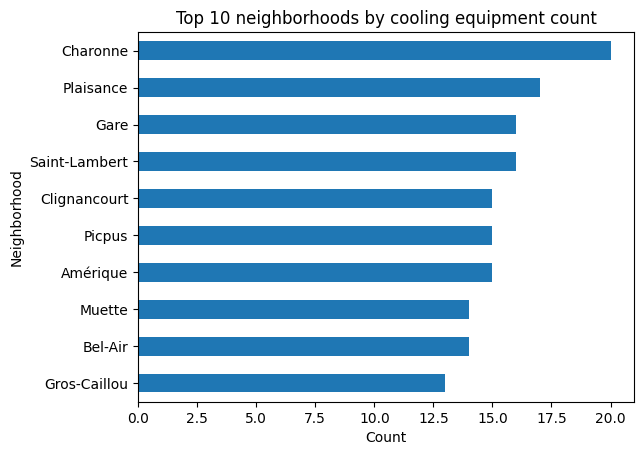

In [329]:
display(HTML("<h3>Cooling equipment — Top neighborhoods</h3>"))

top = (gdf_cooling_equipment_with_nhd["jointure_nhd_name"]
       .value_counts()
       .head(10)
       .sort_values())

plt.figure()
top.plot(kind="barh")
plt.title("Top 10 neighborhoods by cooling equipment count")
plt.xlabel("Count")
plt.ylabel("Neighborhood")
plt.show()


Top 10 neighborhoods by cooling equipment count. This bar chart highlights the neighborhoods with the highest number of recorded cooling equipment assets. The ranking suggests that cooling infrastructure is not evenly distributed across Paris: a limited set of neighborhoods concentrate the largest counts, while many others likely have fewer assets. This uneven distribution can be further interpreted using densities (per km²) and compared with heat exposure indicators and other cooling-related features (trees, green areas, fountains).

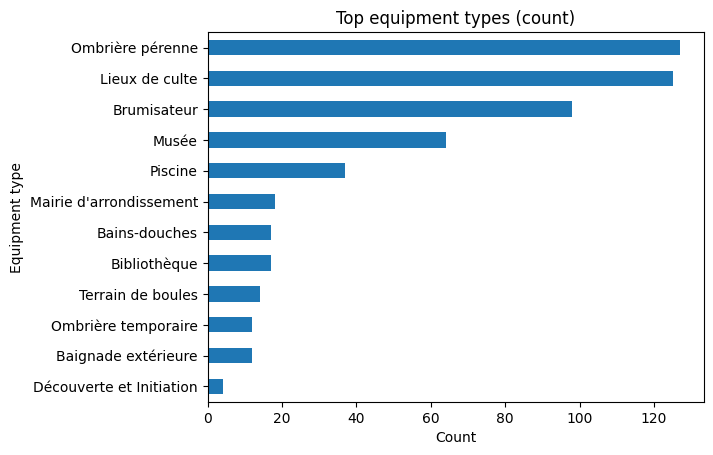

In [330]:
display(HTML("<h3>Cooling equipment — Breakdown by equipment type</h3>"))

t = (gdf_cooling_equipment_with_nhd["equipment_type"]
     .value_counts()
     .head(15)
     .sort_values())

plt.figure()
t.plot(kind="barh")
plt.title("Top equipment types (count)")
plt.xlabel("Count")
plt.ylabel("Equipment type")
plt.show()


Top equipment types (count). This chart shows the most frequent categories of cooling equipment in the dataset. The distribution is clearly dominated by a few types (e.g., permanent shading structures and other major categories), while many equipment types appear less frequently. This indicates that the cooling infrastructure recorded here is not only uneven spatially, but also concentrated in a limited set of intervention types, which may influence how effective these assets are for mitigating heat exposure in different neighborhoods.

2) Cooling locations — gdf_cooling_location_with_nhd

In [331]:
display(HTML("<h3>Cooling locations — Map</h3>"))

m = folium.Map(location=[48.8566, 2.3522], zoom_start=12, tiles="cartodbpositron")
mc = MarkerCluster().add_to(m)

tmp = gdf_cooling_location_with_nhd.dropna(subset=["cooling_location_latitude","cooling_location_longitude"]).copy()

for _, r in tmp.head(5000).iterrows():
    folium.CircleMarker(
        location=[r["cooling_location_latitude"], r["cooling_location_longitude"]],
        radius=3,
        popup=f"{r['jointure_nhd_name']} | {r['cooling_location_type']}",
        fill=True
    ).add_to(mc)

m


Cooling locations — Map. This map shows the geographic distribution of cooling locations across Paris. The clustering pattern suggests that cooling points are not uniformly spread: some areas concentrate many locations, while others appear less covered. This spatial heterogeneity is relevant for assessing access to cooling resources during hot periods.

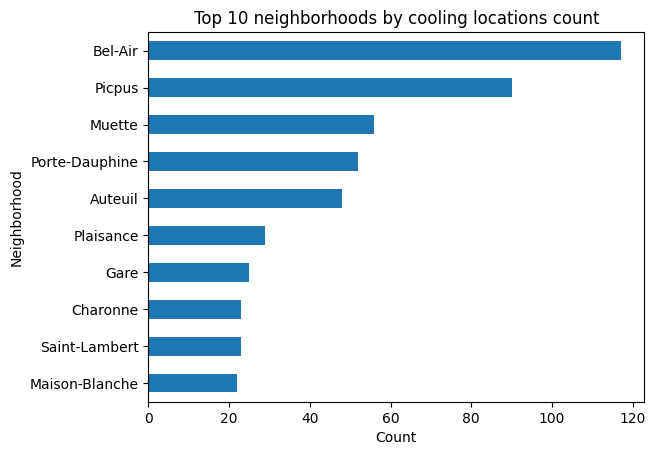

In [332]:
display(HTML("<h3>Cooling locations — Top neighborhoods</h3>"))

top = (gdf_cooling_location_with_nhd["jointure_nhd_name"]
       .value_counts()
       .head(10)
       .sort_values())

plt.figure()
top.plot(kind="barh")
plt.title("Top 10 neighborhoods by cooling locations count")
plt.xlabel("Count")
plt.ylabel("Neighborhood")
plt.show()


Top 10 neighborhoods by cooling locations count. The plot identifies neighborhoods with the highest concentration of cooling locations. The differences across neighborhoods highlight spatial disparities that can be further analyzed using densities (per km²) and compared with neighborhood heat exposure and population/land-use proxies.

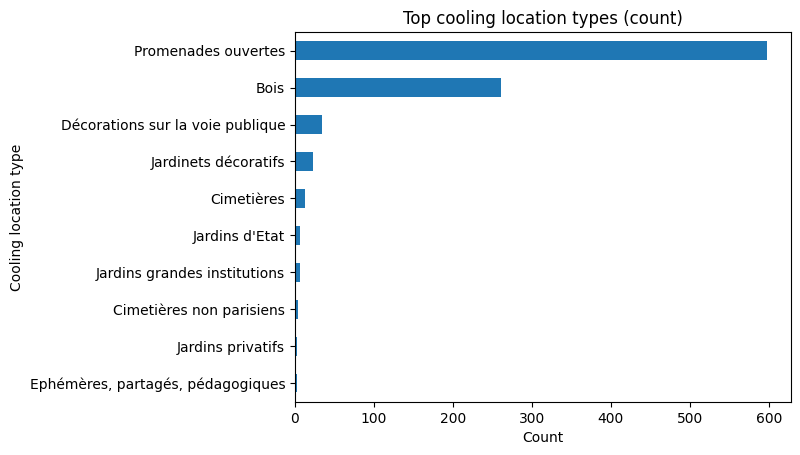

In [333]:
display(HTML("<h3>Cooling locations — Breakdown by type</h3>"))

t = (gdf_cooling_location_with_nhd["cooling_location_type"]
     .value_counts()
     .head(15)
     .sort_values())

plt.figure()
t.plot(kind="barh")
plt.title("Top cooling location types (count)")
plt.xlabel("Count")
plt.ylabel("Cooling location type")
plt.show()


Cooling locations — Breakdown by type. The most frequent cooling location categories reveal which types of cooling points dominate the dataset. This breakdown helps interpret whether cooling strategies are diversified or driven by a small set of location types, which can impact resilience during heatwaves.

3) Trees — gdf_tree_location_with_nhd

In [334]:
display(HTML("<h3>Trees — Map</h3>"))

m = folium.Map(location=[48.8566, 2.3522], zoom_start=12, tiles="cartodbpositron")
mc = MarkerCluster().add_to(m)

tmp = gdf_tree_location_with_nhd.dropna(subset=["tree_location_nhd_latitude","tree_location_nhd_longitude"]).copy()

for _, r in tmp.head(8000).iterrows():
    folium.CircleMarker(
        location=[r["tree_location_nhd_latitude"], r["tree_location_nhd_longitude"]],
        radius=2,
        popup=f"{r['jointure_nhd_name']} | {r['tree_location_species']} | h={r['tree_location_height_m']}",
        fill=True
    ).add_to(mc)

m


Trees — Map. The map visualizes the spatial distribution of recorded trees across neighborhoods. Areas with higher tree concentration may provide greater shading and evapotranspiration potential, which are important cooling mechanisms. Spatial differences can be compared with temperature indicators and green-space availability.

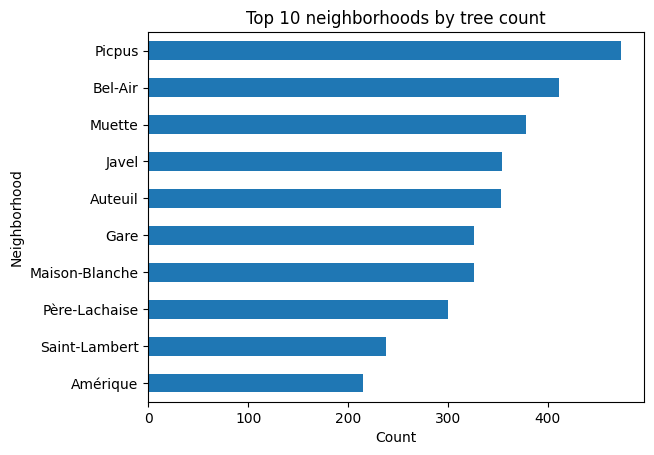

In [335]:
display(HTML("<h3>Trees — Top neighborhoods</h3>"))

top = (gdf_tree_location_with_nhd["jointure_nhd_name"]
       .value_counts()
       .head(10)
       .sort_values())

plt.figure()
top.plot(kind="barh")
plt.title("Top 10 neighborhoods by tree count")
plt.xlabel("Count")
plt.ylabel("Neighborhood")
plt.show()


Top 10 neighborhoods by tree count. This chart highlights neighborhoods with the largest number of trees in the dataset. Strong differences across neighborhoods suggest unequal distribution of potential shade resources, motivating normalization by area (trees per km²) for fair comparisons.

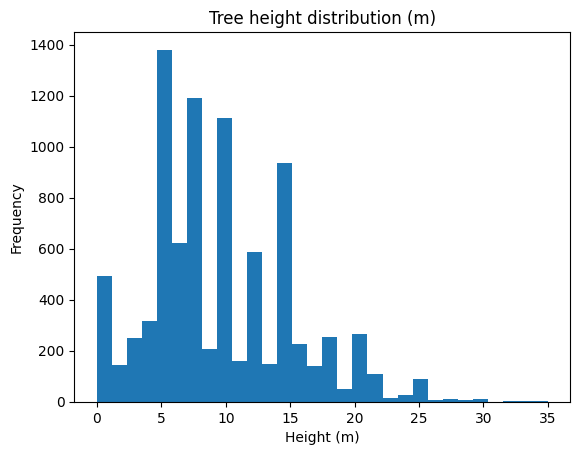

In [336]:
display(HTML("<h3>Trees — Tree height distribution</h3>"))

h = gdf_tree_location_with_nhd["tree_location_height_m"].dropna()

plt.figure()
plt.hist(h, bins=30)
plt.title("Tree height distribution (m)")
plt.xlabel("Height (m)")
plt.ylabel("Frequency")
plt.show()


Tree height distribution. The histogram summarizes the variability of tree heights. Most observations concentrate in lower-to-medium heights, while a smaller share of taller trees may contribute disproportionately to shading benefits. Height distributions can also be compared across neighborhoods to assess differences in canopy structure.

4) Green locations — gdf_green_location_with_nhd

In [337]:
display(HTML("<h3>Green locations — Map</h3>"))

m = folium.Map(location=[48.8566, 2.3522], zoom_start=12, tiles="cartodbpositron")
mc = MarkerCluster().add_to(m)

tmp = gdf_green_location_with_nhd.dropna(subset=["green_location_latitude","green_location_longitude"]).copy()

for _, r in tmp.head(5000).iterrows():
    folium.CircleMarker(
        location=[r["green_location_latitude"], r["green_location_longitude"]],
        radius=3,
        popup=f"{r['jointure_nhd_name']} | {r['green_location_type']} | {r['green_location_category']}",
        fill=True
    ).add_to(mc)

m


Green locations — Map. This map shows where green locations are recorded across Paris. Spatial clusters indicate neighborhoods with greater availability of green infrastructure, which can contribute to cooling through shading and evapotranspiration. These patterns can be contrasted with heat indicators to identify potential mismatches.

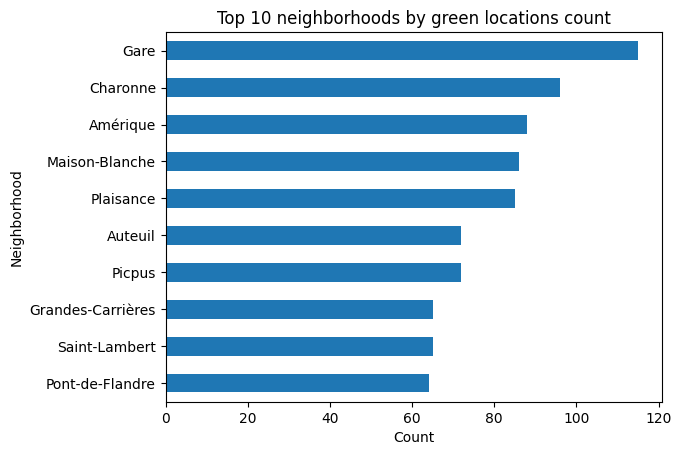

In [338]:
display(HTML("<h3>Green locations — Top neighborhoods</h3>"))

top = (gdf_green_location_with_nhd["jointure_nhd_name"]
       .value_counts()
       .head(10)
       .sort_values())

plt.figure()
top.plot(kind="barh")
plt.title("Top 10 neighborhoods by green locations count")
plt.xlabel("Count")
plt.ylabel("Neighborhood")
plt.show()


Top 10 neighborhoods by green locations count. The ranking suggests that some neighborhoods contain a higher number of green locations than others. Since counts do not reflect size, complementary metrics such as total green area or density per km² provide more comparable indicators across neighborhoods.

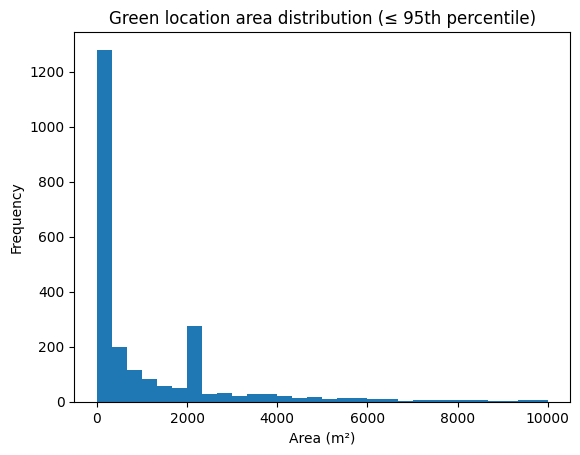

In [339]:
a = gdf_green_location_with_nhd["green_location_area_m2"].dropna()
p95 = a.quantile(0.95)

plt.figure()
plt.hist(a[a <= p95], bins=30)
plt.title("Green location area distribution (≤ 95th percentile)")
plt.xlabel("Area (m²)")
plt.ylabel("Frequency")
plt.show()


Green location area distribution (≤95th percentile / log scale). Restricting the scale (or using a log transform) reveals the structure of the main mass of observations and avoids compression caused by a few very large green areas.

5) Weather — gdf_weather_with_nhd

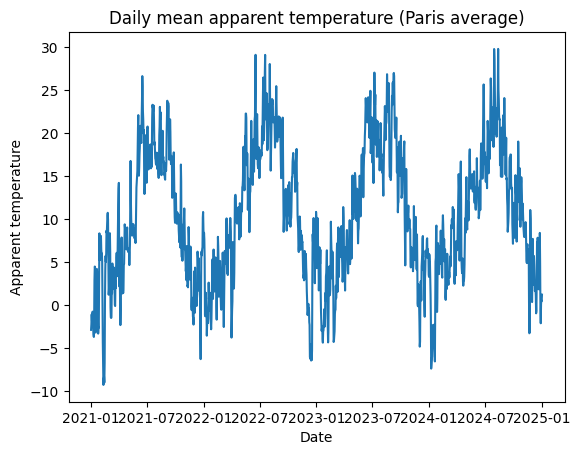

In [340]:
display(HTML("<h3>Weather — Time series</h3>"))

dfw = gdf_weather_with_nhd.copy()
dfw["weather_location_start_date"] = pd.to_datetime(dfw["weather_location_start_date"])

daily = (dfw.groupby("weather_location_start_date")["weather_apparent_temperature"]
         .mean()
         .reset_index())

plt.figure()
plt.plot(daily["weather_location_start_date"], daily["weather_apparent_temperature"])
plt.title("Daily mean apparent temperature (Paris average)")
plt.xlabel("Date")
plt.ylabel("Apparent temperature")
plt.show()


Daily mean apparent temperature (Paris average). The time series shows a clear seasonal pattern with recurrent summer peaks and winter lows. Short-term variability reflects day-to-day weather changes and episodic heat events. For analyses focused on summer heat (May–September), the series should be filtered to the project’s seasonal scope

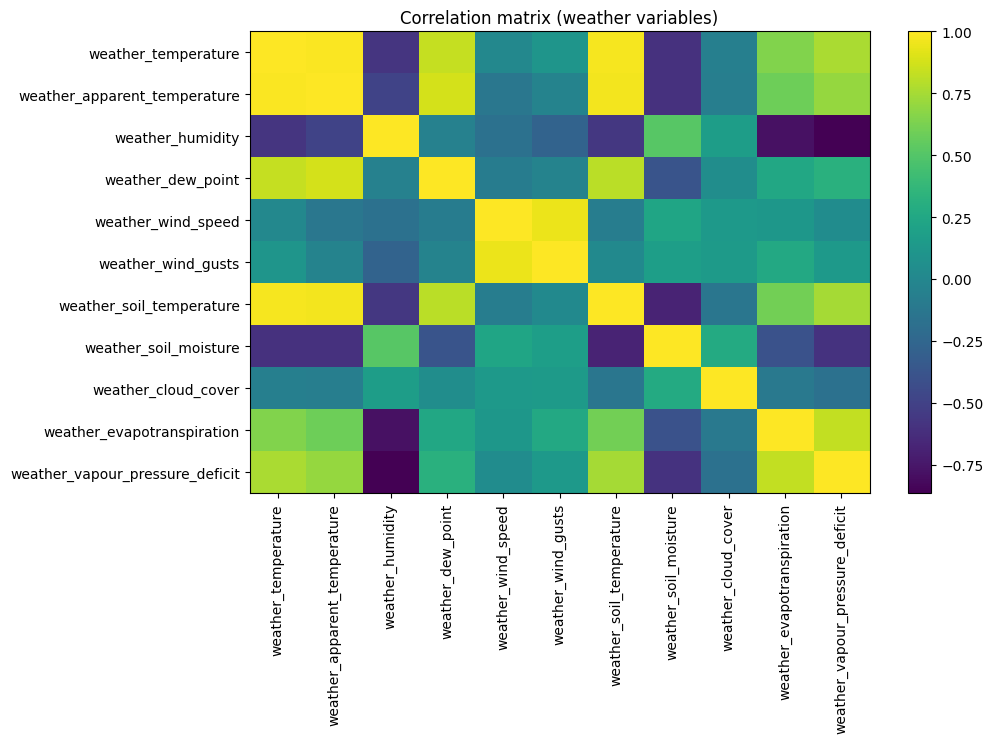

In [341]:
display(HTML("<h3>Weather — Correlation matrix (core variables)</h3>"))

core = [
    "weather_temperature","weather_apparent_temperature",
    "weather_humidity","weather_dew_point",
    "weather_wind_speed","weather_wind_gusts",
    "weather_soil_temperature","weather_soil_moisture",
    "weather_cloud_cover","weather_evapotranspiration",
    "weather_vapour_pressure_deficit"
]
core = [c for c in core if c in dfw.columns]

corr = dfw[core].corr(numeric_only=True)

plt.figure(figsize=(10,6))
plt.imshow(corr, aspect="auto")
plt.xticks(range(len(core)), core, rotation=90)
plt.yticks(range(len(core)), core)
plt.title("Correlation matrix (weather variables)")
plt.colorbar()
plt.show()


Correlation matrix (weather variables). The heatmap reveals strong multicollinearity among temperature-related variables (air, apparent, and soil temperature). Humidity is strongly negatively correlated with vapour pressure deficit (VPD), while evapotranspiration is strongly positively correlated with VPD, reflecting the physics of atmospheric moisture demand. Wind speed and gusts are strongly correlated with each other but show weaker links to the main heat-related block.

C:\Users\aspir\AppData\Local\Temp\ipykernel_29052\675055956.py:7: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(data, labels=sorted(dfw["year"].unique()))


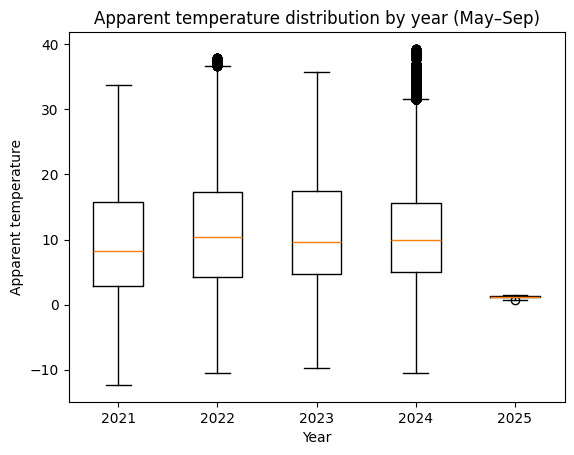

In [342]:
display(HTML("<h3>Weather — Apparent temperature by year</h3>"))

dfw["year"] = dfw["weather_location_start_date"].dt.year
data = [dfw.loc[dfw["year"]==y, "weather_apparent_temperature"].dropna() for y in sorted(dfw["year"].unique())]

plt.figure()
plt.boxplot(data, labels=sorted(dfw["year"].unique()))
plt.title("Apparent temperature distribution by year (May–Sep)")
plt.xlabel("Year")
plt.ylabel("Apparent temperature")
plt.show()


Apparent temperature distribution by year. This boxplot compares the distribution of apparent temperature across years. Median values are relatively similar for 2021–2024, while the upper tails highlight inter-annual differences in extreme heat intensity (with some years showing more high-end extremes). The 2025 distribution appears unusually low and very narrow, which likely indicates incomplete or out-of-scope data for that year; it should be verified or excluded from the comparison.

6) Public installation / Heat sources summary — gdf_public_installation_with_nhd

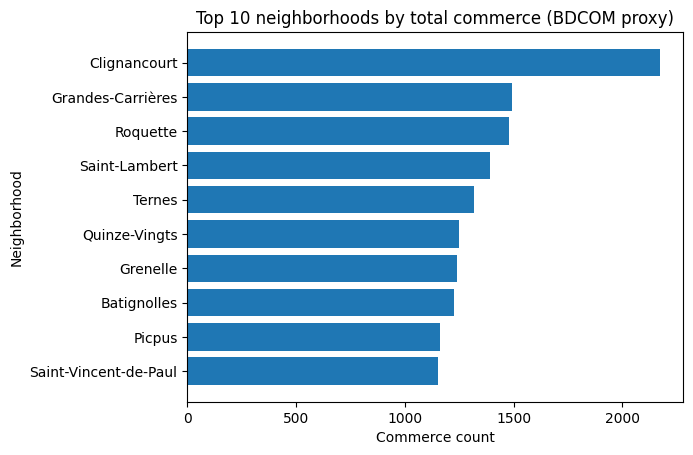

In [343]:
display(HTML("<h3>Public installations — Top neighborhoods by total commerce</h3>"))

dfp = gdf_public_installation_with_nhd.copy()

top = (dfp[["jointure_nhd_name","pub_inst_commerce_total"]]
       .sort_values("pub_inst_commerce_total", ascending=False)
       .head(10)
       .sort_values("pub_inst_commerce_total"))

plt.figure()
plt.barh(top["jointure_nhd_name"], top["pub_inst_commerce_total"])
plt.title("Top 10 neighborhoods by total commerce (BDCOM proxy)")
plt.xlabel("Commerce count")
plt.ylabel("Neighborhood")
plt.show()


Top 10 neighborhoods by total commerce. This plot identifies neighborhoods with the highest concentration of commercial activity. Higher commerce density may be associated with increased anthropogenic heat (cooling exhaust, lighting, indoor activity) and can be used as a proxy for potential heat-intensifying urban functions.

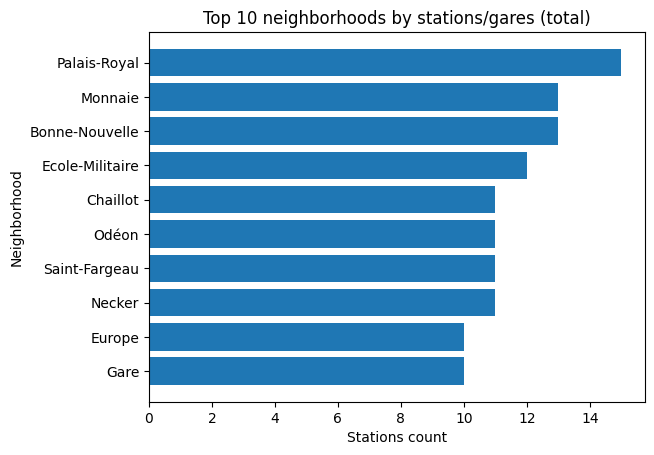

In [344]:
display(HTML("<h3>Public installations — Top neighborhoods by transport stations</h3>"))

top = (dfp[["jointure_nhd_name","pub_inst_gares_total"]]
       .sort_values("pub_inst_gares_total", ascending=False)
       .head(10)
       .sort_values("pub_inst_gares_total"))

plt.figure()
plt.barh(top["jointure_nhd_name"], top["pub_inst_gares_total"])
plt.title("Top 10 neighborhoods by stations/gares (total)")
plt.xlabel("Stations count")
plt.ylabel("Neighborhood")
plt.show()


Top 10 neighborhoods by transport stations. Neighborhoods with more stations often concentrate mobility flows and built infrastructure. Such areas may experience increased heat due to traffic intensity, dense impervious surfaces, and high human activity, making this a relevant proxy variable for urban heat-related analyses.

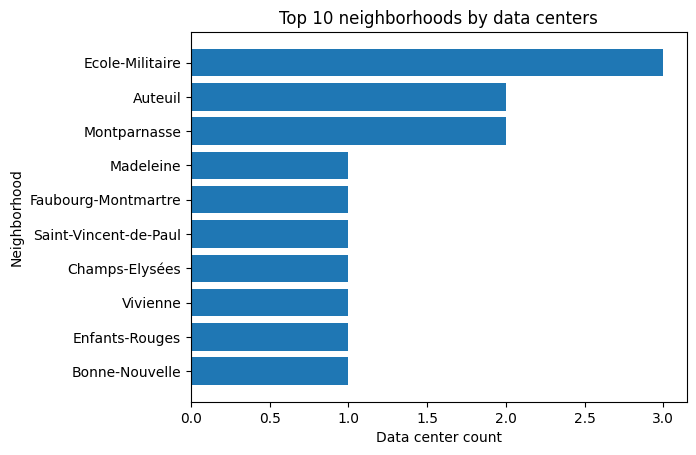

In [345]:
display(HTML("<h3>Public installations — Top neighborhoods by data centers</h3>"))

top = (dfp[["jointure_nhd_name","pub_inst_data_center"]]
       .sort_values("pub_inst_data_center", ascending=False)
       .head(10)
       .sort_values("pub_inst_data_center"))

plt.figure()
plt.barh(top["jointure_nhd_name"], top["pub_inst_data_center"])
plt.title("Top 10 neighborhoods by data centers")
plt.xlabel("Data center count")
plt.ylabel("Neighborhood")
plt.show()


Top 10 neighborhoods by data centers. Data centers are a continuous source of waste heat due to cooling and IT loads. The ranking highlights where these installations are concentrated and provides a defensible proxy for localized anthropogenic heat sources at neighborhood scale.

7) Drinking fountains — gdf_drinking_fontain_with_nhd

In [346]:
display(HTML("<h3>Drinking fountains — Map</h3>"))

m = folium.Map(location=[48.8566, 2.3522], zoom_start=12, tiles="cartodbpositron")
mc = MarkerCluster().add_to(m)

tmp = gdf_drinking_fontain_with_nhd.dropna(subset=["drinking_fontain_latitude","drinking_fontain_longitude"]).copy()

for _, r in tmp.head(8000).iterrows():
    folium.CircleMarker(
        location=[r["drinking_fontain_latitude"], r["drinking_fontain_longitude"]],
        radius=3,
        popup=f"{r['jointure_nhd_name']} | {r['drinking_fontain_object_type']} | {r['drinking_fontain_model']}",
        fill=True
    ).add_to(mc)

m


Drinking fountains — Map. The map displays the spatial distribution of drinking fountains across Paris. Clusters indicate areas with greater access to public water points, which can be an important resource during hot weather. Spatial disparities can be assessed against neighborhood heat exposure and population activity proxies.

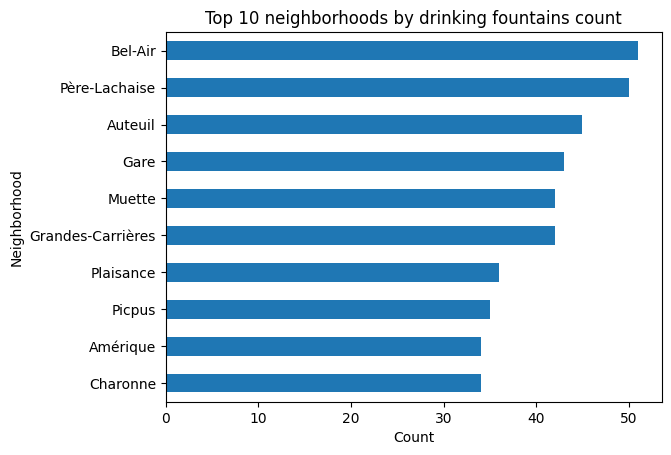

In [347]:
display(HTML("<h3>Drinking fountains — Top neighborhoods</h3>"))

top = (gdf_drinking_fontain_with_nhd["jointure_nhd_name"]
       .value_counts()
       .head(10)
       .sort_values())

plt.figure()
top.plot(kind="barh")
plt.title("Top 10 neighborhoods by drinking fountains count")
plt.xlabel("Count")
plt.ylabel("Neighborhood")
plt.show()


Top 10 neighborhoods by drinking fountains count. The chart highlights neighborhoods with the highest number of fountains. Differences across neighborhoods suggest potential inequalities in access to hydration points, motivating density-based comparisons (per km²) and cross-analysis with cooling/green infrastructure.

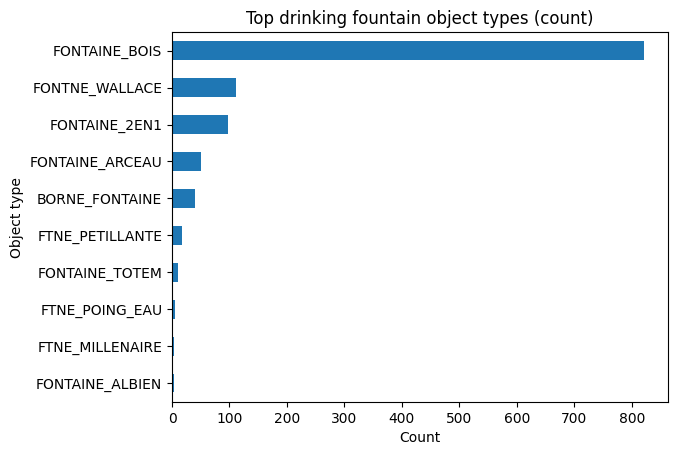

In [348]:
display(HTML("<h3>Drinking fountains — Breakdown by object type</h3>"))

t = (gdf_drinking_fontain_with_nhd["drinking_fontain_object_type"]
     .value_counts()
     .head(15)
     .sort_values())

plt.figure()
t.plot(kind="barh")
plt.title("Top drinking fountain object types (count)")
plt.xlabel("Count")
plt.ylabel("Object type")
plt.show()


Breakdown by fountain type/model. The distribution of fountain types/models indicates which categories are most common in the dataset. This helps characterize the nature of available infrastructure and whether specific fountain types dominate the city’s public hydration network.